In [2]:
#Loading dataset
import pandas as pd
import sys
sys.path.append(r"C:\Users\Ericd\OneDrive\Desktop\wudimoxing")
from wudi_regression import Regression
from wudi_classification import Classification
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
import numpy as np
from pickle import dump, load
import optuna
from colorama import Fore
from IPython.display import display

df = pd.read_excel('QAQ.xlsx')
df.to_csv('Wastewater treatment plant.csv', index=False)

``multivariate`` option is an experimental feature. The interface can change in the future.


In [3]:
file1_path = "Wastewater treatment plant.csv"
file2_path = "data_features_Class.csv"


df1 = pd.read_csv(file1_path)
df2 = pd.read_csv(file2_path)
# Concatenate the DataFrames horizontally (along columns)
combination = pd.concat([df1, df2], axis=1)

# Replace 'combination.csv' with the desired name for the combined CSV file
combination.to_csv('SBDJWCLASS.csv', index=False)
df = pd.read_csv('SBDJWCLASS.csv')

In [4]:
rows_to_drop = list(range(1188, 1190))  # Since Python is 0-indexed, we drop rows 1188, 1189, and 1190
df = df.drop(index=rows_to_drop)


In [5]:
new_column_name = 'Aeration tank(HRT)'
df.rename(columns={'Aeration tank': new_column_name}, inplace=True)

new_column_name = 'Plant(HRT)'
df.rename(columns={'Plant': new_column_name}, inplace=True)

new_column_name = 'Annual average temperature (oC)'
df.rename(columns={'Annual average': new_column_name}, inplace=True)

new_column_name = 'Annual mean of daily maximum temperature (oC) '
df.rename(columns={'Annual mean of daily maximum': new_column_name}, inplace=True)

new_column_name = 'Annual mean of daily minimum temperature (oC) '
df.rename(columns={'Annual mean of daily minimum': new_column_name}, inplace=True)

new_column_name = 'Sampling month average temperature (oC)'
df.rename(columns={'Sampling month average': new_column_name}, inplace=True)

new_column_name = 'Annual mean of daily minimum temperature (oC) '
df.rename(columns={'Annual mean of daily minimum': new_column_name}, inplace=True)

new_column_name = 'Annual Precipitation(mm)'
df.rename(columns={'Annual': new_column_name}, inplace=True)

new_column_name = 'Sampling month Precipitation(mm)'
df.rename(columns={'Sampling month': new_column_name}, inplace=True)

new_column_name = 'Annual Precipitation(mm)'
df.rename(columns={'Annual': new_column_name}, inplace=True)

new_column_name = 'General AS process type'
df.rename(columns={'General type ': new_column_name}, inplace=True)

new_column_name = 'Detailed AS process type'
df.rename(columns={'Detailed type': new_column_name}, inplace=True)

new_column_name = 'Percentage of Industry wastewater source'
df.rename(columns={'Percentage': new_column_name}, inplace=True)

new_column_name = 'Contained in Inf? (Industry wastewater source)'
df.rename(columns={'Contained in Inf?': new_column_name}, inplace=True)



In [6]:
missing_percentage = df.isnull().sum() / len(df) * 100
missing_percentage

Sample ID          0.168350
WWTP ID            0.084175
SiteID             0.168350
Site Name          0.168350
Sampling Date      6.228956
                     ...   
metagenome         0.168350
Kapabacteria       0.168350
Lineage IIb        0.168350
Desulfobacteria    0.168350
Hydrogenedentia    0.168350
Length: 119, dtype: float64

In [7]:
columns_to_delete = df.columns[60:68]  # 注意 Python 中索引从 0 开始，因此第 62 列的索引是 61
df.drop(columns=columns_to_delete, inplace=True)

In [8]:
df.columns

Index(['Sample ID', 'WWTP ID', 'SiteID', 'Site Name', 'Sampling Date',
       'Latitude', 'Longitude', 'City Name', 'Country/Region', 'Continent',
       ...
       'Vampirivibrionia', 'Desulfovibrionia', 'Negativicutes', 'Holophagae',
       'Leptospirae', 'metagenome', 'Kapabacteria', 'Lineage IIb',
       'Desulfobacteria', 'Hydrogenedentia'],
      dtype='object', length=111)

In [9]:
columns_to_drop = ['Sample ID', 'WWTP ID', 'SiteID', 'Site Name', 'Sampling Date',
       'Latitude', 'Longitude', 'City Name', 'Country/Region', 'Continent',
       'Climate typea', 'Annual average temperature (oC)',
       'Annual mean of daily maximum temperature (oC) ',
       'Annual mean of daily minimum temperature (oC) ',
       'Sampling month average temperature (oC)', 'Sampling moment',
       'Annual Precipitation(mm)', 'Sampling month Precipitation(mm)',
       'GDP per capita (dollars)', 'City population', 'Year of plant build',
       'Nitrification', 'Denitrification','Aerator type', 'BOD (mg/l) inf/(1+recycle ratio)', 'BOD (mg/l) Aeration tank inf',
       'BOD (mg/l) Eff','COD (mg/l) Inf/(1+recycle ratio)',
       'COD (mg/l) Aeration tank inf', 'COD (mg/l) Eff','F/M (kg BOD/kg MLSS-d)', 'NH4-N (mg/l) Aeration tank inf', 'NH4-N (mg/l) Eff',
        'TN (mg/l) Aeration tank inf', 'TN (mg/l) Eff','TP (mg/l) Aeration tank inf', 'TP (mg/l) Eff', 'Contained in Inf? (Industry wastewater source)',
       'Percentage of Industry wastewater source','Conductivity (μS/cm)','NH4-N (mg/l)', 'NO3-N (mg/l)', 'SVI (ml/g)'        
        ]

df = df.drop(columns=columns_to_drop)

In [10]:
missing_percentage = df.isnull().sum() / len(df) * 100

In [11]:
missing_percentage

Designed capacity (m3/d)         18.181818
Actual Inf rate (m3/d)           18.350168
Volume of aeration tanks (m3)    28.451178
Plant(HRT)                       46.969697
Aeration tank(HRT)               46.632997
                                   ...    
metagenome                        0.168350
Kapabacteria                      0.168350
Lineage IIb                       0.168350
Desulfobacteria                   0.168350
Hydrogenedentia                   0.168350
Length: 68, dtype: float64

In [12]:
df.columns

Index(['Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)', 'General AS process type', 'Detailed AS process type',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'K

In [13]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=5)  # 这里的 n_neighbors 可以根据你的需求进行调整

In [14]:
columns_to_extract = [ 'Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'Kiritimatiellae', 'Ignavibacteria', 'Desulfuromonadia',
       'Campylobacteria', 'Gemmatimonadetes', 'Vicinamibacteria',
       'Fimbriimonadia', 'Vampirivibrionia', 'Desulfovibrionia',
       'Negativicutes', 'Holophagae', 'Leptospirae', 'metagenome',
       'Kapabacteria', 'Lineage IIb', 'Desulfobacteria', 'Hydrogenedentia']

In [15]:
df_1 = df[columns_to_extract]

In [16]:
df_filled = pd.DataFrame(imputer.fit_transform(df_1), columns=df_1.columns)

In [17]:
df_filled

,Designed capacity (m3/d),Actual Inf rate (m3/d),Volume of aeration tanks (m3),Plant(HRT),Aeration tank(HRT),SRT (d),BOD (mg/l) Inf,COD (mg/l) Inf,NH4-N (mg/l) Inf,TN (mg/l) Inf,...,Vampirivibrionia,Desulfovibrionia,Negativicutes,Holophagae,Leptospirae,metagenome,Kapabacteria,Lineage IIb,Desulfobacteria,Hydrogenedentia
0,17500.000000,31449.600000,5748.000000,44.400000,13.500000,12.000000,142.000000,771.970000,61.400000,35.900000,...,0.054688,0.082031,0.027344,0.058594,0.144531,0.757812,0.058594,0.257812,0.003906,0.101562
1,17500.000000,31449.600000,5748.000000,44.400000,13.500000,12.000000,142.000000,771.970000,61.400000,35.900000,...,0.035156,0.101562,0.023438,0.105469,0.160156,0.941406,0.066406,0.214844,0.003906,0.085938
2,17500.000000,31449.600000,5748.000000,44.400000,13.500000,12.000000,142.000000,771.970000,61.400000,35.900000,...,0.035156,0.054688,0.046875,0.054688,0.167969,0.917969,0.042969,0.246094,0.000000,0.101562
3,17500.000000,31449.600000,5748.000000,44.400000,13.500000,12.000000,142.000000,771.970000,61.400000,35.900000,...,0.042969,0.062500,0.066406,0.078125,0.171875,0.812500,0.078125,0.222656,0.015625,0.101562
4,17500.000000,31449.600000,5748.000000,44.400000,13.500000,12.000000,142.000000,771.970000,61.400000,35.900000,...,0.039062,0.054688,0.035156,0.058594,0.226562,0.902344,0.070312,0.265625,0.000000,0.121094
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1183,35197.458984,4393.000000,5400.000000,18.908000,24.000000,15.000000,168.800000,760.000000,25.800000,51.540000,...,0.019531,0.031250,0.054688,0.105469,0.347656,0.046875,0.230469,0.050781,0.003906,0.156250
1184,35197.458984,4393.000000,5400.000000,18.908000,24.000000,15.000000,168.800000,760.000000,25.400000,59.360000,...,0.019531,0.054688,0.070312,0.089844,0.316406,0.031250,0.226562,0.031250,0.011719,0.113281
1185,35197.458984,4393.000000,5400.000000,18.908000,24.000000,15.000000,168.800000,760.000000,25.800000,51.540000,...,0.031250,0.066406,0.039062,0.113281,0.433594,0.039062,0.292969,0.007812,0.007812,0.105469
1186,185895.738513,146367.358907,42075.706038,19.284951,9.836262,14.957447,212.190636,460.551067,26.235939,41.871795,...,0.176397,0.081205,0.069259,0.403368,0.420314,0.152732,0.334627,0.060346,0.032238,0.083112


In [18]:
df.drop(columns = columns_to_extract)

,General AS process type,Detailed AS process type
0,A2O,UCT
1,A2O,UCT
2,A2O,UCT
3,A2O,UCT
4,A2O,UCT
...,...,...
1183,plug flow,Plug flow
1184,plug flow,Plug flow
1185,plug flow,Plug flow
1186,NaN,NaN


In [19]:
df_filled.columns

Index(['Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)', 'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf',
       'TN (mg/l) Inf', 'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'Kiritimatiellae', 'Ignavibacteria', 'Desulfuromonadia',
       

In [20]:
df[[ 'Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'Kiritimatiellae', 'Ignavibacteria', 'Desulfuromonadia',
       'Campylobacteria', 'Gemmatimonadetes', 'Vicinamibacteria',
       'Fimbriimonadia', 'Vampirivibrionia', 'Desulfovibrionia',
       'Negativicutes', 'Holophagae', 'Leptospirae', 'metagenome',
       'Kapabacteria', 'Lineage IIb', 'Desulfobacteria', 'Hydrogenedentia']] = df_filled[[ 'Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'Kiritimatiellae', 'Ignavibacteria', 'Desulfuromonadia',
       'Campylobacteria', 'Gemmatimonadetes', 'Vicinamibacteria',
       'Fimbriimonadia', 'Vampirivibrionia', 'Desulfovibrionia',
       'Negativicutes', 'Holophagae', 'Leptospirae', 'metagenome',
       'Kapabacteria', 'Lineage IIb', 'Desulfobacteria', 'Hydrogenedentia']]

In [21]:
'''
#df['BOD(difference)'] = df['BOD (mg/l) Inf']- df['BOD (mg/l) Eff'] #regressor1
#df['COD(difference)'] = df['COD (mg/l) Inf']- df['COD (mg/l) Eff'] #regressor2
#df['NH4-N(difference)'] = df['NH4-N (mg/l) Inf']- df['NH4-N (mg/l) Eff'] #regressor3
#df['TN(difference)'] = df['TN (mg/l) Inf']- df['TN (mg/l) Eff'] #regressor4
#df['TP(difference)'] = df['TP (mg/l) Inf']- df['TP (mg/l) Eff'] #regressor5

df['BOD(Percentage)'] = (df['BOD (mg/l) Inf']- df['BOD (mg/l) Eff'])/df['BOD (mg/l) Inf'] #regressor6
df['COD(Percentage)'] = (df['COD (mg/l) Inf']- df['COD (mg/l) Eff'])/df['COD (mg/l) Inf'] #regressor7
df['NH4-N(Percentage)'] = (df['NH4-N (mg/l) Inf']- df['NH4-N (mg/l) Eff'])/df['NH4-N (mg/l) Inf'] #regressor8
df['TN(Percentage)'] = (df['TN (mg/l) Inf']- df['TN (mg/l) Eff'])/df['TN (mg/l) Inf'] #regressor9
df['TP(Percentage)'] = (df['TP (mg/l) Inf']- df['TP (mg/l) Eff'])/df['TP (mg/l) Inf'] #regressor10
'''

"\n#df['BOD(difference)'] = df['BOD (mg/l) Inf']- df['BOD (mg/l) Eff'] #regressor1\n#df['COD(difference)'] = df['COD (mg/l) Inf']- df['COD (mg/l) Eff'] #regressor2\n#df['NH4-N(difference)'] = df['NH4-N (mg/l) Inf']- df['NH4-N (mg/l) Eff'] #regressor3\n#df['TN(difference)'] = df['TN (mg/l) Inf']- df['TN (mg/l) Eff'] #regressor4\n#df['TP(difference)'] = df['TP (mg/l) Inf']- df['TP (mg/l) Eff'] #regressor5\n\ndf['BOD(Percentage)'] = (df['BOD (mg/l) Inf']- df['BOD (mg/l) Eff'])/df['BOD (mg/l) Inf'] #regressor6\ndf['COD(Percentage)'] = (df['COD (mg/l) Inf']- df['COD (mg/l) Eff'])/df['COD (mg/l) Inf'] #regressor7\ndf['NH4-N(Percentage)'] = (df['NH4-N (mg/l) Inf']- df['NH4-N (mg/l) Eff'])/df['NH4-N (mg/l) Inf'] #regressor8\ndf['TN(Percentage)'] = (df['TN (mg/l) Inf']- df['TN (mg/l) Eff'])/df['TN (mg/l) Inf'] #regressor9\ndf['TP(Percentage)'] = (df['TP (mg/l) Inf']- df['TP (mg/l) Eff'])/df['TP (mg/l) Inf'] #regressor10\n"

In [22]:
df.columns

Index(['Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)', 'General AS process type', 'Detailed AS process type',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'K

In [23]:
df.iloc

In [24]:
df.isnull().sum()

Designed capacity (m3/d)         0
Actual Inf rate (m3/d)           0
Volume of aeration tanks (m3)    0
Plant(HRT)                       0
Aeration tank(HRT)               0
                                ..
metagenome                       0
Kapabacteria                     0
Lineage IIb                      0
Desulfobacteria                  0
Hydrogenedentia                  0
Length: 68, dtype: int64

In [25]:
df.dropna(inplace=True)

In [26]:
df

,Designed capacity (m3/d),Actual Inf rate (m3/d),Volume of aeration tanks (m3),Plant(HRT),Aeration tank(HRT),SRT (d),General AS process type,Detailed AS process type,BOD (mg/l) Inf,COD (mg/l) Inf,...,Vampirivibrionia,Desulfovibrionia,Negativicutes,Holophagae,Leptospirae,metagenome,Kapabacteria,Lineage IIb,Desulfobacteria,Hydrogenedentia
0,17500.000000,31449.6,5748.0,44.400,13.5,12.0,A2O,UCT,142.0,771.97,...,0.054688,0.082031,0.027344,0.058594,0.144531,0.757812,0.058594,0.257812,0.003906,0.101562
1,17500.000000,31449.6,5748.0,44.400,13.5,12.0,A2O,UCT,142.0,771.97,...,0.035156,0.101562,0.023438,0.105469,0.160156,0.941406,0.066406,0.214844,0.003906,0.085938
2,17500.000000,31449.6,5748.0,44.400,13.5,12.0,A2O,UCT,142.0,771.97,...,0.035156,0.054688,0.046875,0.054688,0.167969,0.917969,0.042969,0.246094,0.000000,0.101562
3,17500.000000,31449.6,5748.0,44.400,13.5,12.0,A2O,UCT,142.0,771.97,...,0.042969,0.062500,0.066406,0.078125,0.171875,0.812500,0.078125,0.222656,0.015625,0.101562
4,17500.000000,31449.6,5748.0,44.400,13.5,12.0,A2O,UCT,142.0,771.97,...,0.039062,0.054688,0.035156,0.058594,0.226562,0.902344,0.070312,0.265625,0.000000,0.121094
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181,30648.094238,4393.0,5400.0,18.908,24.0,15.0,plug flow,Plug flow,226.6,760.00,...,0.007812,0.042969,0.066406,0.078125,0.402344,0.039062,0.253906,0.019531,0.023438,0.136719
1182,62698.729492,4393.0,5400.0,18.908,24.0,15.0,plug flow,Plug flow,226.6,760.00,...,0.015625,0.031250,0.070312,0.097656,0.355469,0.023438,0.218750,0.019531,0.007812,0.105469
1183,35197.458984,4393.0,5400.0,18.908,24.0,15.0,plug flow,Plug flow,168.8,760.00,...,0.019531,0.031250,0.054688,0.105469,0.347656,0.046875,0.230469,0.050781,0.003906,0.156250
1184,35197.458984,4393.0,5400.0,18.908,24.0,15.0,plug flow,Plug flow,168.8,760.00,...,0.019531,0.054688,0.070312,0.089844,0.316406,0.031250,0.226562,0.031250,0.011719,0.113281


In [27]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
encoded_cities = label_encoder.fit_transform(df['Detailed AS process type'])
df['Detailed AS process type'] = encoded_cities
print(df[['Detailed AS process type']])

from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
encoded_cities = label_encoder.fit_transform(df['General AS process type'])
df['General AS process type'] = encoded_cities
print(df[['General AS process type']])

      Detailed AS process type
0                           47
1                           47
2                           47
3                           47
4                           47
...                        ...
1181                        36
1182                        36
1183                        36
1184                        36
1185                        36

[916 rows x 1 columns]
      General AS process type
0                           0
1                           0
2                           0
3                           0
4                           0
...                       ...
1181                        7
1182                        7
1183                        7
1184                        7
1185                        7

[916 rows x 1 columns]


In [28]:
df

,Designed capacity (m3/d),Actual Inf rate (m3/d),Volume of aeration tanks (m3),Plant(HRT),Aeration tank(HRT),SRT (d),General AS process type,Detailed AS process type,BOD (mg/l) Inf,COD (mg/l) Inf,...,Vampirivibrionia,Desulfovibrionia,Negativicutes,Holophagae,Leptospirae,metagenome,Kapabacteria,Lineage IIb,Desulfobacteria,Hydrogenedentia
0,17500.000000,31449.6,5748.0,44.400,13.5,12.0,0,47,142.0,771.97,...,0.054688,0.082031,0.027344,0.058594,0.144531,0.757812,0.058594,0.257812,0.003906,0.101562
1,17500.000000,31449.6,5748.0,44.400,13.5,12.0,0,47,142.0,771.97,...,0.035156,0.101562,0.023438,0.105469,0.160156,0.941406,0.066406,0.214844,0.003906,0.085938
2,17500.000000,31449.6,5748.0,44.400,13.5,12.0,0,47,142.0,771.97,...,0.035156,0.054688,0.046875,0.054688,0.167969,0.917969,0.042969,0.246094,0.000000,0.101562
3,17500.000000,31449.6,5748.0,44.400,13.5,12.0,0,47,142.0,771.97,...,0.042969,0.062500,0.066406,0.078125,0.171875,0.812500,0.078125,0.222656,0.015625,0.101562
4,17500.000000,31449.6,5748.0,44.400,13.5,12.0,0,47,142.0,771.97,...,0.039062,0.054688,0.035156,0.058594,0.226562,0.902344,0.070312,0.265625,0.000000,0.121094
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181,30648.094238,4393.0,5400.0,18.908,24.0,15.0,7,36,226.6,760.00,...,0.007812,0.042969,0.066406,0.078125,0.402344,0.039062,0.253906,0.019531,0.023438,0.136719
1182,62698.729492,4393.0,5400.0,18.908,24.0,15.0,7,36,226.6,760.00,...,0.015625,0.031250,0.070312,0.097656,0.355469,0.023438,0.218750,0.019531,0.007812,0.105469
1183,35197.458984,4393.0,5400.0,18.908,24.0,15.0,7,36,168.8,760.00,...,0.019531,0.031250,0.054688,0.105469,0.347656,0.046875,0.230469,0.050781,0.003906,0.156250
1184,35197.458984,4393.0,5400.0,18.908,24.0,15.0,7,36,168.8,760.00,...,0.019531,0.054688,0.070312,0.089844,0.316406,0.031250,0.226562,0.031250,0.011719,0.113281


In [29]:
data_types = df.dtypes


In [30]:

# Filter the columns that have the data type 'object'
object_columns = data_types[data_types == 'object'].index

# Display the list of columns with object data type
print("Columns with object data type:")
print(object_columns)

Columns with object data type:
Index([], dtype='object')


In [31]:
df.columns

Index(['Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)', 'General AS process type', 'Detailed AS process type',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)', 'Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'K

In [32]:
features = df[['Designed capacity (m3/d)', 'Actual Inf rate (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)', 'General AS process type', 'Detailed AS process type',
       'BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf', 'MLSS (mg/l)', 'DO (mg/l)', 'pH',
       'Mixed liquid temperature (oC)']]


targets = df[['Gammaproteobacteria', 'Bacteroidia',
       'Unclassified', 'Alphaproteobacteria', 'Others', 'Clostridia',
       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes',
       'Verrucomicrobiae', 'Bdellovibrionia', 'Chlamydiae', 'Oligoflexia',
       'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia',
       'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia', 'Acidobacteriae',
       'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia',
       'OM190', 'Spirochaetia', 'Nitrospiria', 'Chloroflexia',
       'Kiritimatiellae', 'Ignavibacteria', 'Desulfuromonadia',
       'Campylobacteria', 'Gemmatimonadetes', 'Vicinamibacteria',
       'Fimbriimonadia', 'Vampirivibrionia', 'Desulfovibrionia',
       'Negativicutes', 'Holophagae', 'Leptospirae', 'metagenome',
       'Kapabacteria', 'Lineage IIb', 'Desulfobacteria', 'Hydrogenedentia']]

In [33]:
labels_Gammaproteobacteria = df['Gammaproteobacteria']
labels_Bacteroidia = df['Bacteroidia']
labels_Unclassified = df['Unclassified']
labels_Alphaproteobacteria = df['Alphaproteobacteria']
labels_Others = df['Others']
labels_Clostridia = df['Clostridia']
labels_Anaerolineae = df['Anaerolineae']
labels_Parcubacteria = df['Parcubacteria']
labels_Polyangia = df['Polyangia']
labels_Planctomycetes = df['Planctomycetes']
labels_Verrucomicrobiae = df['Verrucomicrobiae']
labels_Bdellovibrionia = df['Bdellovibrionia']
labels_Chlamydiae = df['Chlamydiae']
labels_Oligoflexia = df['Oligoflexia']
labels_Phycisphaerae = df['Phycisphaerae']
labels_Gracilibacteria = df['Gracilibacteria']
labels_Actinobacteria = df['Actinobacteria']
labels_Bacilli = df['Bacilli']
labels_Microgenomatia = df['Microgenomatia']
labels_Babeliae = df['Babeliae']
labels_ABY1 = df['ABY1']
labels_Saccharimonadia = df['Saccharimonadia']
labels_Acidimicrobiia = df['Acidimicrobiia']
labels_Omnitrophia = df['Omnitrophia']
labels_Cyanobacteriia = df['Cyanobacteriia']
labels_Acidobacteriae = df['Acidobacteriae']
labels_Myxococcia = df['Myxococcia']
labels_Nanoarchaeia = df['Nanoarchaeia']
labels_Thermoleophilia = df['Thermoleophilia']
labels_Blastocatellia = df['Blastocatellia']
labels_OM190 = df['OM190']
labels_Spirochaetia = df['Spirochaetia']
labels_Nitrospiria = df['Nitrospiria']
labels_Chloroflexia = df['Chloroflexia']
labels_Kiritimatiellae = df['Kiritimatiellae']
labels_Ignavibacteria = df['Ignavibacteria']
labels_Desulfuromonadia = df['Desulfuromonadia']
labels_Campylobacteria = df['Campylobacteria']
labels_Gemmatimonadetes = df['Gemmatimonadetes']
labels_Vicinamibacteria = df['Vicinamibacteria']
labels_Fimbriimonadia = df['Fimbriimonadia']
labels_Vampirivibrionia = df['Vampirivibrionia']
labels_Desulfovibrionia = df['Desulfovibrionia']
labels_Negativicutes = df['Negativicutes']
labels_Holophagae = df['Holophagae']
labels_Leptospirae = df['Leptospirae']
labels_metagenome = df['metagenome']
labels_Kapabacteria = df['Kapabacteria']
labels_Lineage_IIb = df['Lineage IIb']
labels_Desulfobacteria = df['Desulfobacteria']
labels_Hydrogenedentia = df['Hydrogenedentia']





          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,20.224129,7.510426,9.537262,26.702315,LinearRegression()
1,Stochastic Gradient Descent Regressor,21.305182,7.485519,9.472421,26.479779,SGDRegressor()
2,Elastic Net Regressor,19.477910,7.623472,9.581763,20.393888,ElasticNet()
3,Bayesian Ridge Regressor,21.642105,7.488509,9.452122,26.493602,BayesianRidge()
4,Support Vector Regressor,27.255399,6.669464,9.107272,28.409538,SVR()
5,K-Neighbors Regressor,56.886537,4.861426,7.011232,58.388560,KNeighborsRegressor()
6,Decision Trees Regressor,74.740548,3.108178,5.366608,72.173918,DecisionTreeRegressor()
7,Random Forest Regressor,83.967280,2.855714,4.275545,80.850320,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,72.542350,4.140175,5.595251,75.459308,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,47.803105,6.293921,7.714544,48.295021,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691714839.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691714839.pkl 

Time Elapsed :  18.52 seconds 



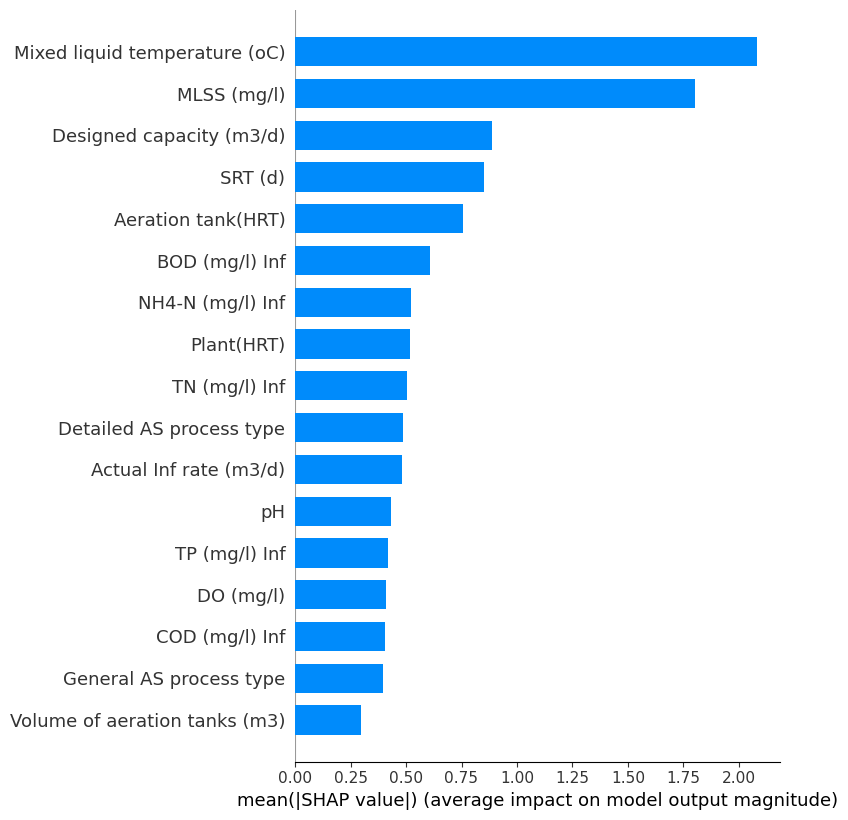

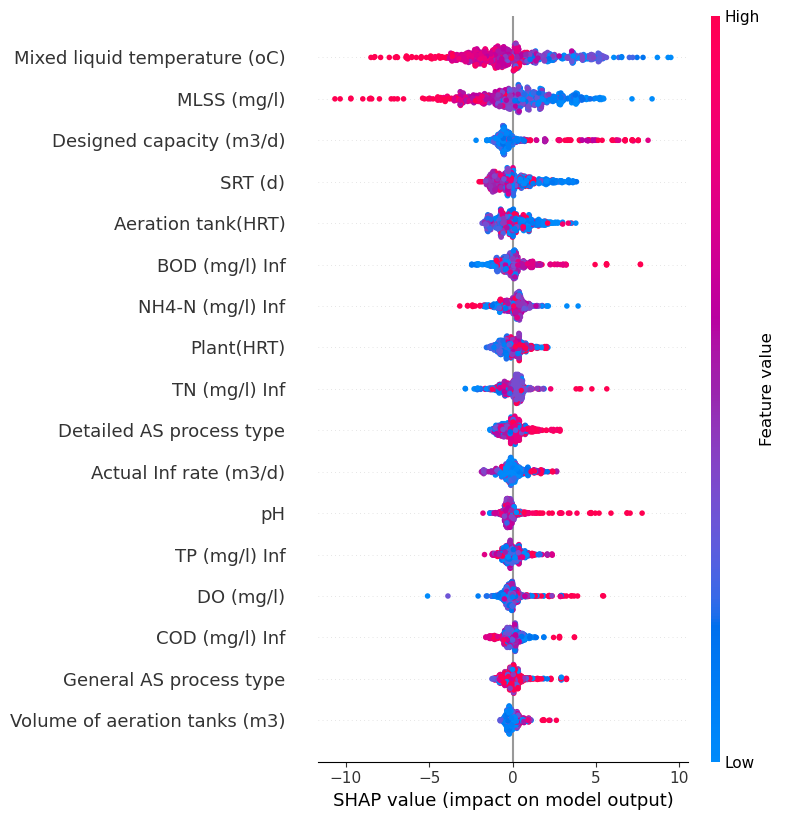

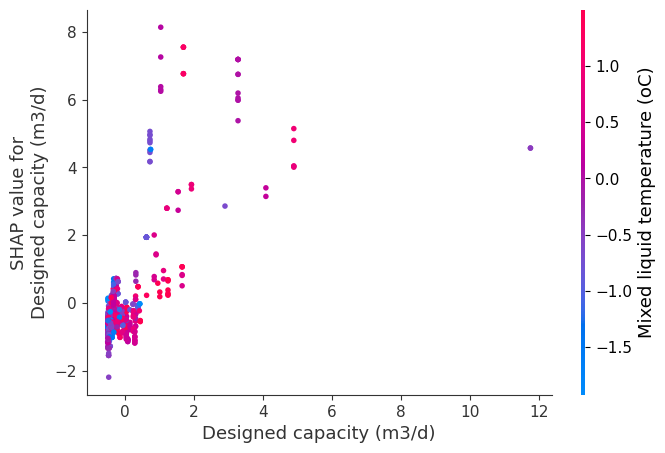

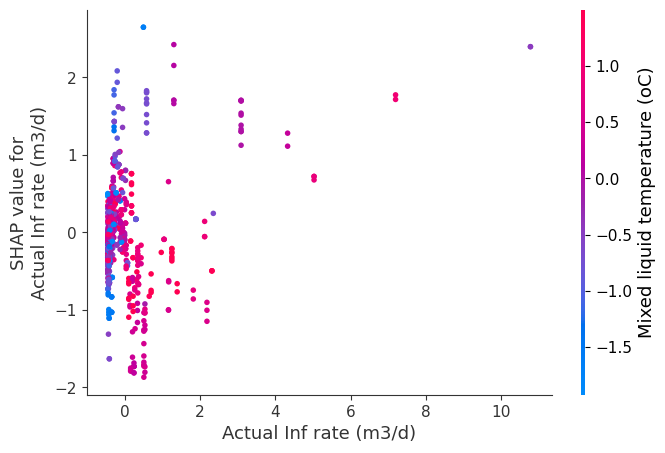

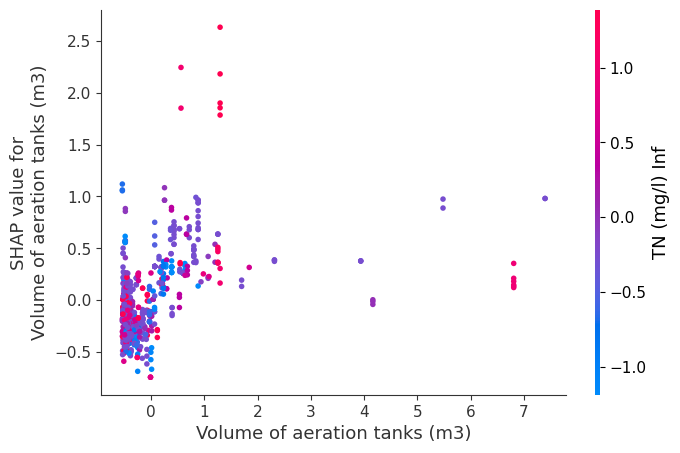

...

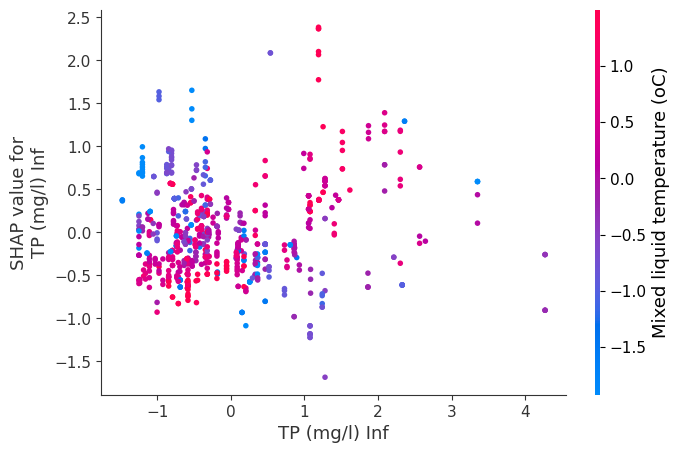

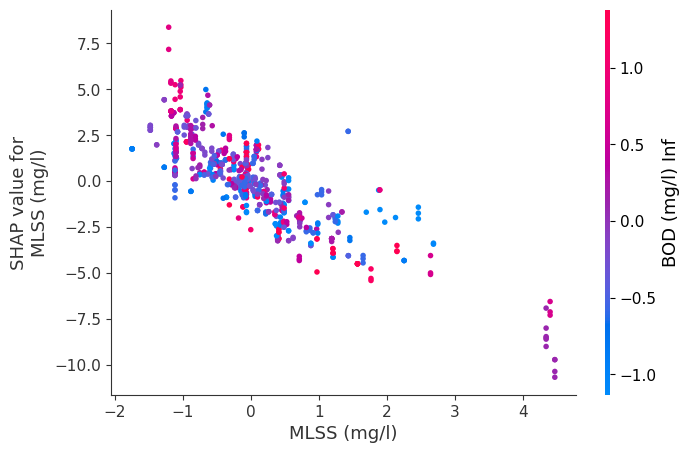

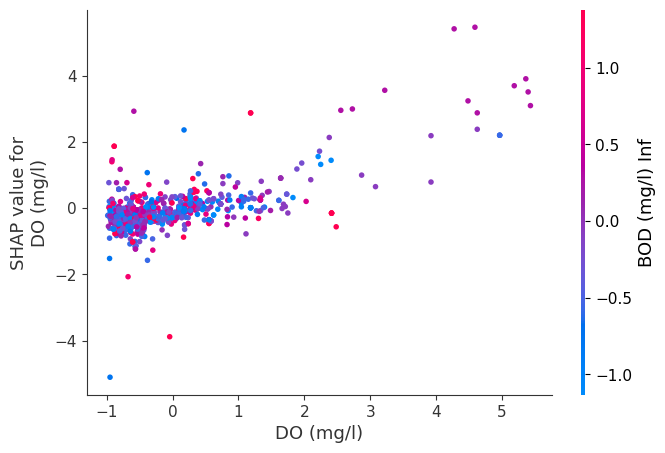

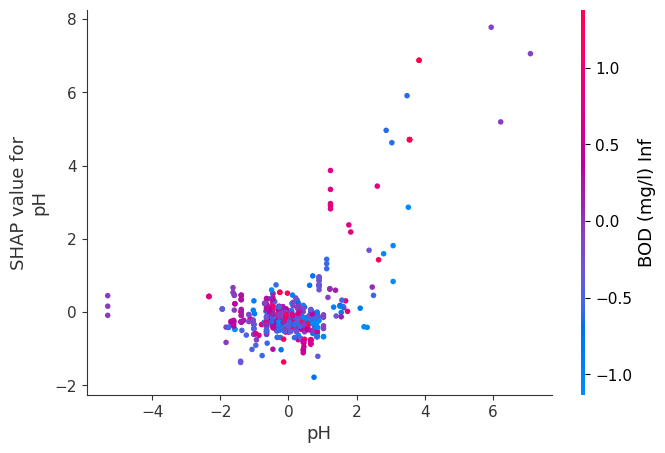

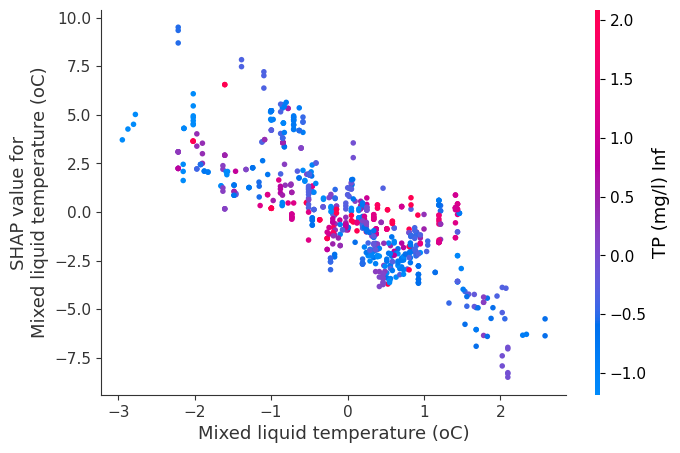


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,7.340600,7.119205,8.999156,8.352166,LinearRegression()
1,Stochastic Gradient Descent Regressor,7.099163,7.113080,9.010872,8.457062,SGDRegressor()
2,Elastic Net Regressor,3.444375,7.342977,9.186410,4.222751,ElasticNet()
3,Bayesian Ridge Regressor,6.773386,7.142170,9.026658,8.422916,BayesianRidge()
4,Support Vector Regressor,21.286529,6.336285,8.294335,22.609118,SVR()
5,K-Neighbors Regressor,50.535842,4.704157,6.575100,53.003486,KNeighborsRegressor()
6,Decision Trees Regressor,58.573856,3.648096,6.017198,59.989545,DecisionTreeRegressor()
7,Random Forest Regressor,72.560485,3.511462,4.897171,77.636580,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,63.380208,4.368887,5.657375,72.882364,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,38.946259,6.207517,7.304881,45.148160,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691714871.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691714871.pkl 

Time Elapsed :  19.12 seconds 



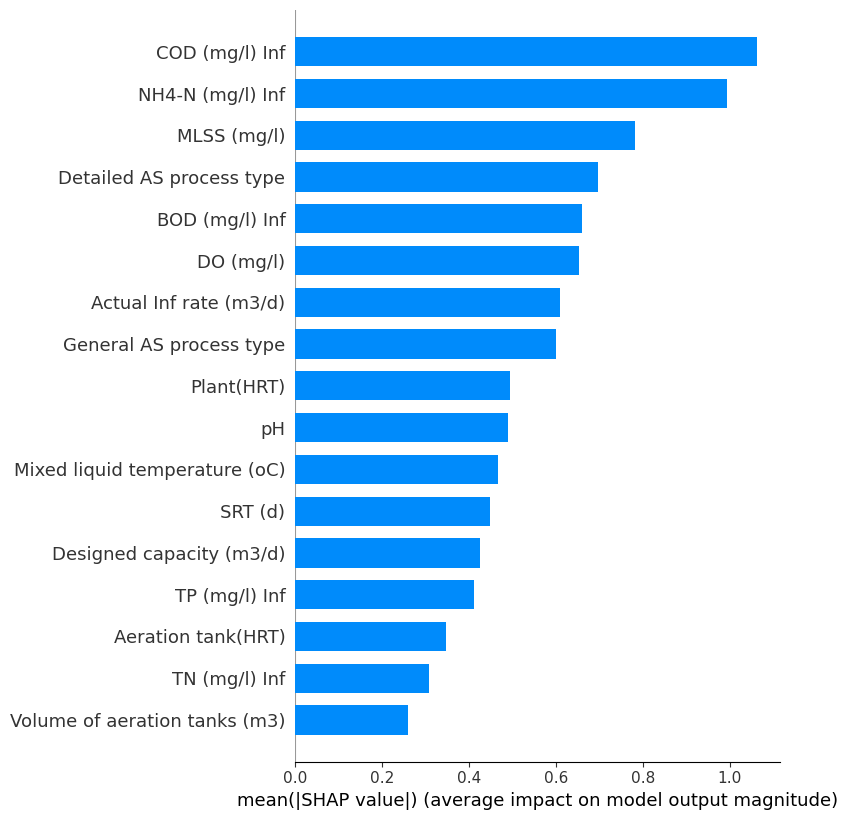

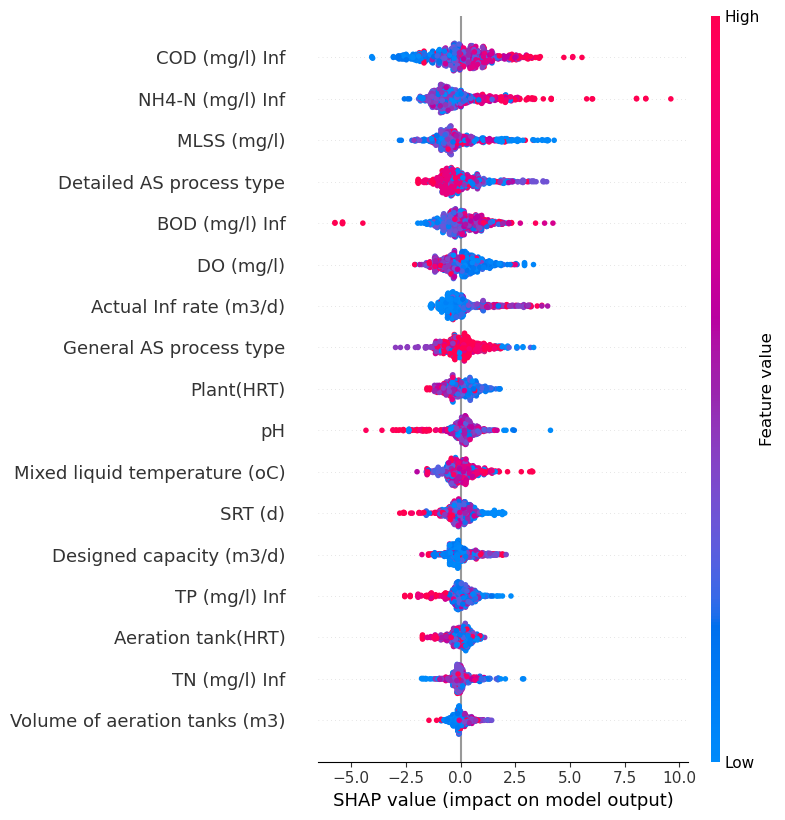

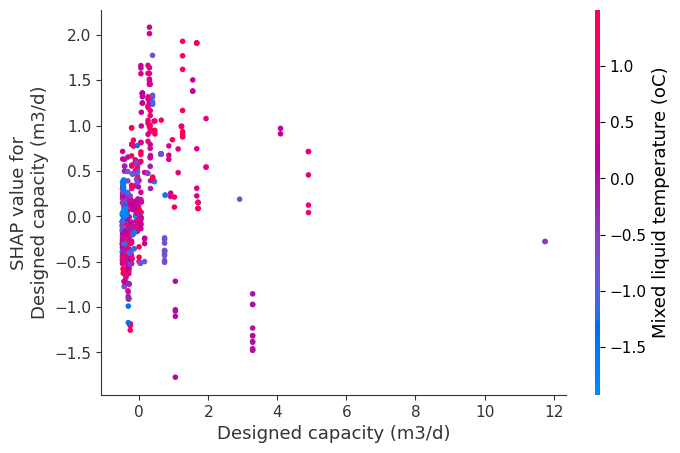

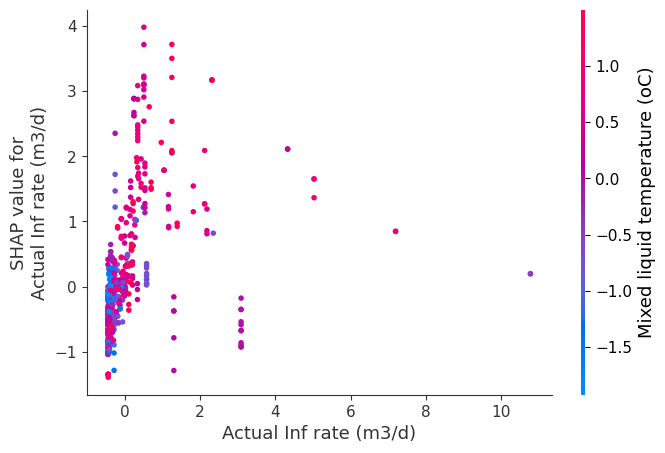

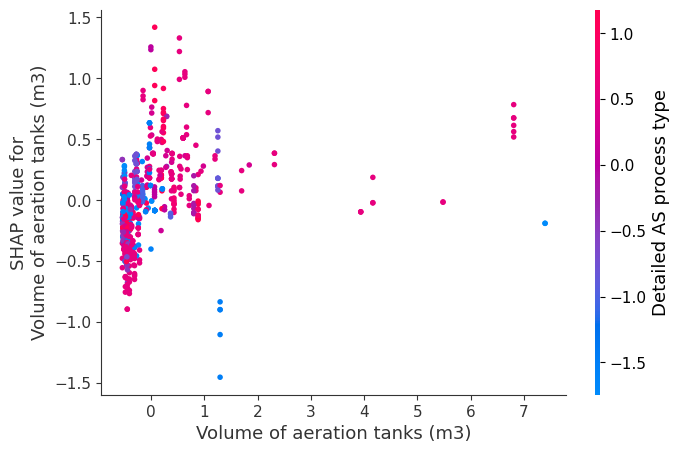

...

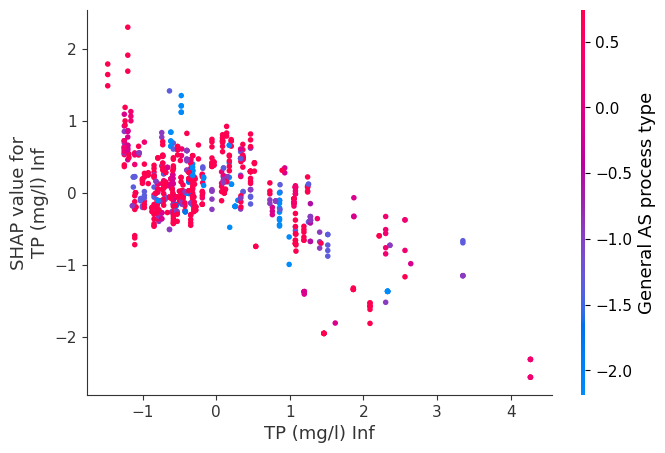

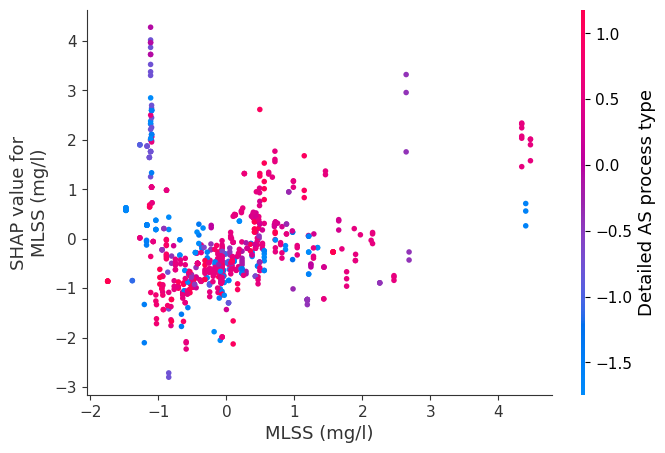

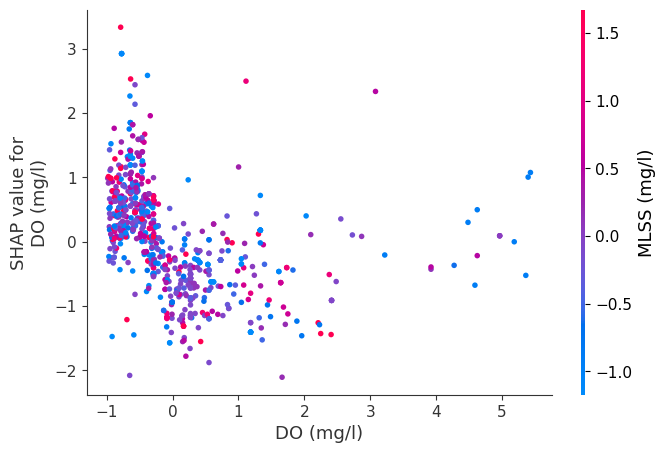

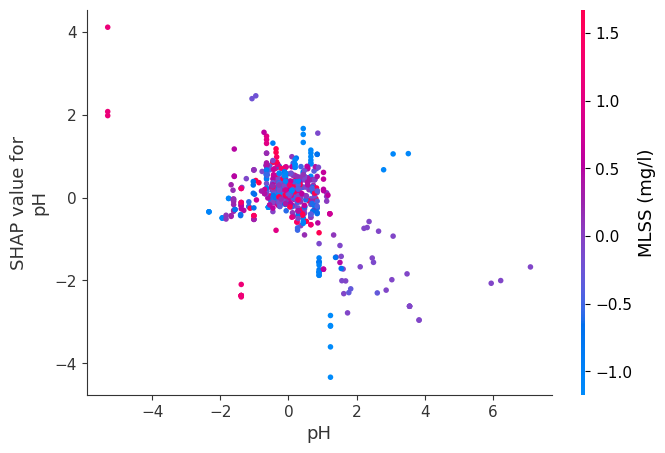

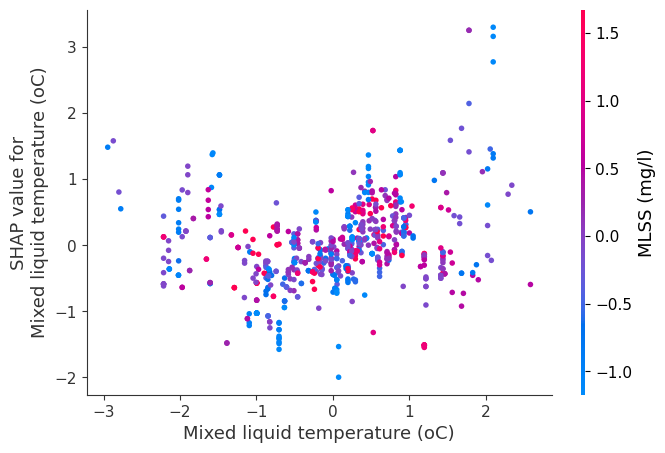


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,25.598152,0.800343,1.161251,19.998375,LinearRegression()
1,Stochastic Gradient Descent Regressor,25.159324,0.801516,1.164671,19.704658,SGDRegressor()
2,Elastic Net Regressor,-0.330718,0.863361,1.348501,-0.986984,ElasticNet()
3,Bayesian Ridge Regressor,25.404286,0.794075,1.162763,20.435884,BayesianRidge()
4,Support Vector Regressor,43.847812,0.515350,1.008829,39.716700,SVR()
5,K-Neighbors Regressor,67.547477,0.491364,0.766935,42.826553,KNeighborsRegressor()
6,Decision Trees Regressor,74.129258,0.288471,0.684761,61.553516,DecisionTreeRegressor()
7,Random Forest Regressor,78.519757,0.350037,0.623956,73.808158,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,68.368930,0.496762,0.757166,65.028420,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,33.710079,0.853213,1.096120,27.955319,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691714903.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691714903.pkl 

Time Elapsed :  19.60 seconds 



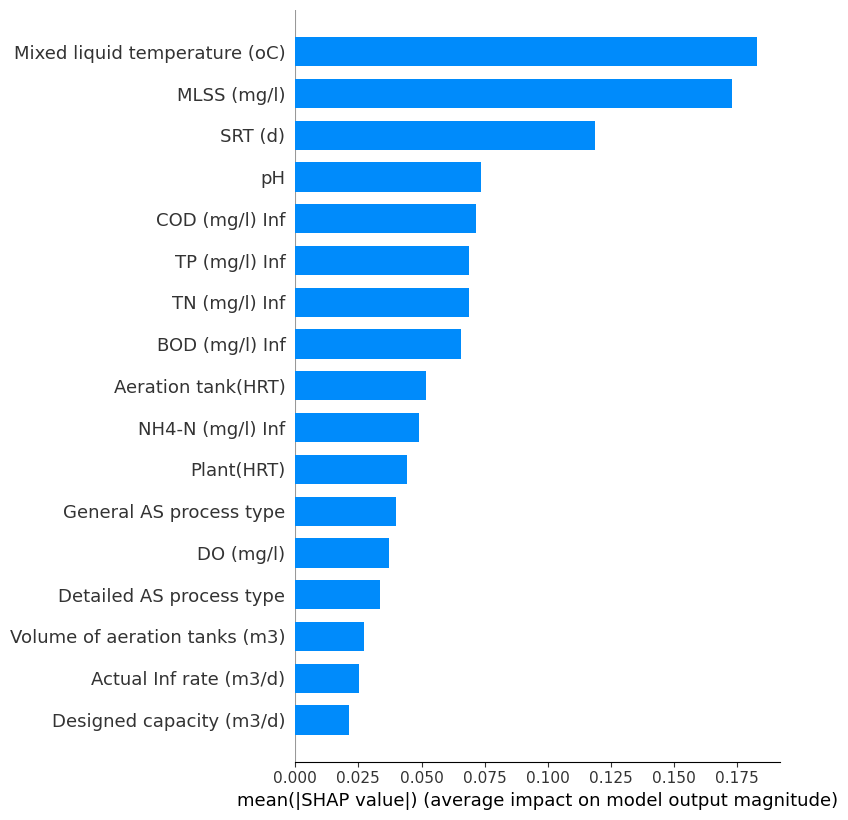

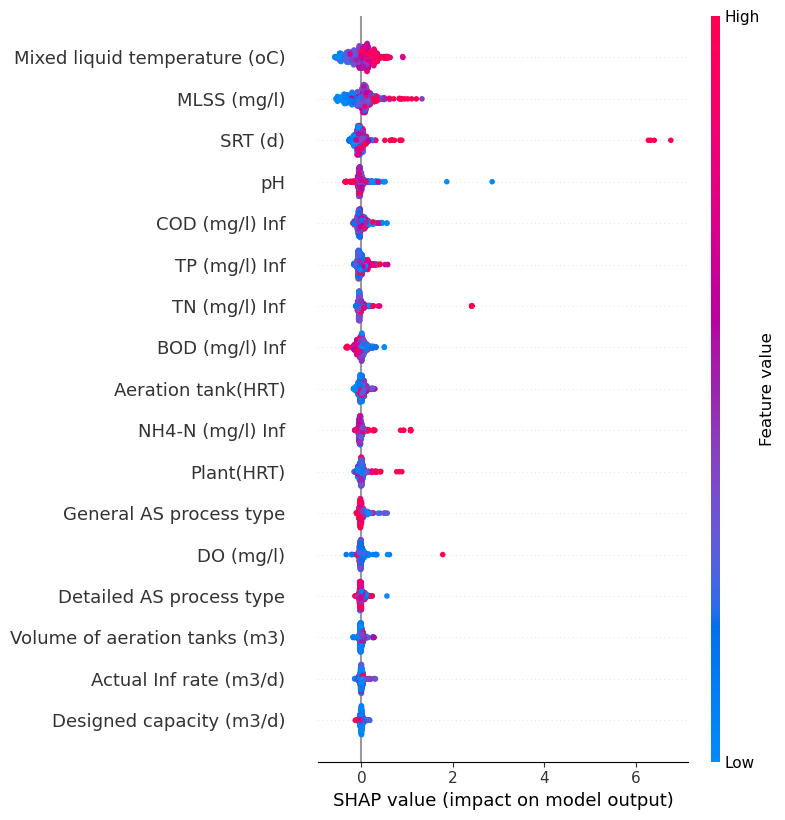

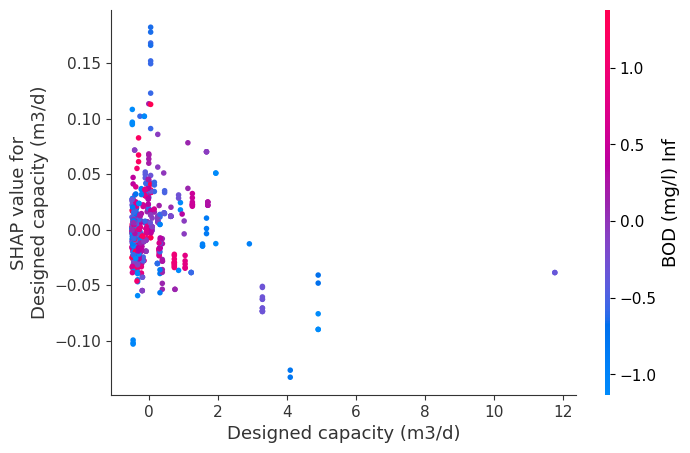

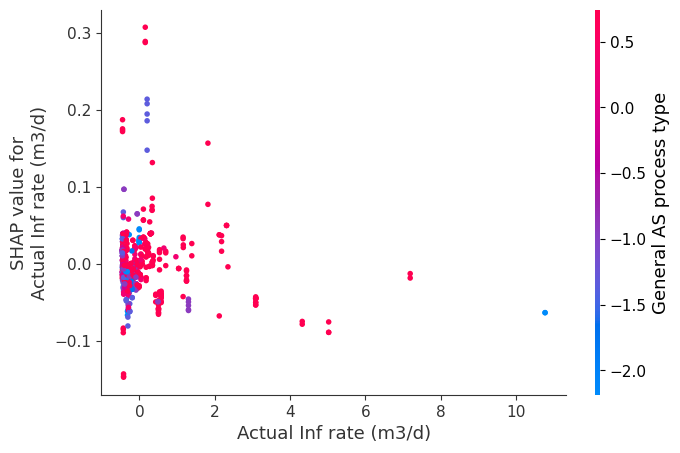

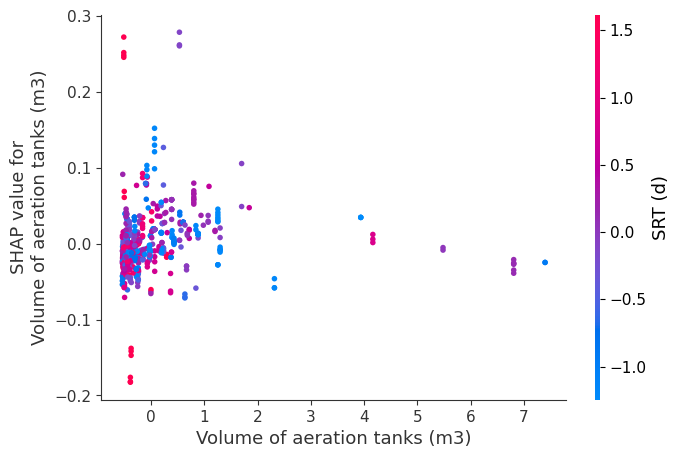

...

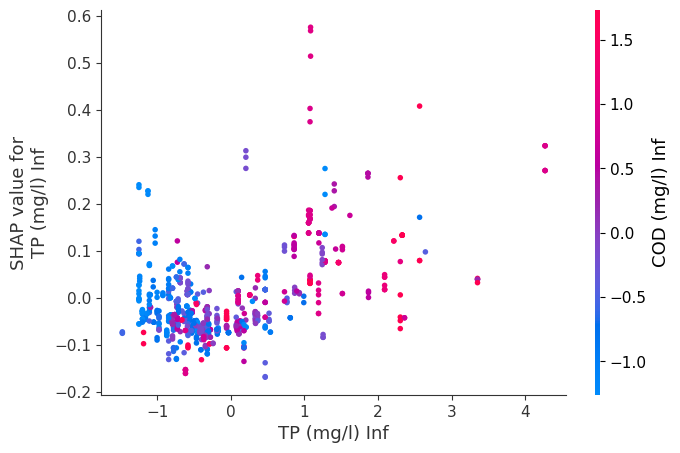

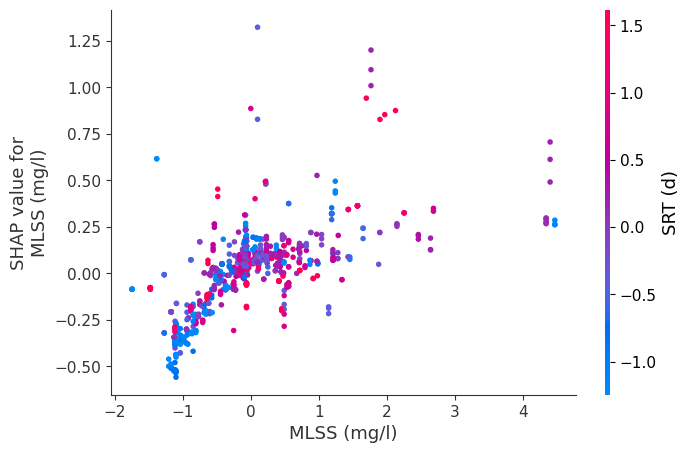

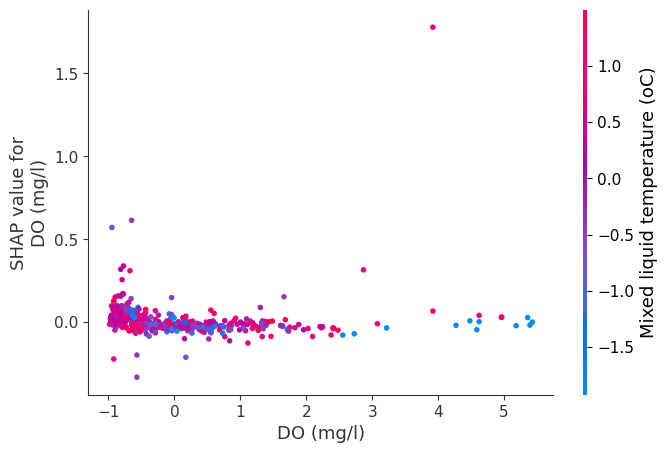

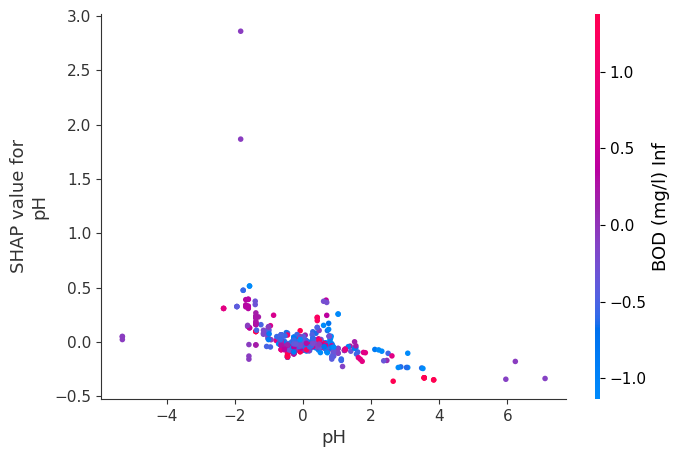

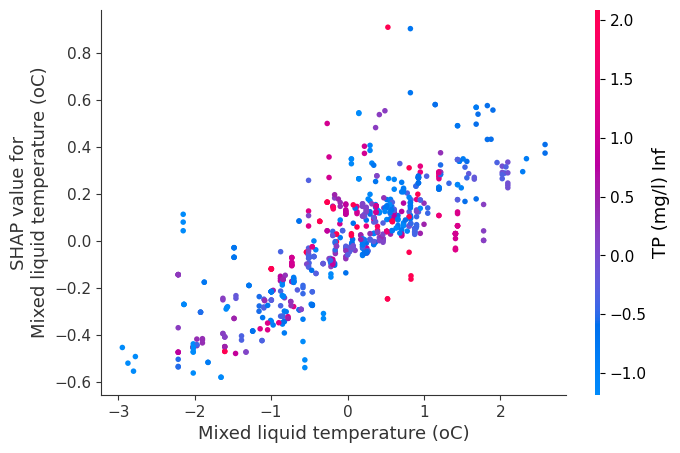


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,5.875072,2.358540,2.897550,13.479976,LinearRegression()
1,Stochastic Gradient Descent Regressor,6.152454,2.357605,2.893277,13.502810,SGDRegressor()
2,Elastic Net Regressor,3.888544,2.317088,2.927967,4.340146,ElasticNet()
3,Bayesian Ridge Regressor,7.338600,2.336248,2.874935,13.852645,BayesianRidge()
4,Support Vector Regressor,39.276325,1.726518,2.327328,41.421109,SVR()
5,K-Neighbors Regressor,43.131309,1.590328,2.252243,55.730218,KNeighborsRegressor()
6,Decision Trees Regressor,72.684617,0.967814,1.560926,73.446542,DecisionTreeRegressor()
7,Random Forest Regressor,79.478221,0.939116,1.352963,82.413043,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,68.889313,1.294924,1.665840,72.360777,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,41.844430,1.900000,2.277583,38.192310,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691714938.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691714938.pkl 

Time Elapsed :  20.11 seconds 



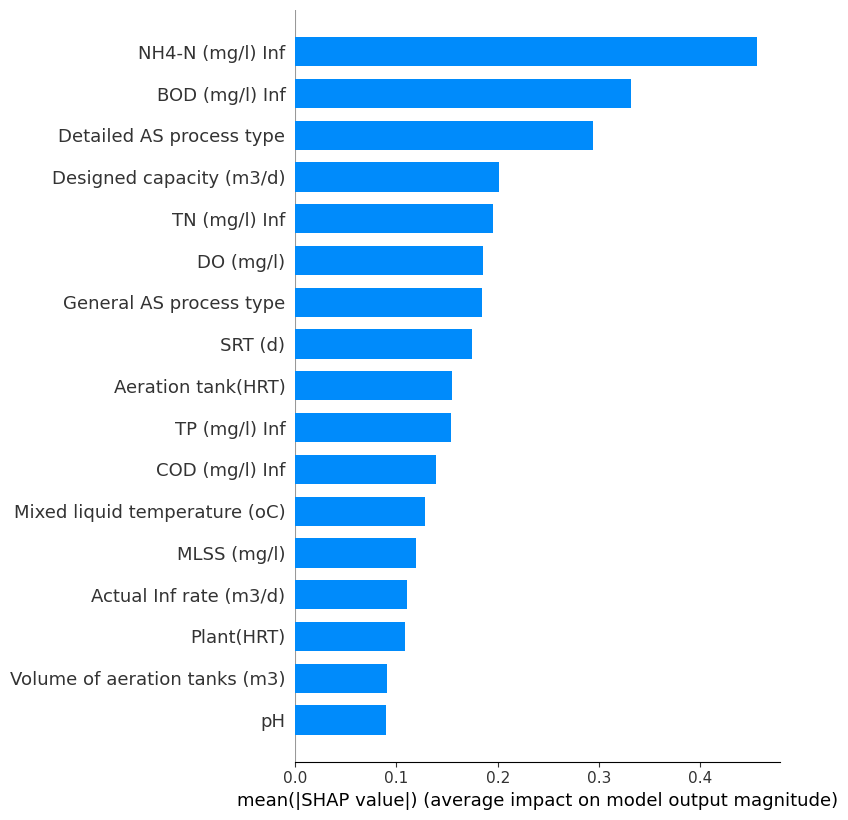

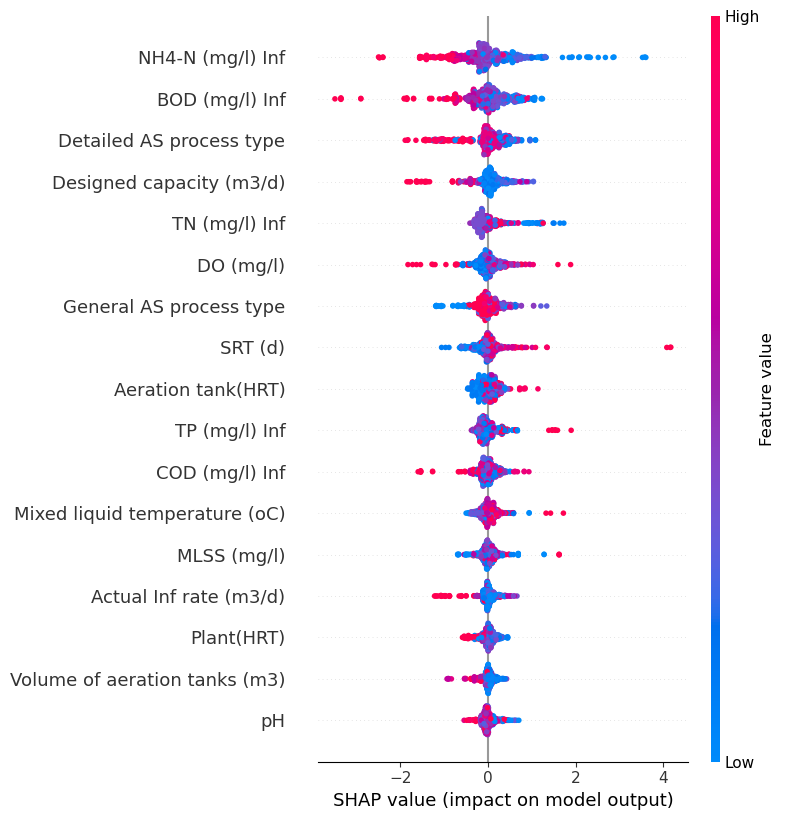

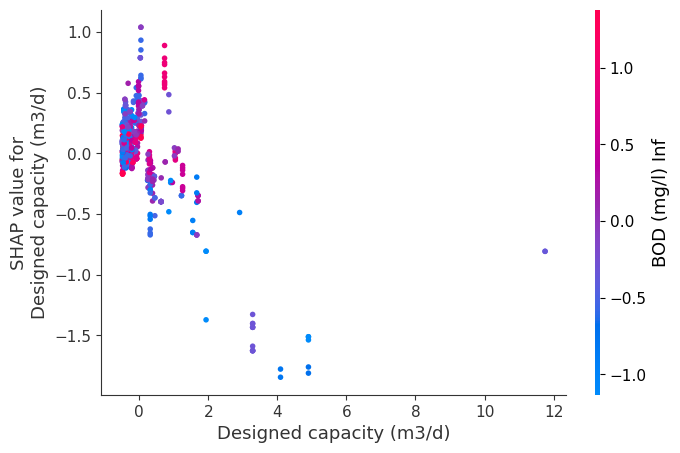

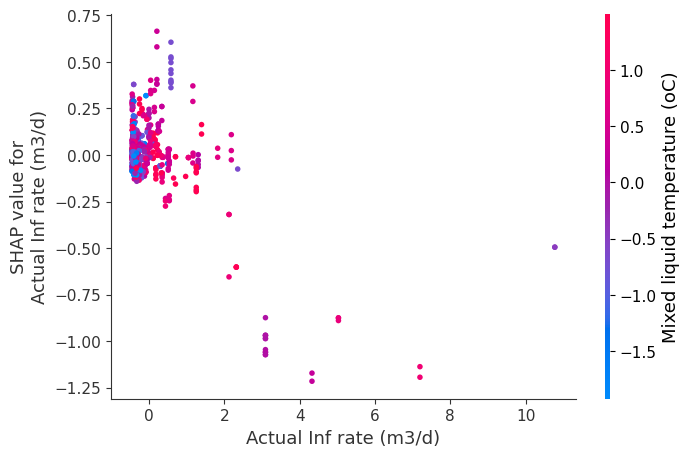

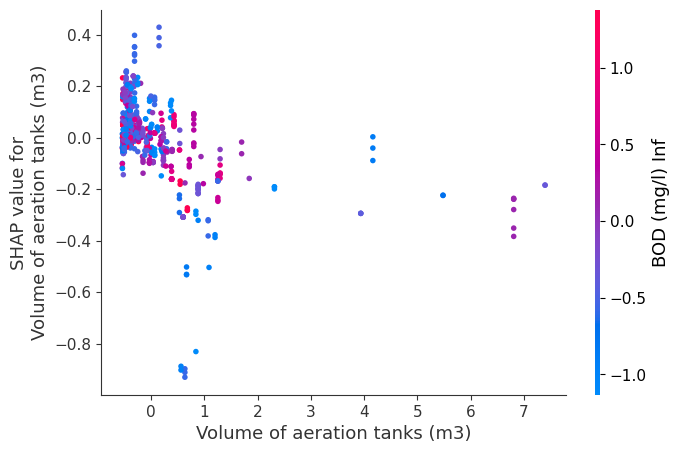

...

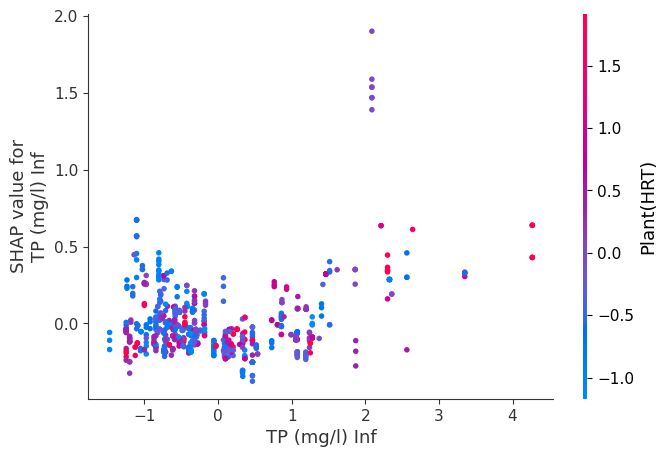

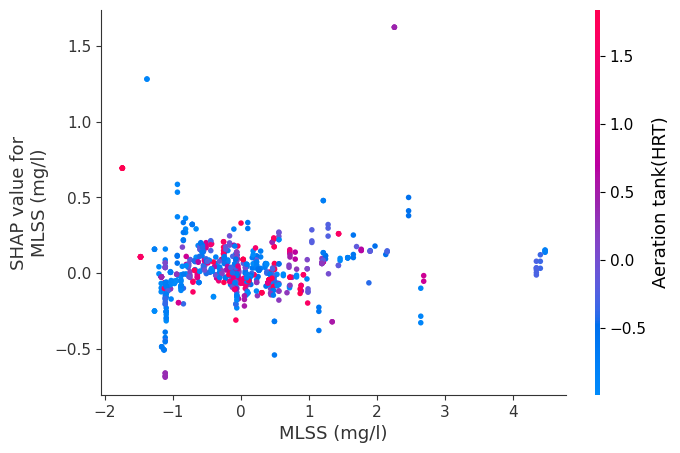

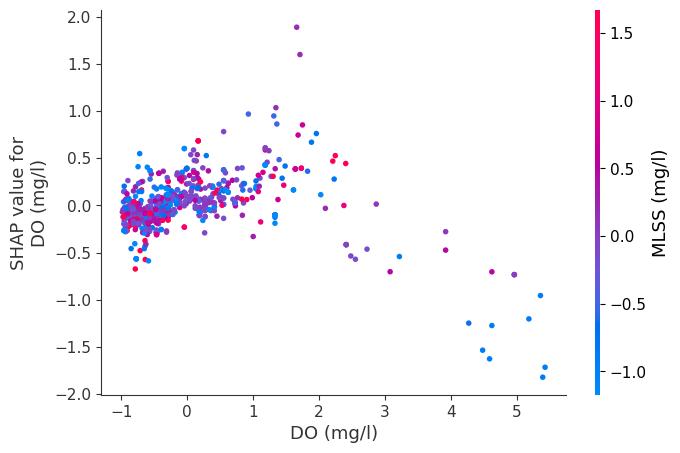

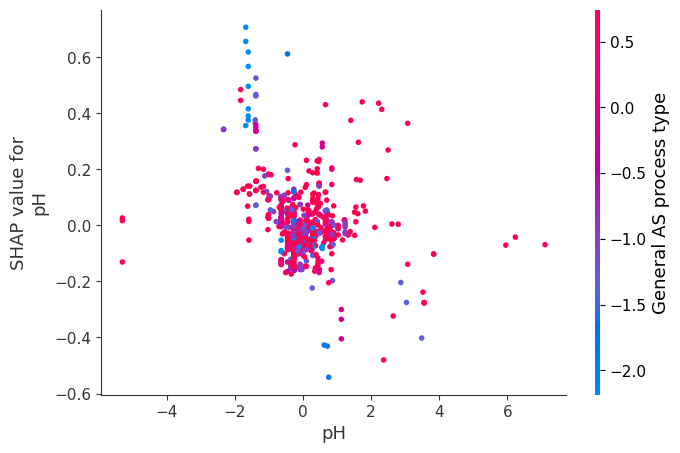

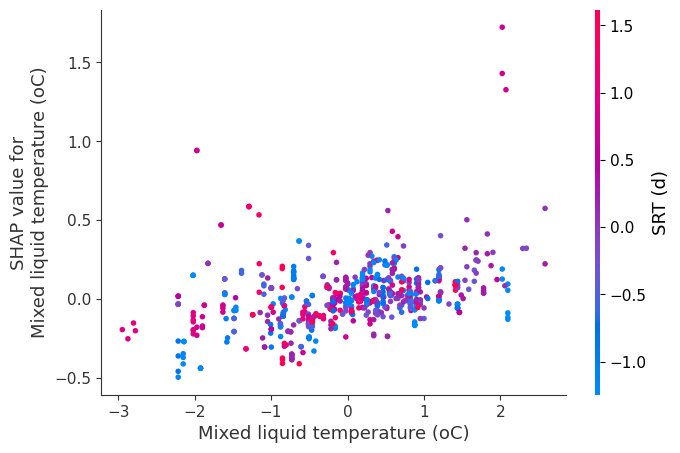


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,13.567800,1.197572,1.770744,9.847719,LinearRegression()
1,Stochastic Gradient Descent Regressor,13.934233,1.195379,1.766987,9.280234,SGDRegressor()
2,Elastic Net Regressor,-1.024854,1.206018,1.914398,-1.309721,ElasticNet()
3,Bayesian Ridge Regressor,13.544290,1.190906,1.770985,10.770204,BayesianRidge()
4,Support Vector Regressor,36.481268,0.757810,1.517990,51.050069,SVR()
5,K-Neighbors Regressor,51.484686,0.680588,1.326653,61.562575,KNeighborsRegressor()
6,Decision Trees Regressor,69.501621,0.344987,1.051856,78.561439,DecisionTreeRegressor()
7,Random Forest Regressor,76.079018,0.394999,0.931553,83.623440,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,76.405184,0.539726,0.925180,78.295307,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,45.323763,0.996402,1.408372,46.306833,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691714971.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691714971.pkl 

Time Elapsed :  19.50 seconds 



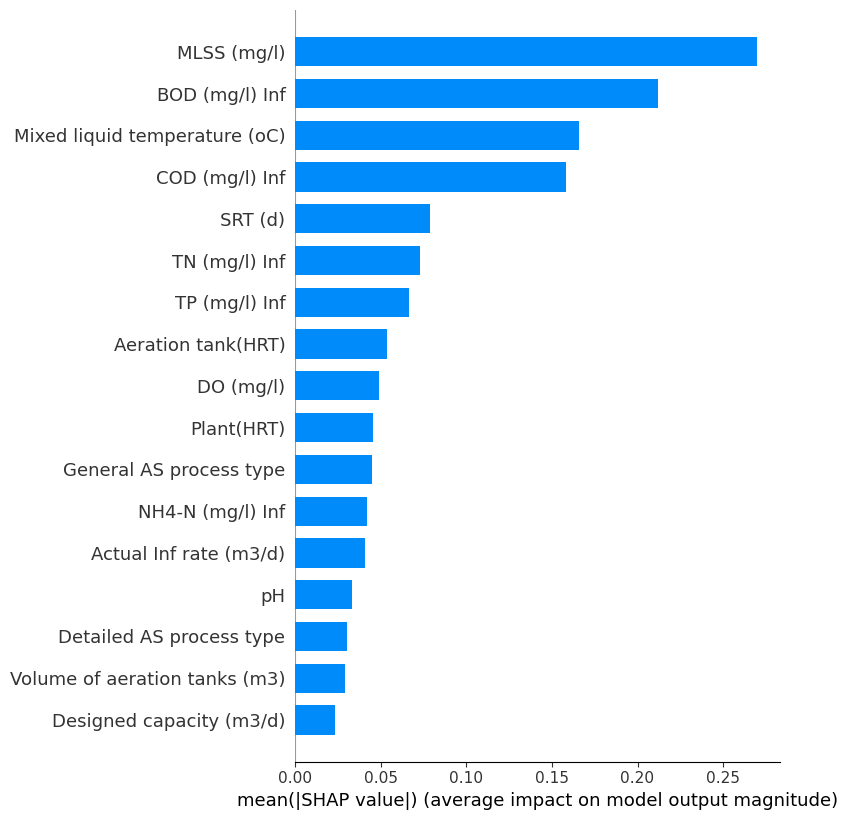

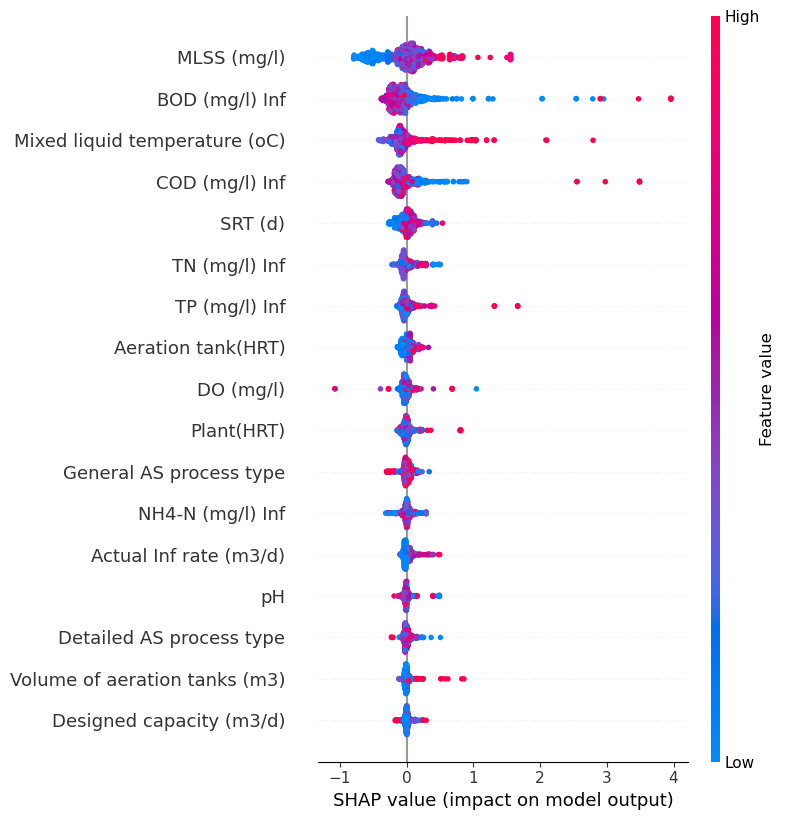

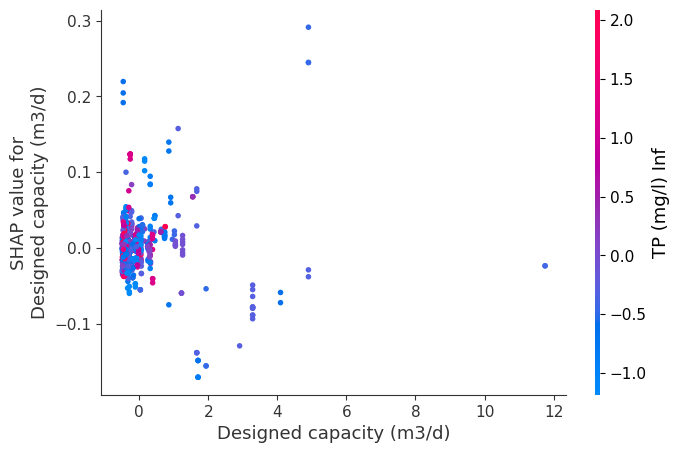

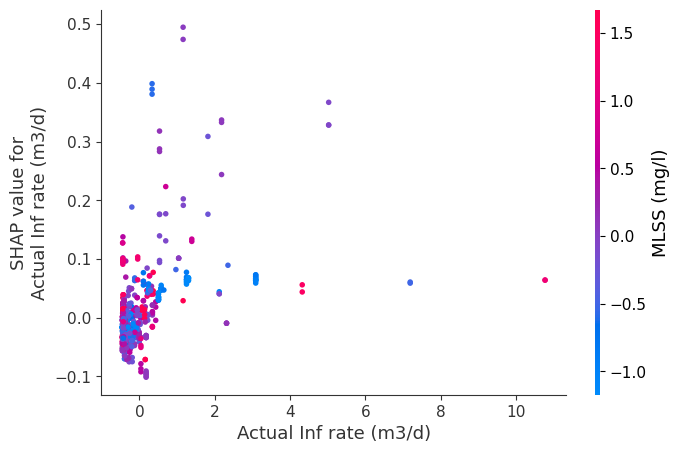

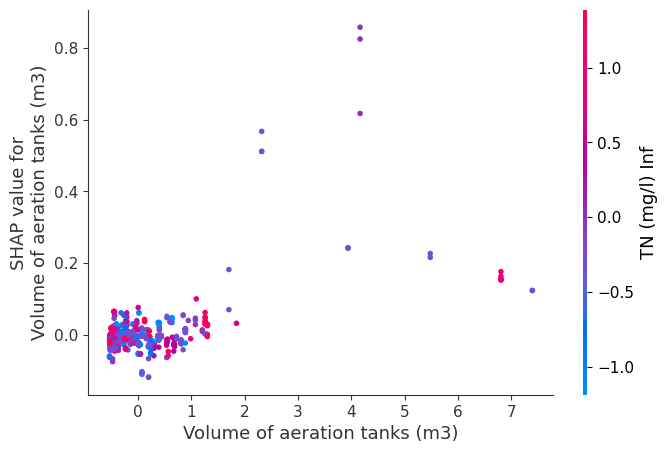

...

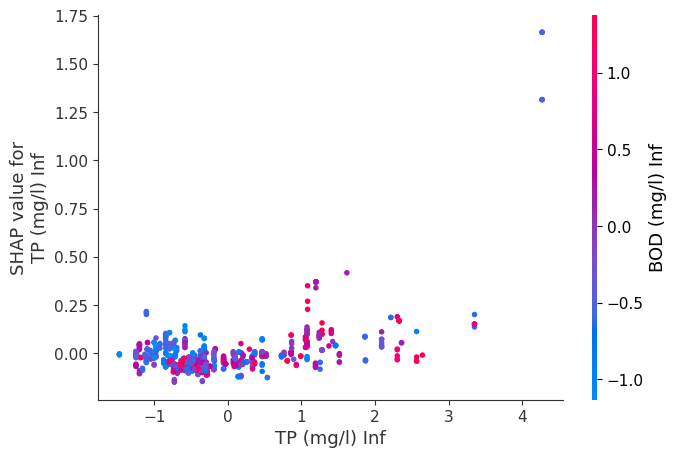

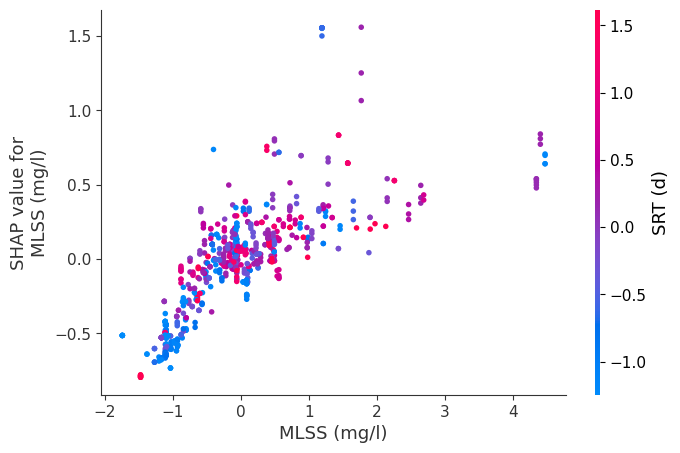

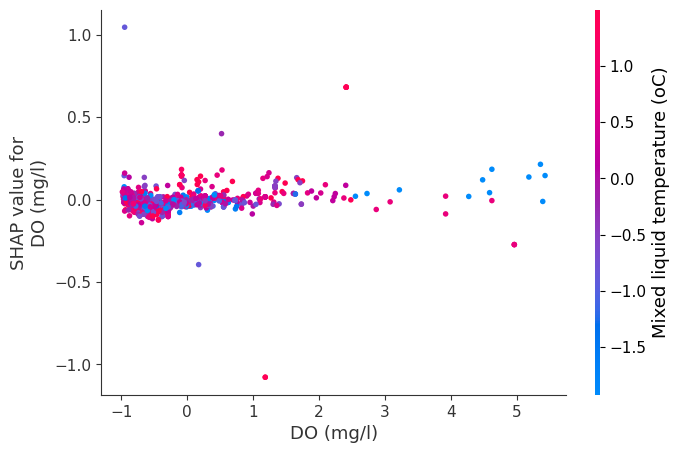

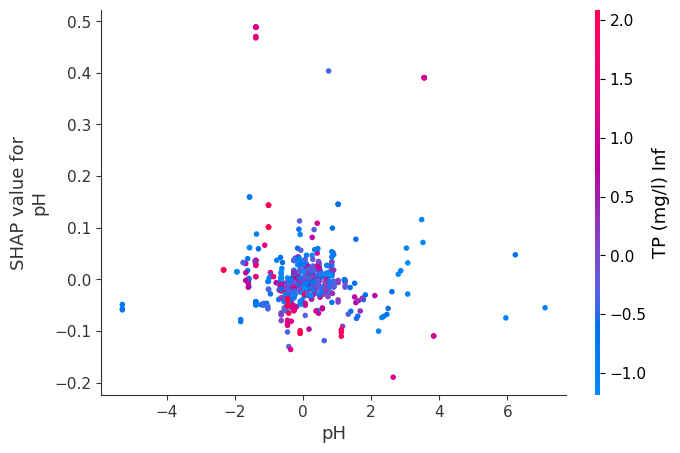

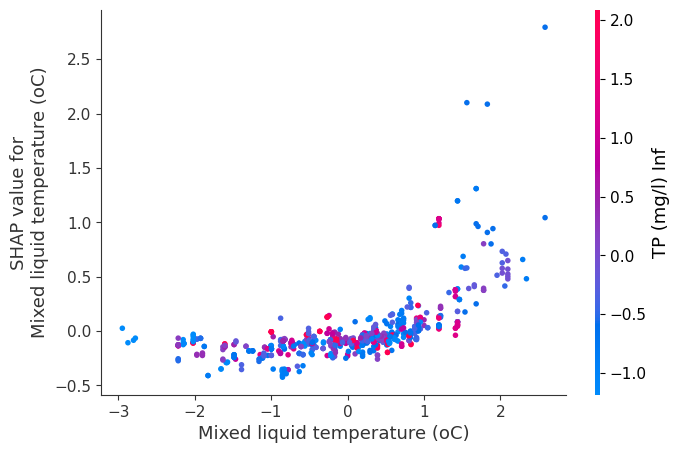


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,19.251078,1.509673,2.150852,20.586387,LinearRegression()
1,Stochastic Gradient Descent Regressor,19.232340,1.503733,2.151102,20.766726,SGDRegressor()
2,Elastic Net Regressor,3.708685,1.708403,2.348745,4.725364,ElasticNet()
3,Bayesian Ridge Regressor,19.495257,1.497653,2.147598,21.087428,BayesianRidge()
4,Support Vector Regressor,36.745687,1.109775,1.903651,45.113351,SVR()
5,K-Neighbors Regressor,51.852666,1.056373,1.660842,54.498393,KNeighborsRegressor()
6,Decision Trees Regressor,75.937676,0.659114,1.174116,67.469911,DecisionTreeRegressor()
7,Random Forest Regressor,82.438961,0.624710,1.003038,79.459229,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,71.278471,0.858161,1.282762,71.709531,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,35.463468,1.555173,1.922848,38.561584,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715003.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715003.pkl 

Time Elapsed :  19.32 seconds 



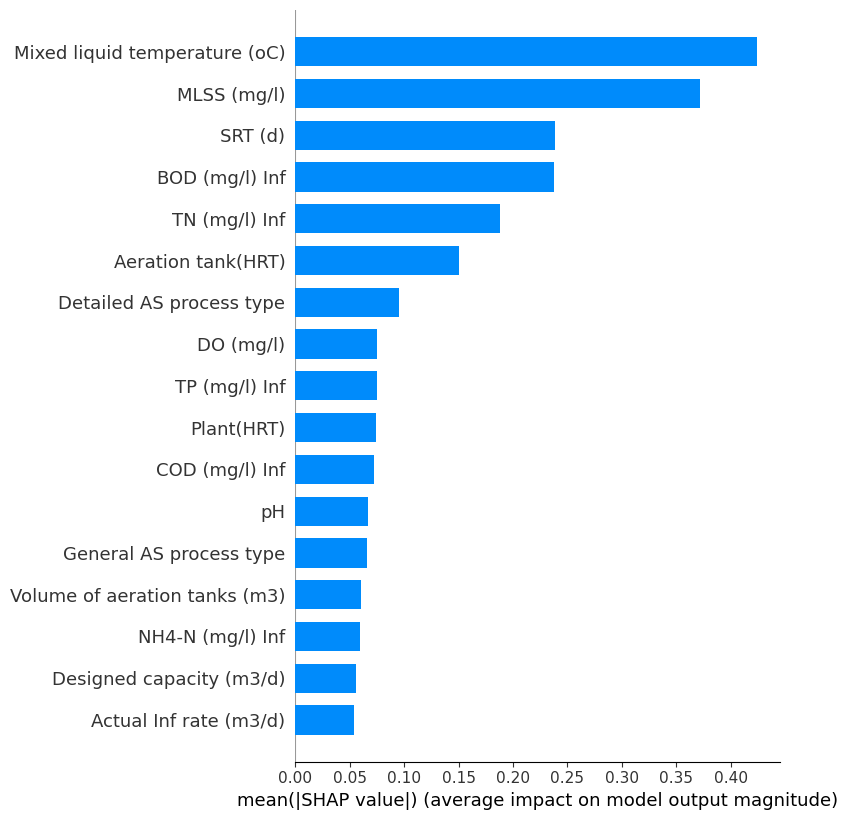

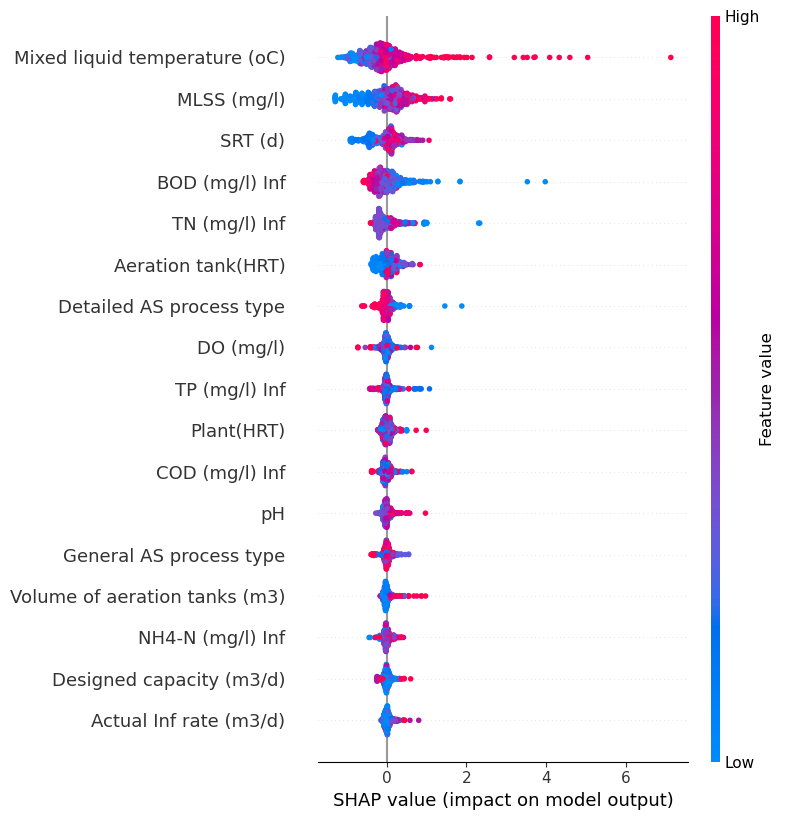

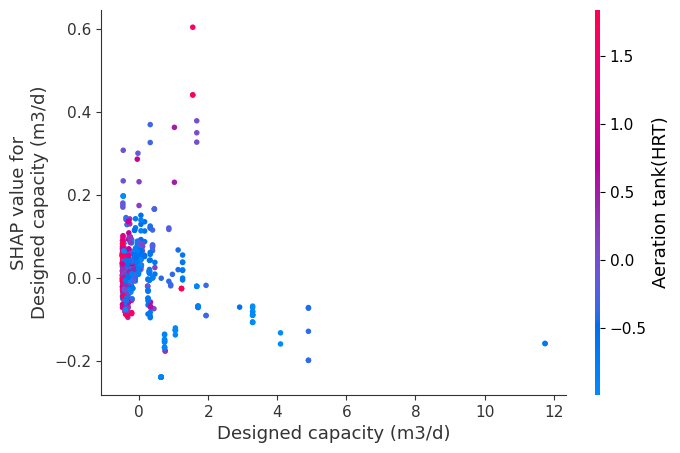

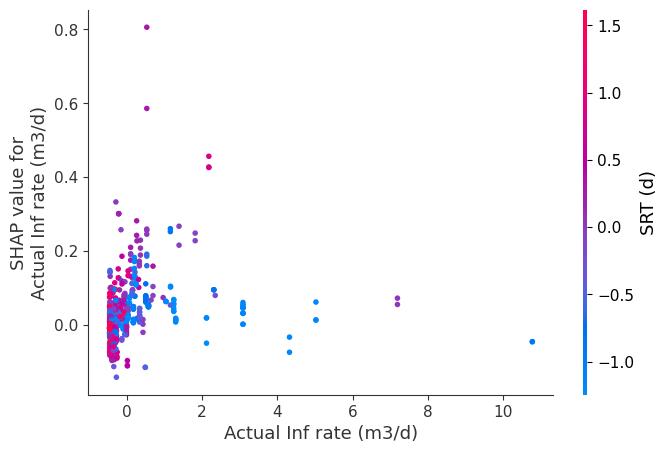

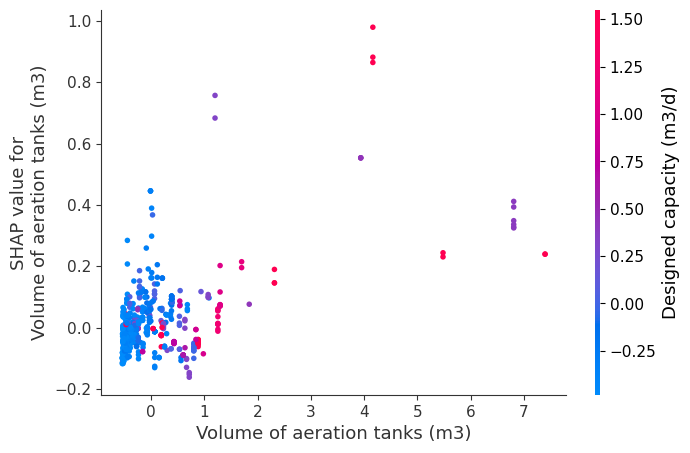

...

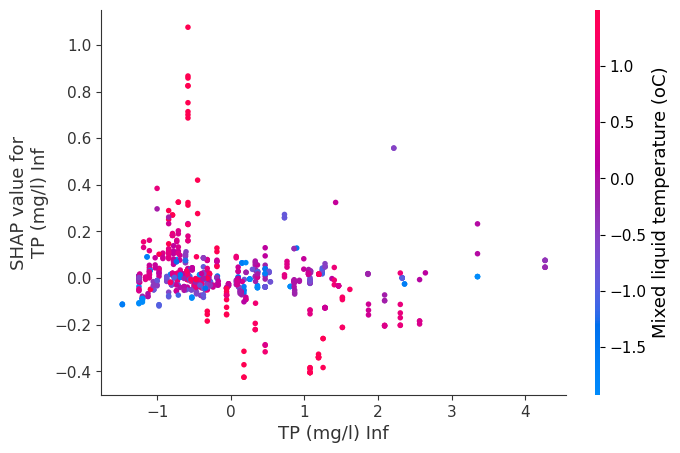

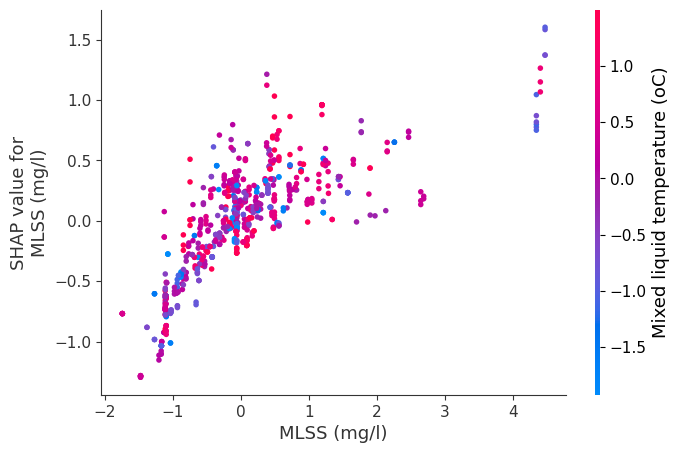

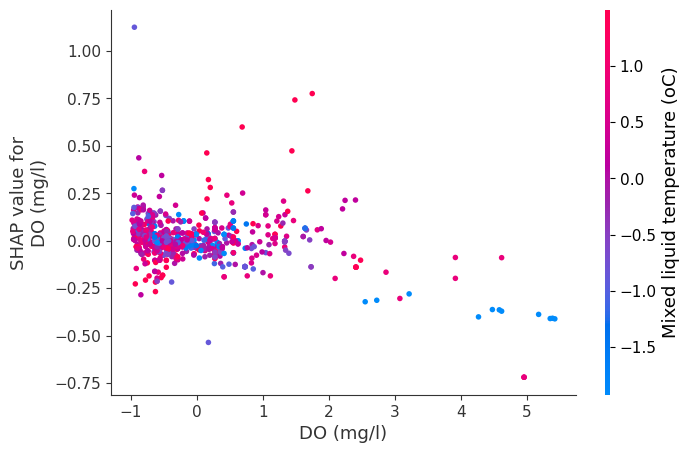

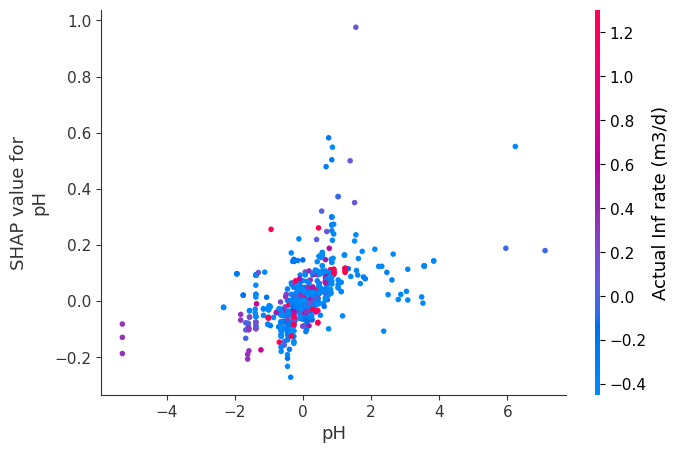

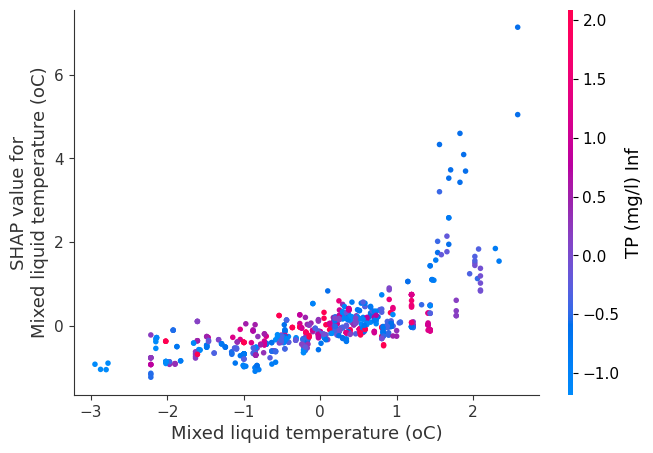


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,16.171332,0.418486,0.524711,10.765471,LinearRegression()
1,Stochastic Gradient Descent Regressor,11.608541,0.424249,0.538802,10.105968,SGDRegressor()
2,Elastic Net Regressor,-0.756880,0.461133,0.575256,-0.919284,ElasticNet()
3,Bayesian Ridge Regressor,12.945876,0.422775,0.534710,10.142296,BayesianRidge()
4,Support Vector Regressor,55.857247,0.255193,0.380762,44.658801,SVR()
5,K-Neighbors Regressor,29.309527,0.324656,0.481841,40.649804,KNeighborsRegressor()
6,Decision Trees Regressor,60.338622,0.186896,0.360917,63.150034,DecisionTreeRegressor()
7,Random Forest Regressor,64.263053,0.210050,0.342596,72.310352,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,61.494545,0.254616,0.355619,63.034649,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,20.802440,0.430183,0.510011,22.979016,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715035.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715035.pkl 

Time Elapsed :  19.91 seconds 



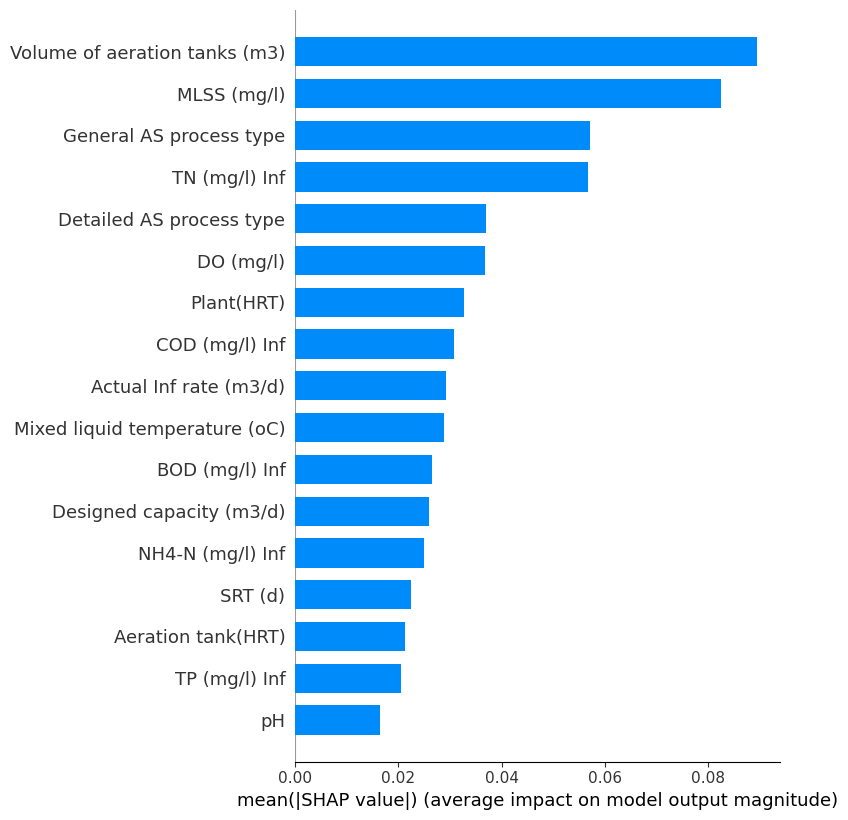

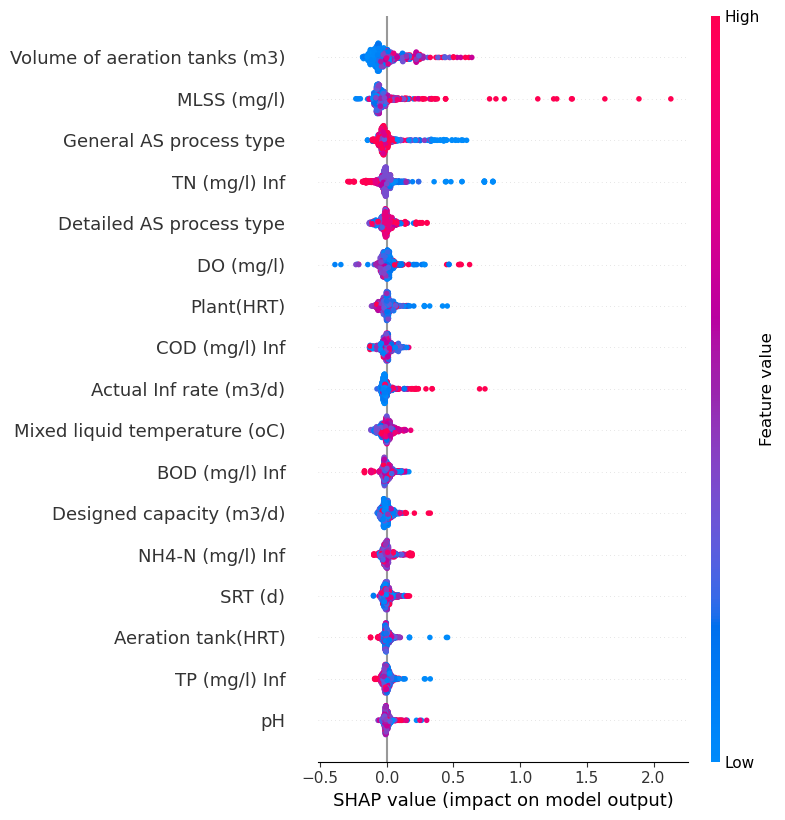

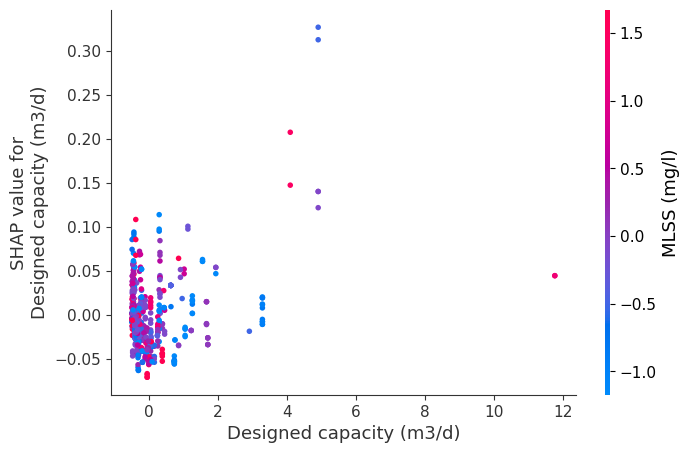

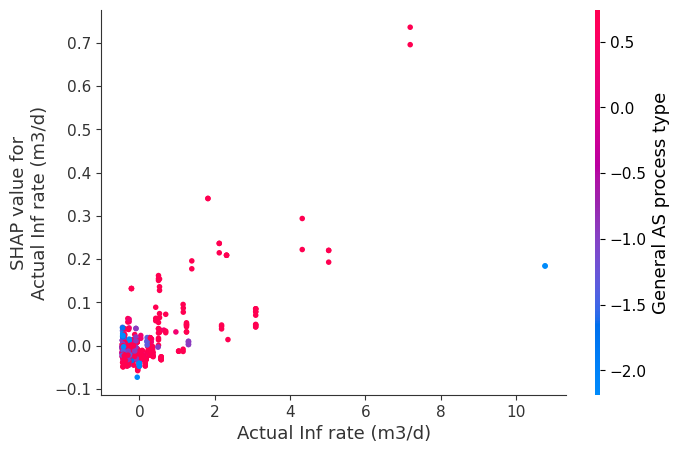

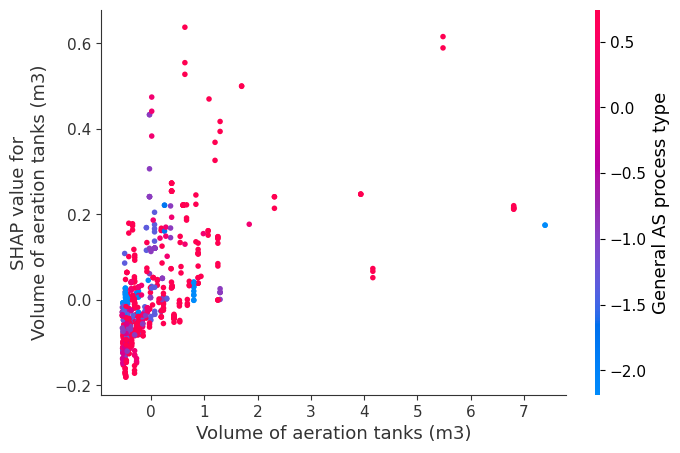

...

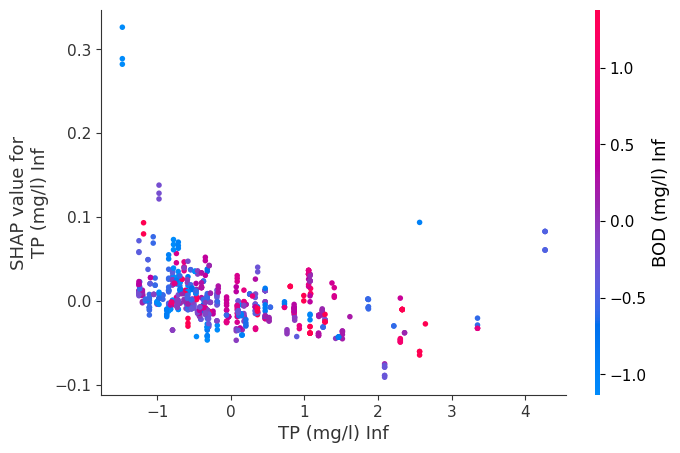

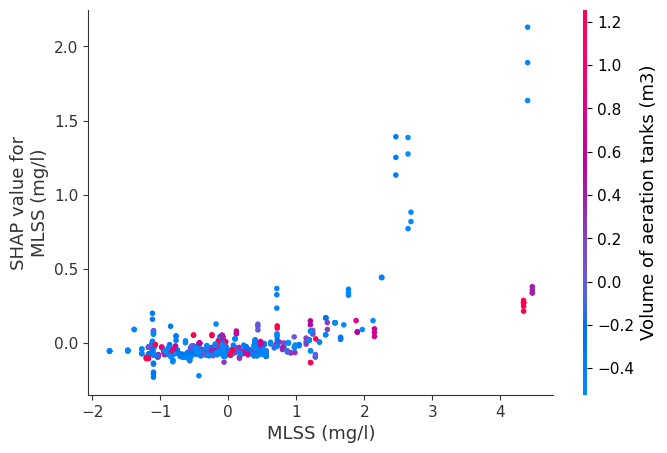

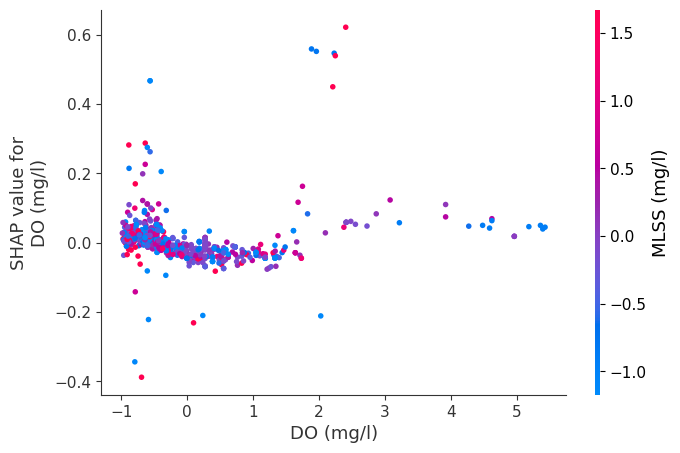

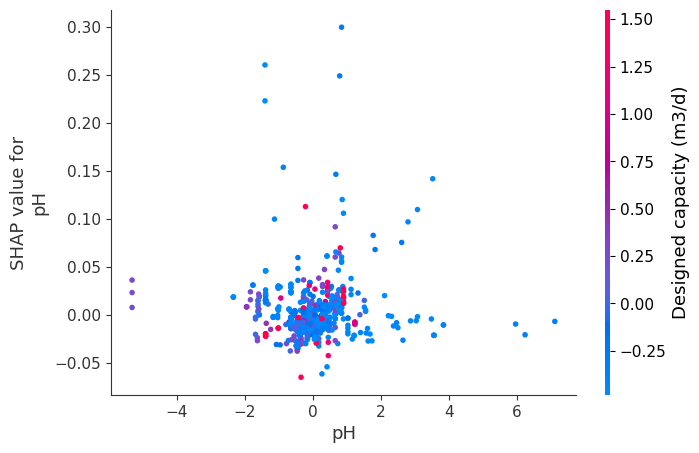

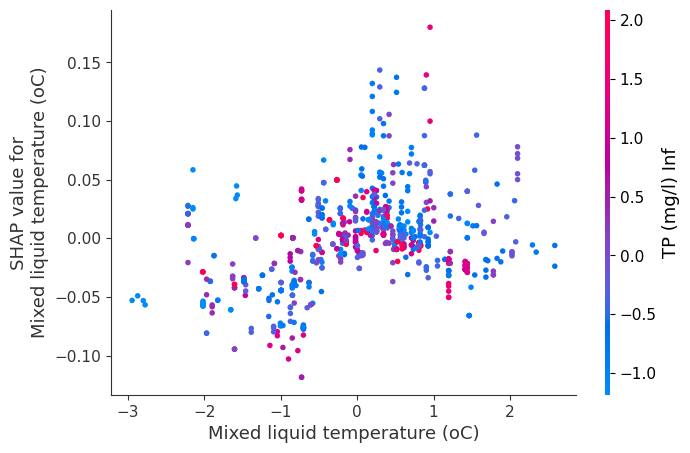


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,-12.184173,3.055514,4.147410,8.116977,LinearRegression()
1,Stochastic Gradient Descent Regressor,-10.964710,3.051520,4.124807,8.441287,SGDRegressor()
2,Elastic Net Regressor,-0.289115,2.797030,3.921372,-0.371583,ElasticNet()
3,Bayesian Ridge Regressor,-6.989368,2.964877,4.050247,8.473149,BayesianRidge()
4,Support Vector Regressor,14.647728,2.155606,3.617585,31.883627,SVR()
5,K-Neighbors Regressor,40.120777,1.896701,3.030046,50.561740,KNeighborsRegressor()
6,Decision Trees Regressor,62.078692,1.161135,2.411309,84.716671,DecisionTreeRegressor()
7,Random Forest Regressor,66.172308,1.199558,2.277442,86.494968,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,61.135387,1.547546,2.441115,77.068100,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,25.867893,2.631728,3.371431,47.742800,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715071.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715071.pkl 

Time Elapsed :  21.62 seconds 



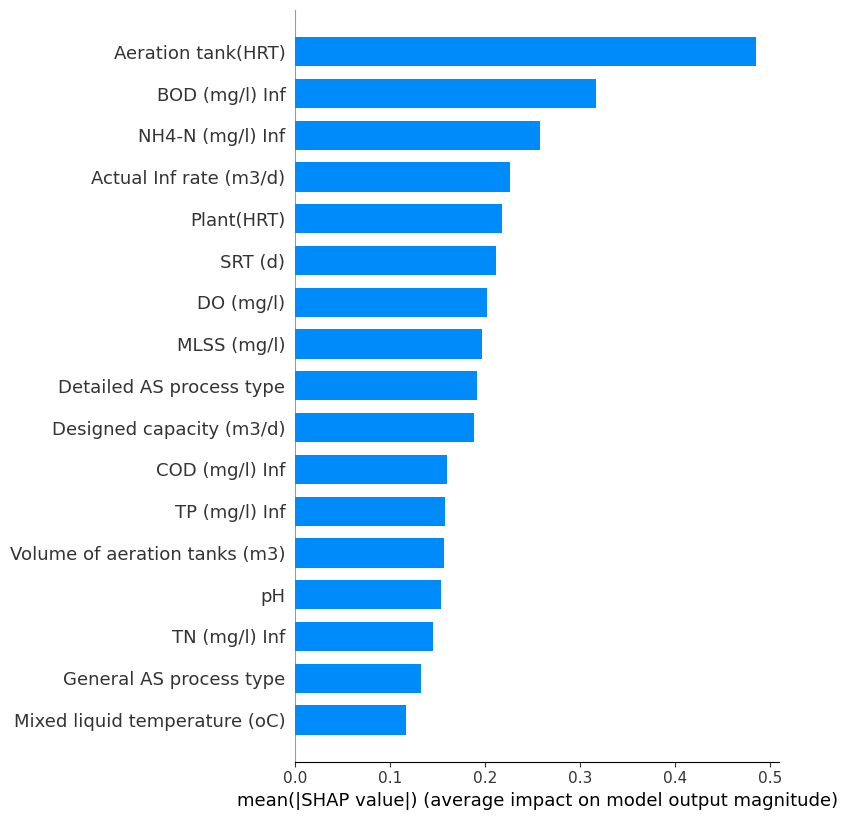

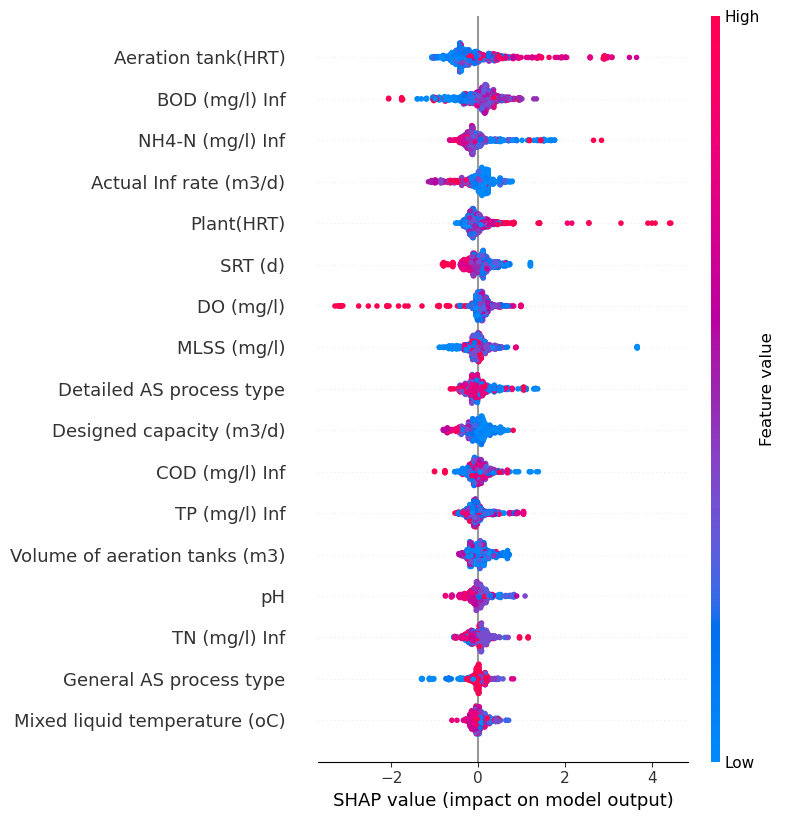

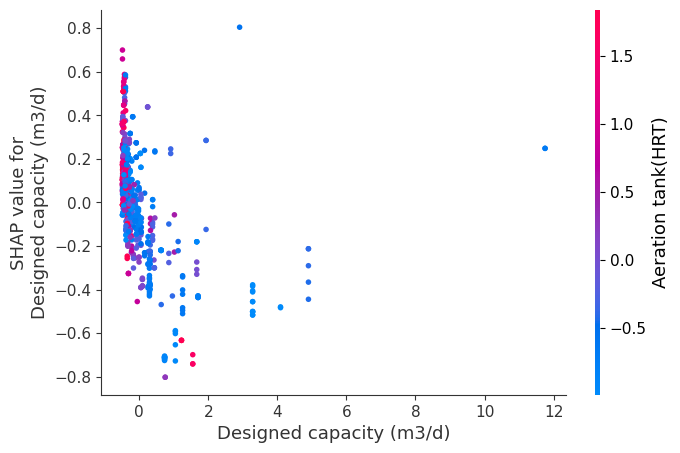

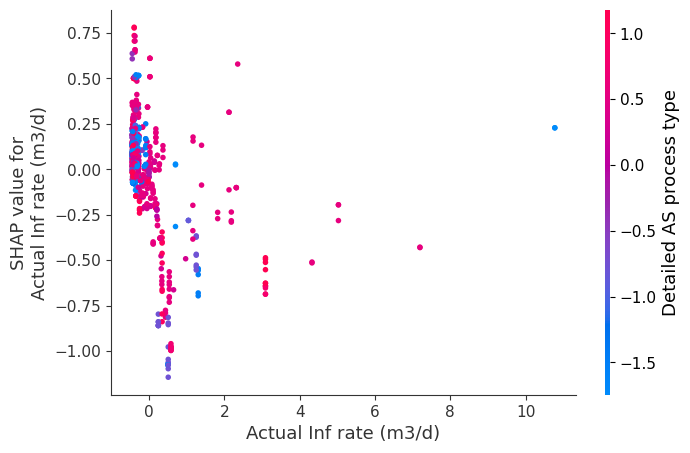

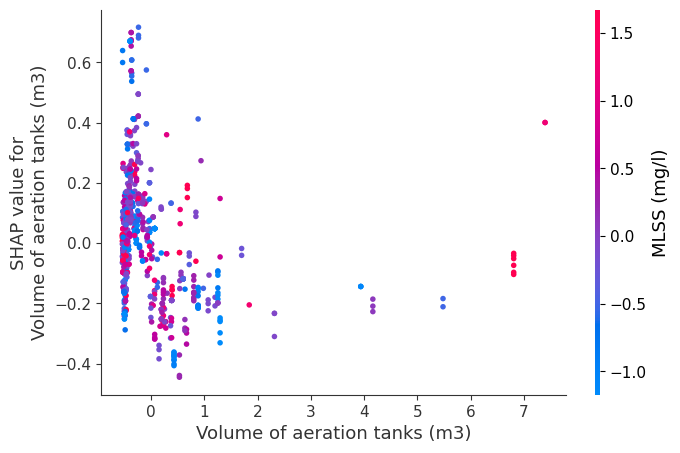

...

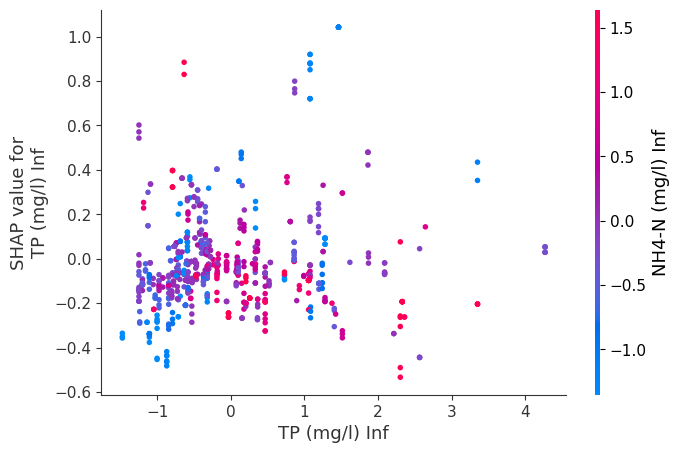

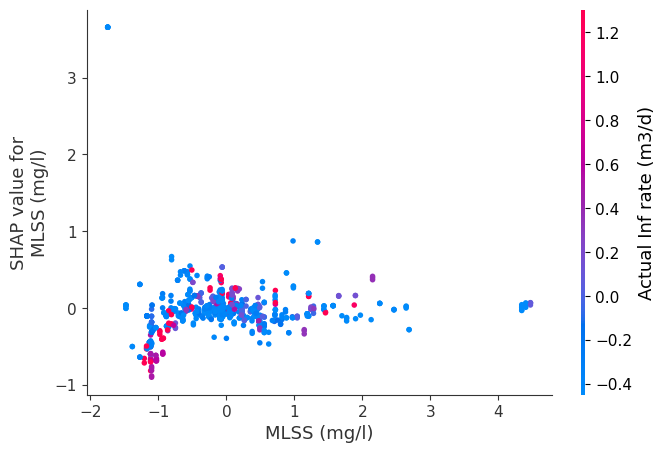

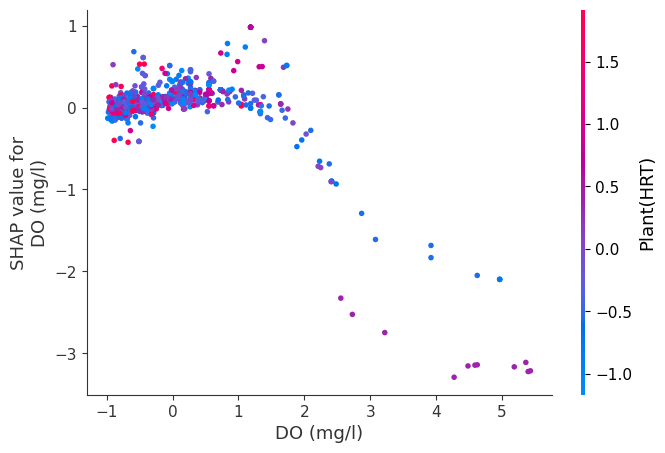

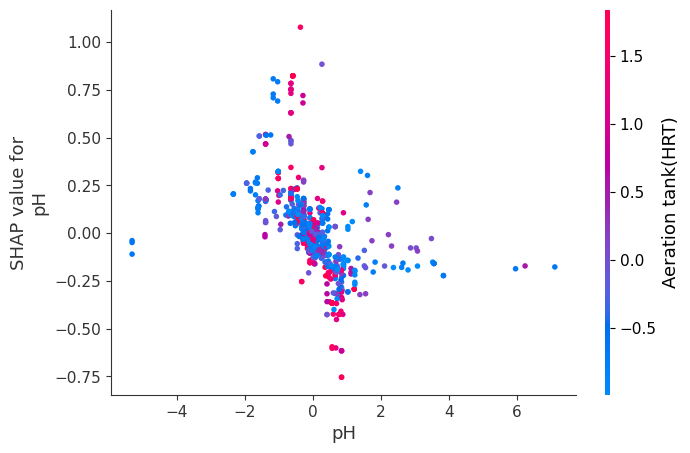

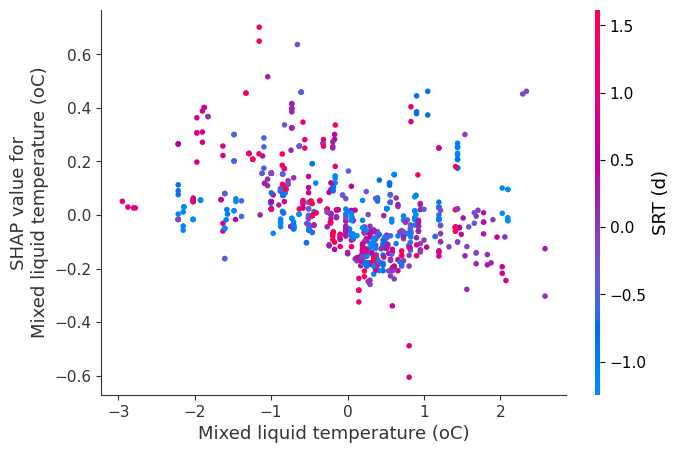


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,2.273181,0.436574,0.593440,14.919462,LinearRegression()
1,Stochastic Gradient Descent Regressor,4.319366,0.430162,0.587195,14.972857,SGDRegressor()
2,Elastic Net Regressor,-0.000898,0.422906,0.600305,-0.572857,ElasticNet()
3,Bayesian Ridge Regressor,4.984454,0.428610,0.585150,15.134651,BayesianRidge()
4,Support Vector Regressor,51.503067,0.249685,0.418049,67.537444,SVR()
5,K-Neighbors Regressor,54.909099,0.274244,0.403102,62.208490,KNeighborsRegressor()
6,Decision Trees Regressor,60.940162,0.227221,0.375176,70.995024,DecisionTreeRegressor()
7,Random Forest Regressor,78.794932,0.182826,0.276433,82.335917,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,75.612983,0.223409,0.296449,74.901606,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,33.964715,0.399966,0.487818,41.874460,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715105.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715105.pkl 

Time Elapsed :  19.52 seconds 



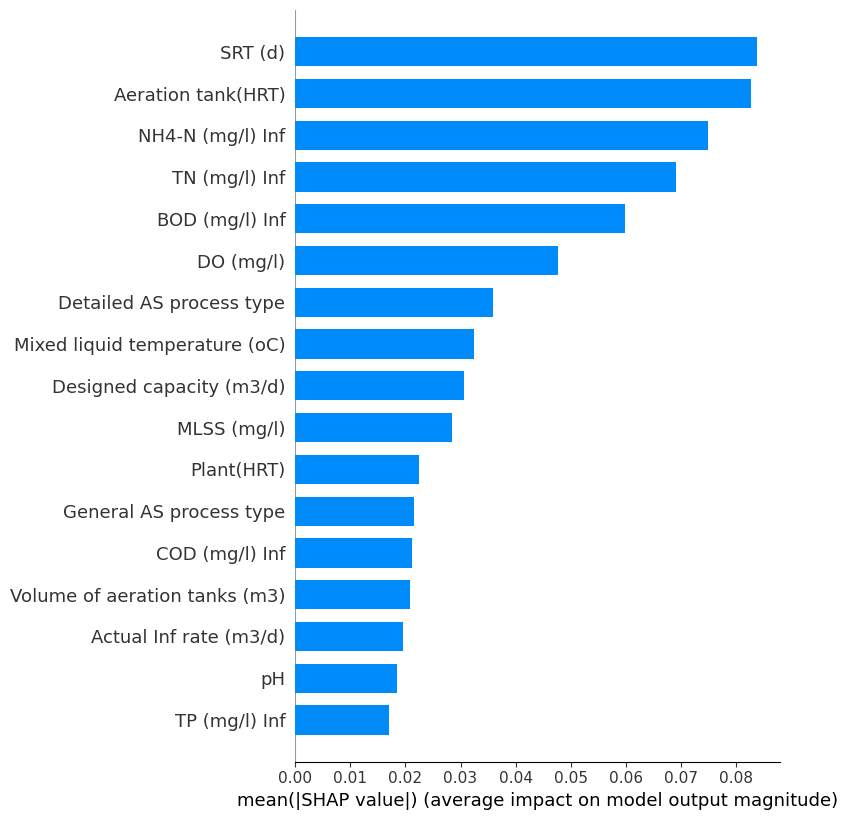

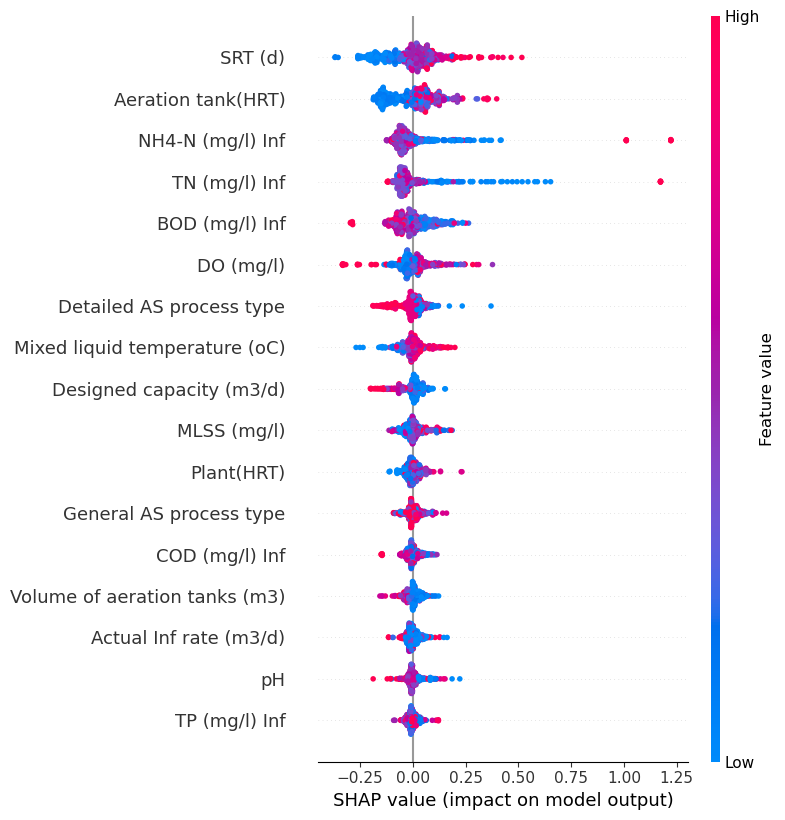

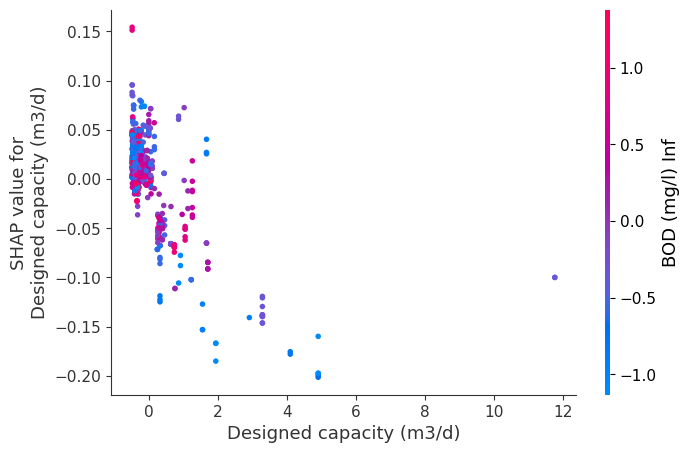

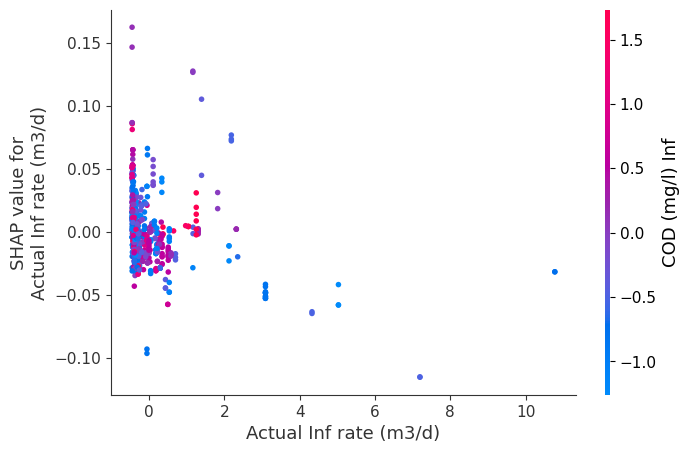

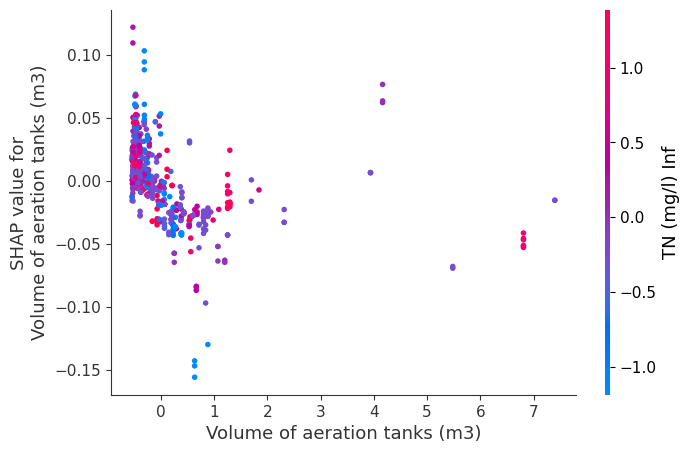

...

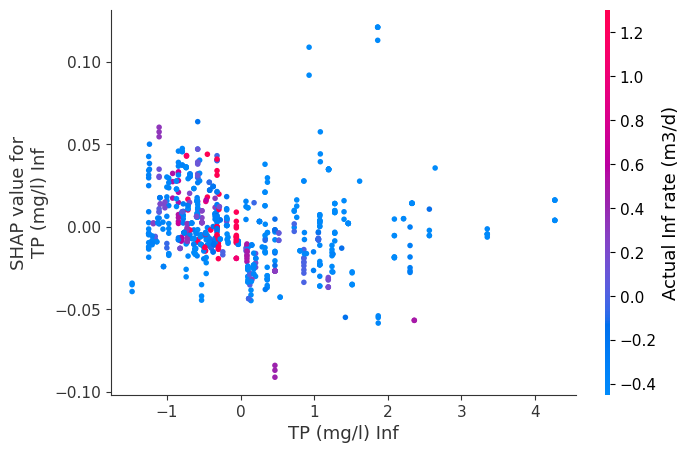

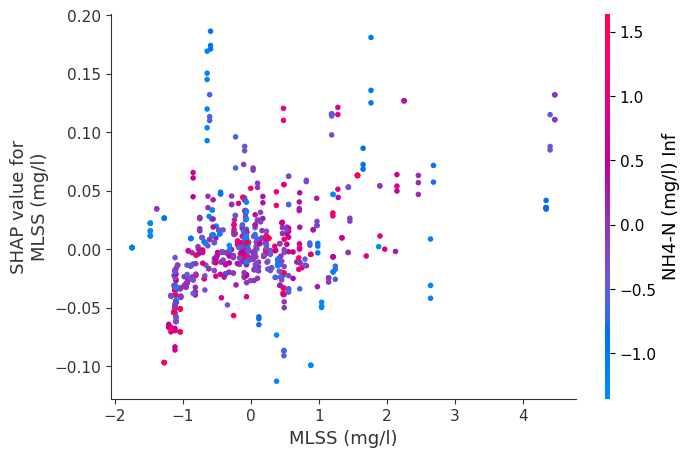

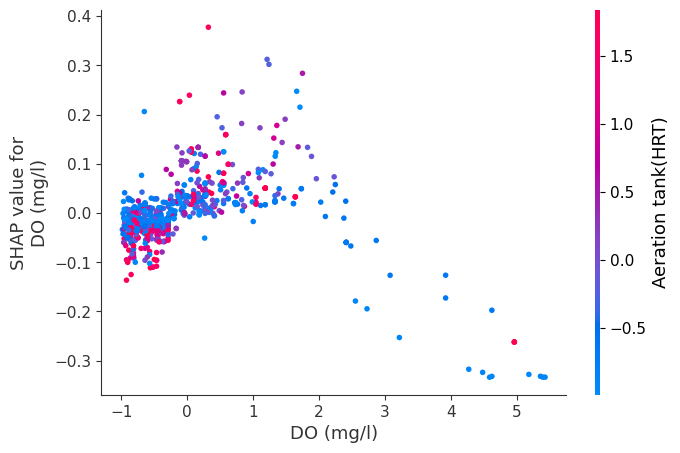

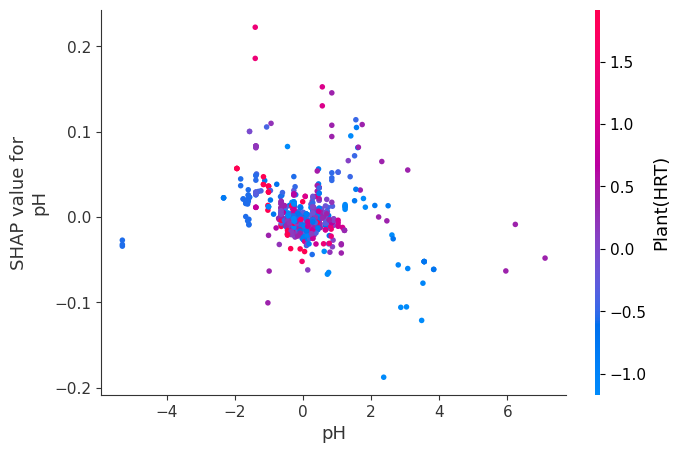

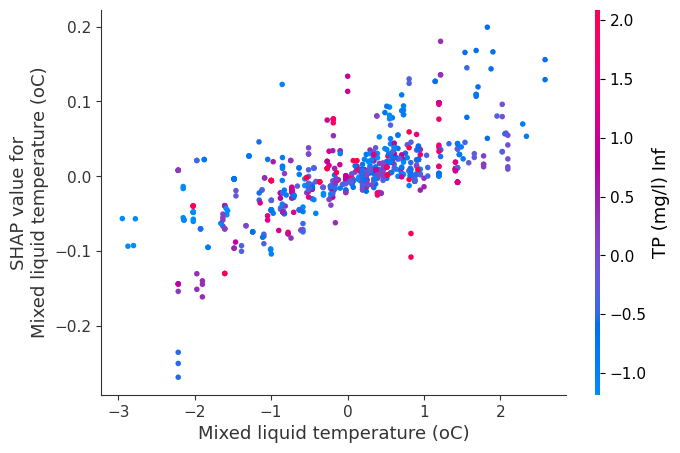


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,17.551029,0.446749,0.594620,11.294863,LinearRegression()
1,Stochastic Gradient Descent Regressor,17.842326,0.449189,0.593569,11.665563,SGDRegressor()
2,Elastic Net Regressor,-0.095240,0.491058,0.655170,-1.485602,ElasticNet()
3,Bayesian Ridge Regressor,16.493609,0.451840,0.598421,11.792834,BayesianRidge()
4,Support Vector Regressor,50.705715,0.282414,0.459775,49.152308,SVR()
5,K-Neighbors Regressor,59.788211,0.279772,0.415263,55.498491,KNeighborsRegressor()
6,Decision Trees Regressor,59.963199,0.212795,0.414359,69.574954,DecisionTreeRegressor()
7,Random Forest Regressor,85.944858,0.160695,0.245507,78.599543,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,75.187615,0.229050,0.326198,71.540955,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,48.874097,0.388286,0.468239,40.059039,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715137.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715137.pkl 

Time Elapsed :  19.22 seconds 



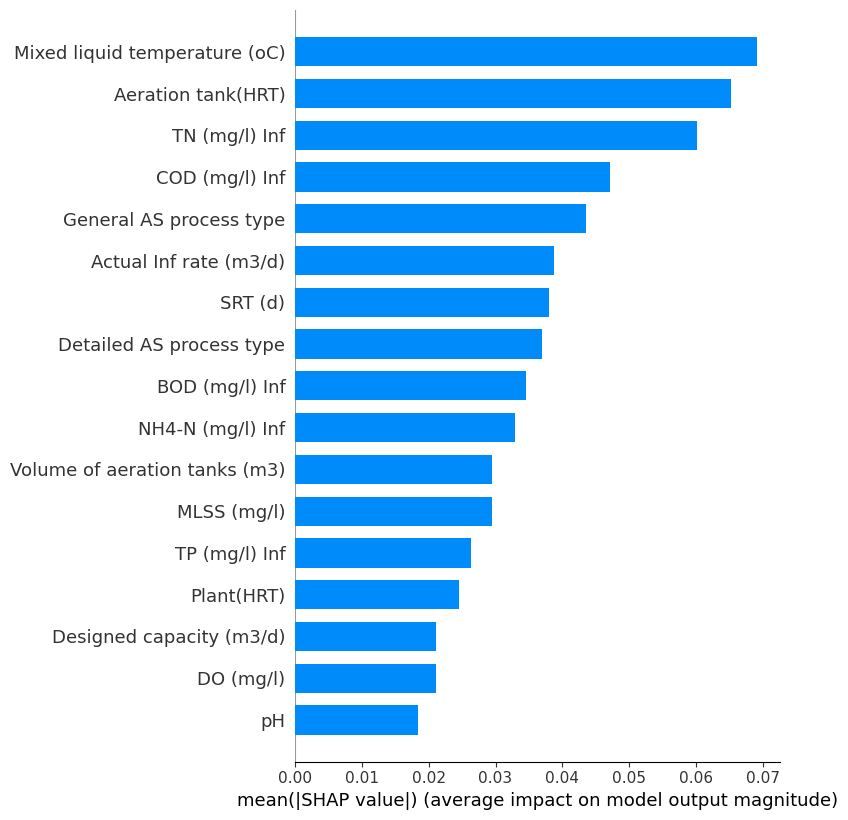

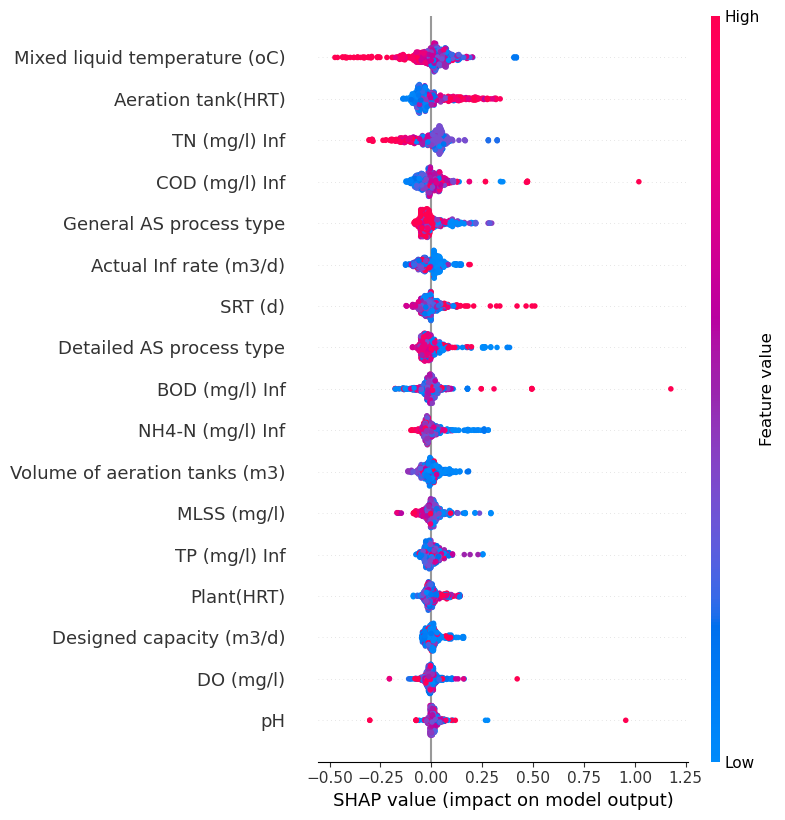

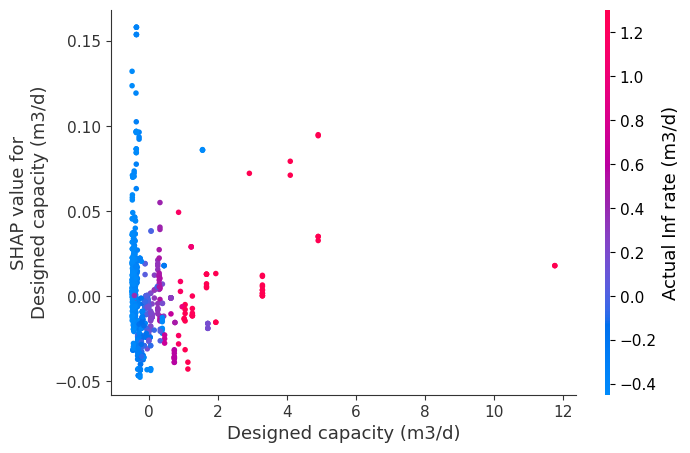

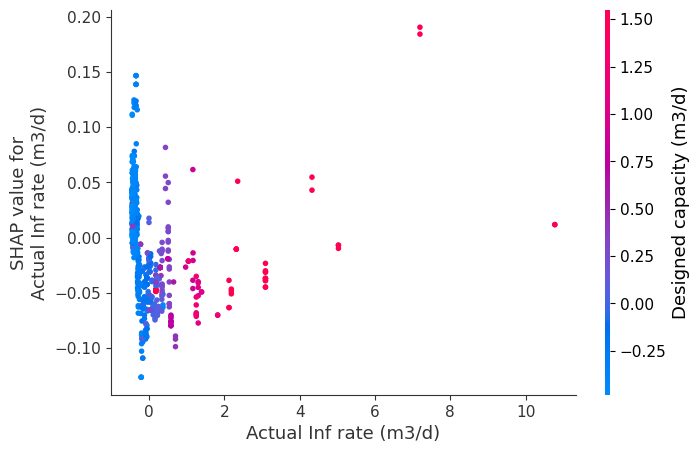

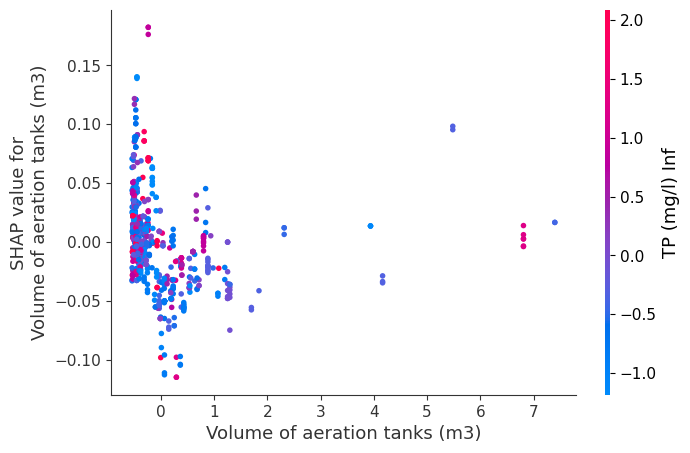

...

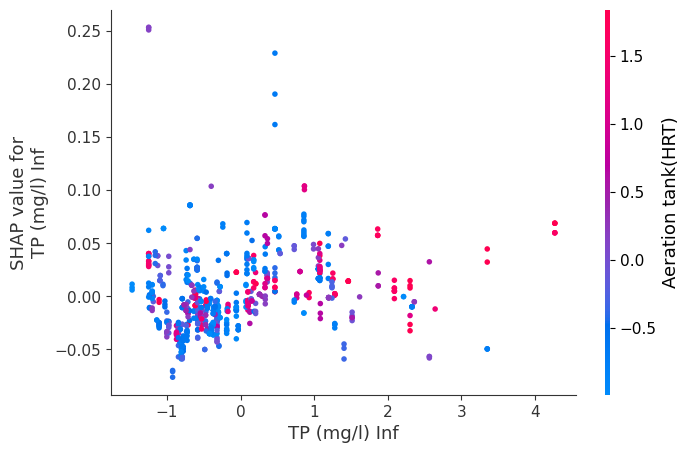

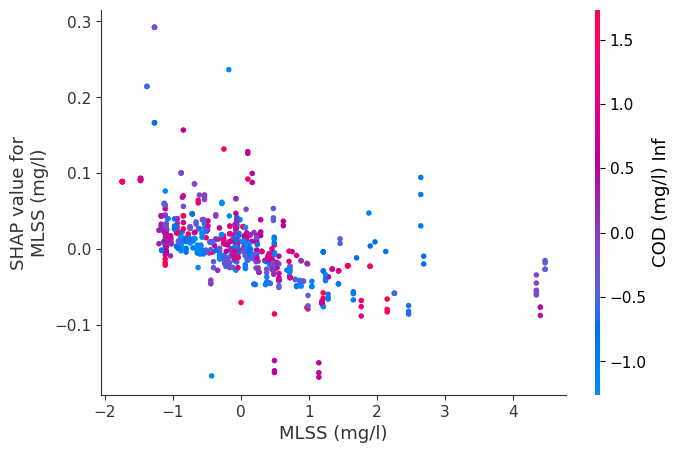

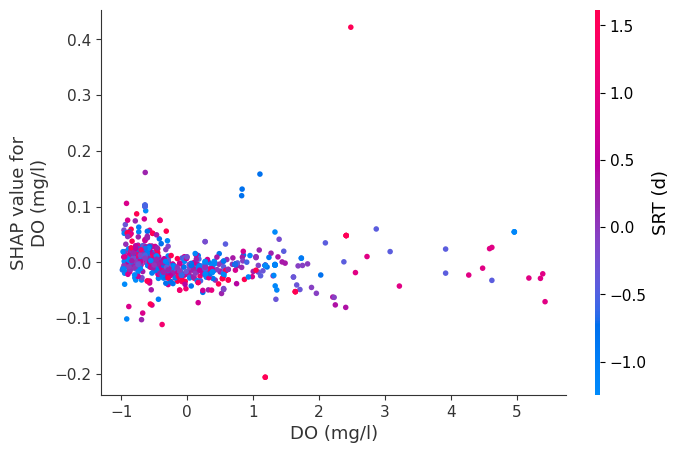

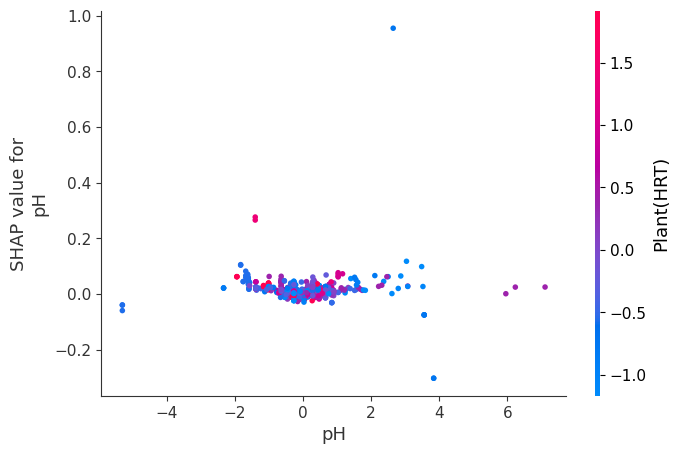

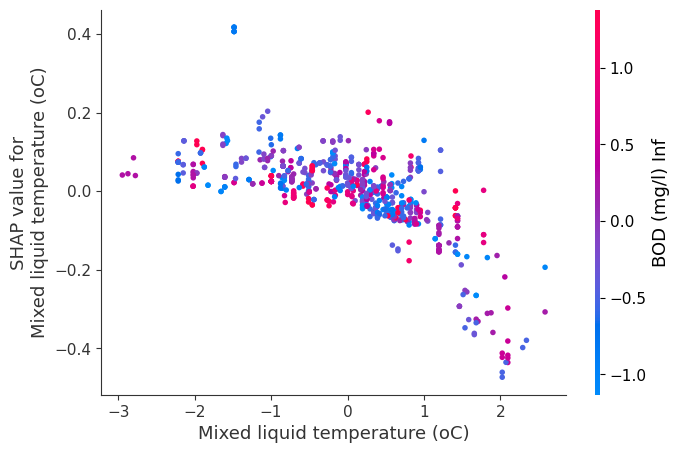


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,9.830946,0.341744,0.466650,14.415933,LinearRegression()
1,Stochastic Gradient Descent Regressor,8.167039,0.342736,0.470936,14.460717,SGDRegressor()
2,Elastic Net Regressor,-0.719683,0.338819,0.493196,-0.569393,ElasticNet()
3,Bayesian Ridge Regressor,9.250186,0.339599,0.468150,14.319419,BayesianRidge()
4,Support Vector Regressor,57.420984,0.187975,0.320671,63.031054,SVR()
5,K-Neighbors Regressor,38.029389,0.231369,0.386861,56.818770,KNeighborsRegressor()
6,Decision Trees Regressor,64.089210,0.149264,0.294493,83.027418,DecisionTreeRegressor()
7,Random Forest Regressor,75.150246,0.139099,0.244976,83.408907,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,66.728199,0.184492,0.283466,76.081464,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,47.759201,0.278881,0.355195,48.935923,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715171.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715171.pkl 

Time Elapsed :  20.78 seconds 



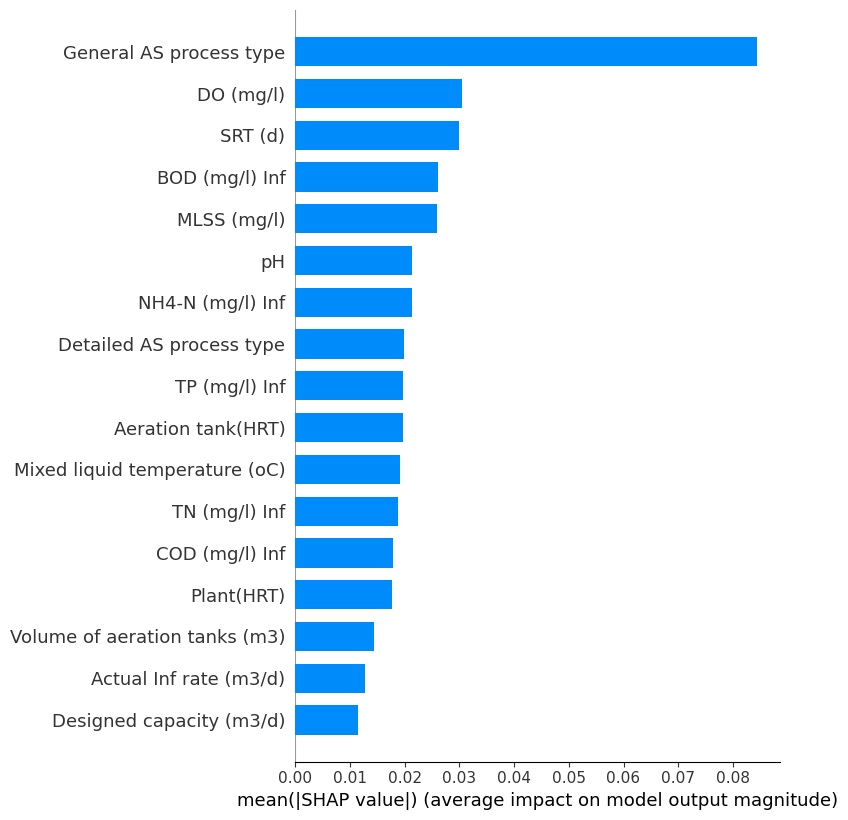

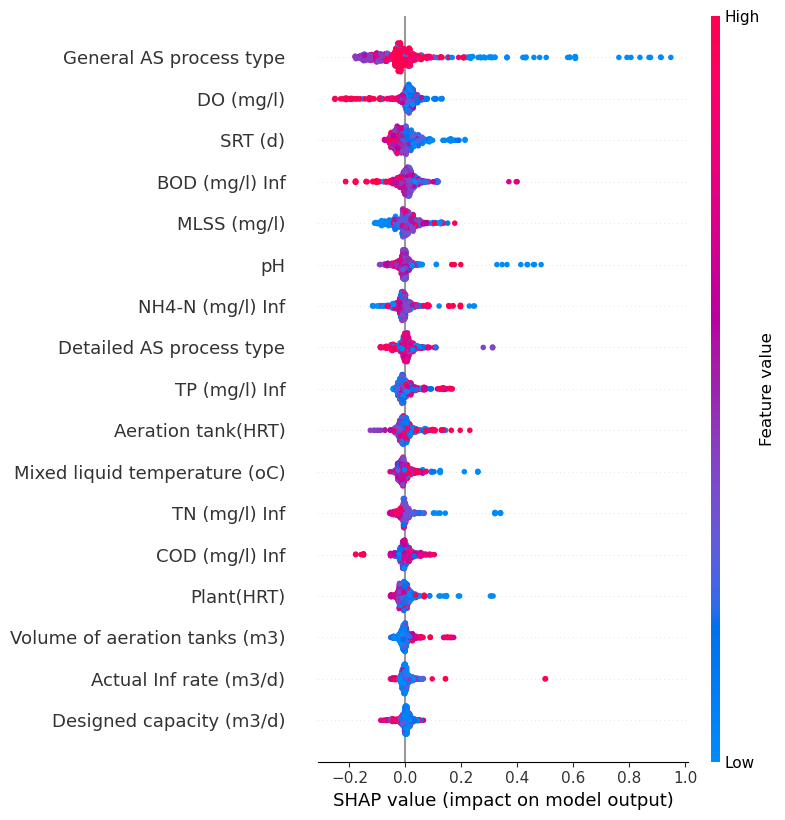

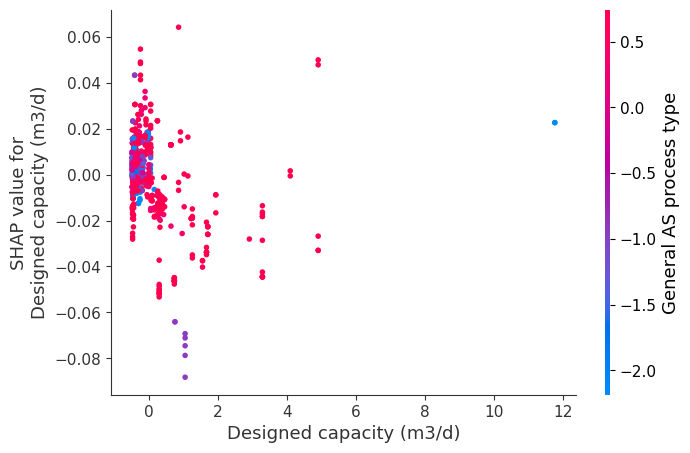

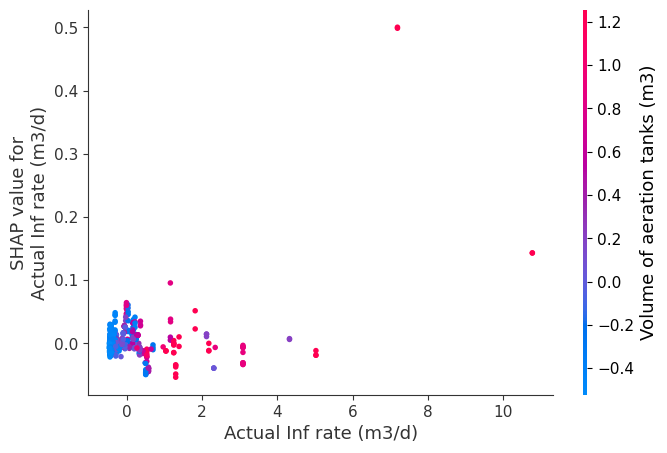

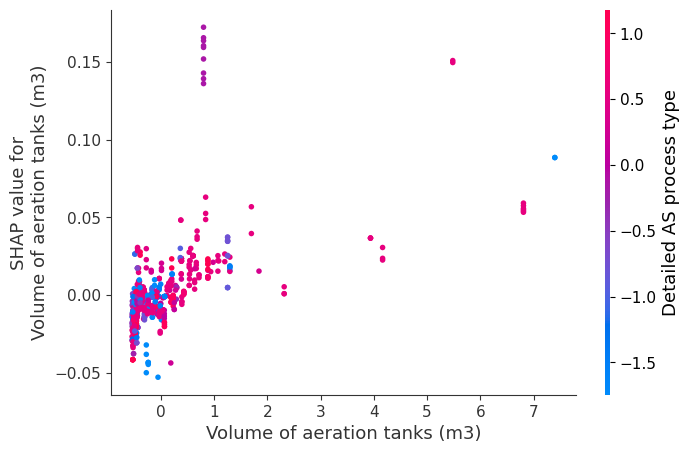

...

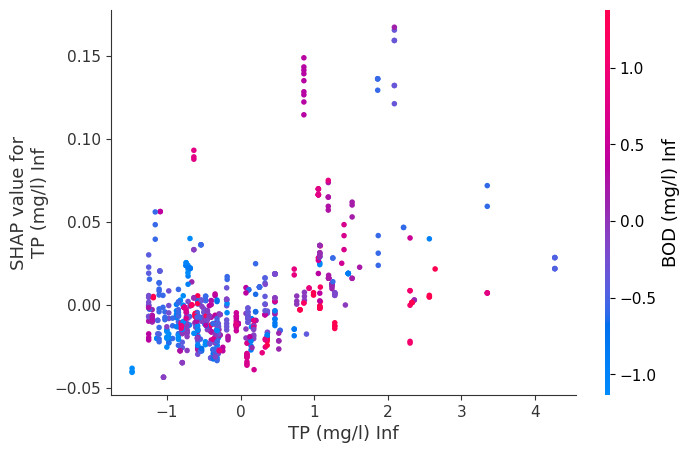

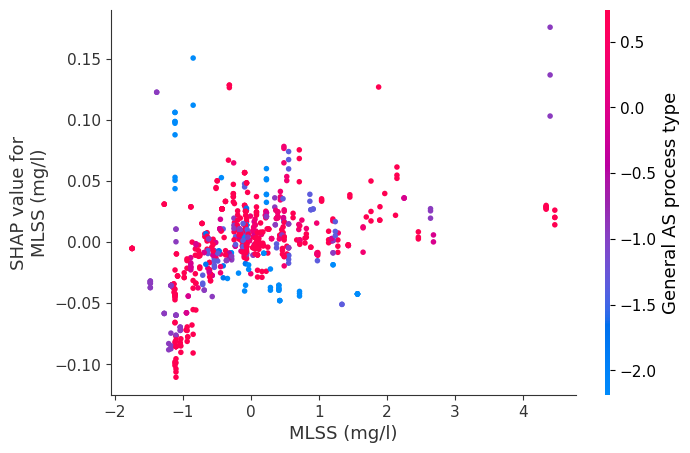

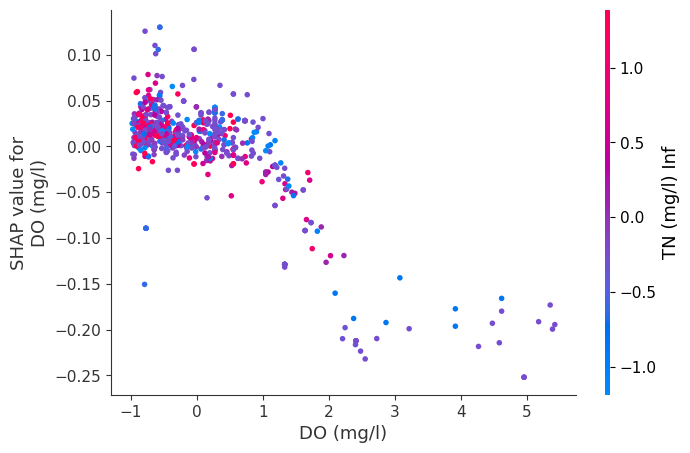

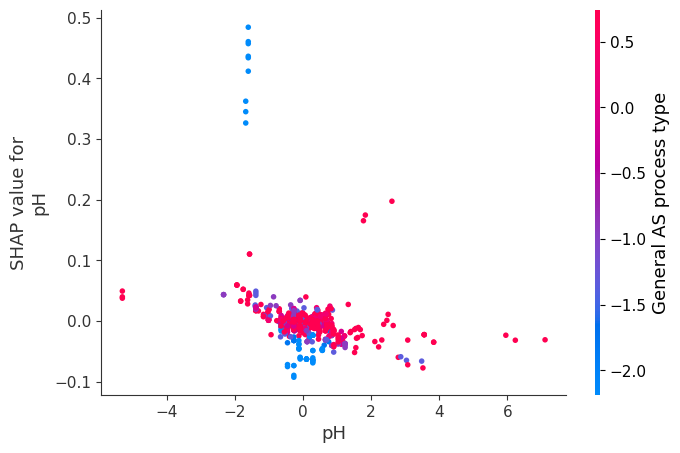

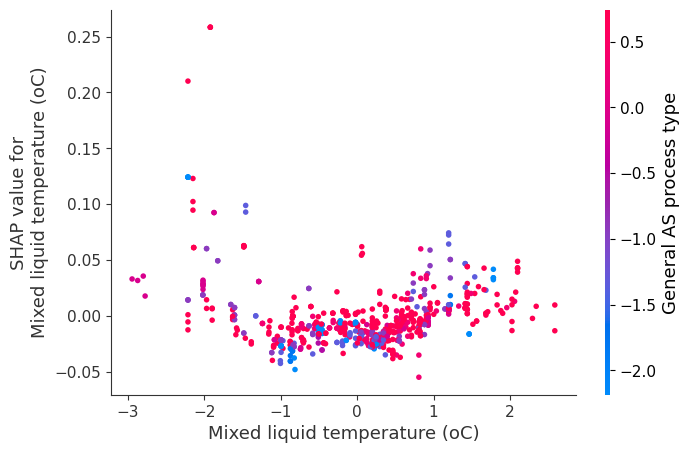


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,13.439999,0.260454,0.368682,8.951568,LinearRegression()
1,Stochastic Gradient Descent Regressor,14.444244,0.259826,0.366537,7.540889,SGDRegressor()
2,Elastic Net Regressor,-0.557554,0.283279,0.397375,-2.722615,ElasticNet()
3,Bayesian Ridge Regressor,14.905340,0.255187,0.365548,9.986482,BayesianRidge()
4,Support Vector Regressor,50.431818,0.166419,0.278994,47.964171,SVR()
5,K-Neighbors Regressor,19.548008,0.208585,0.355436,43.229362,KNeighborsRegressor()
6,Decision Trees Regressor,77.059661,0.105923,0.189799,70.765729,DecisionTreeRegressor()
7,Random Forest Regressor,85.684829,0.104697,0.149931,83.281901,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,76.690804,0.140465,0.191319,77.856081,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,49.699885,0.243622,0.281046,51.869571,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Catboost_Regressor_1691715208.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Catboost_Regressor_Scaler_1691715208.pkl 

Time Elapsed :  21.55 seconds 



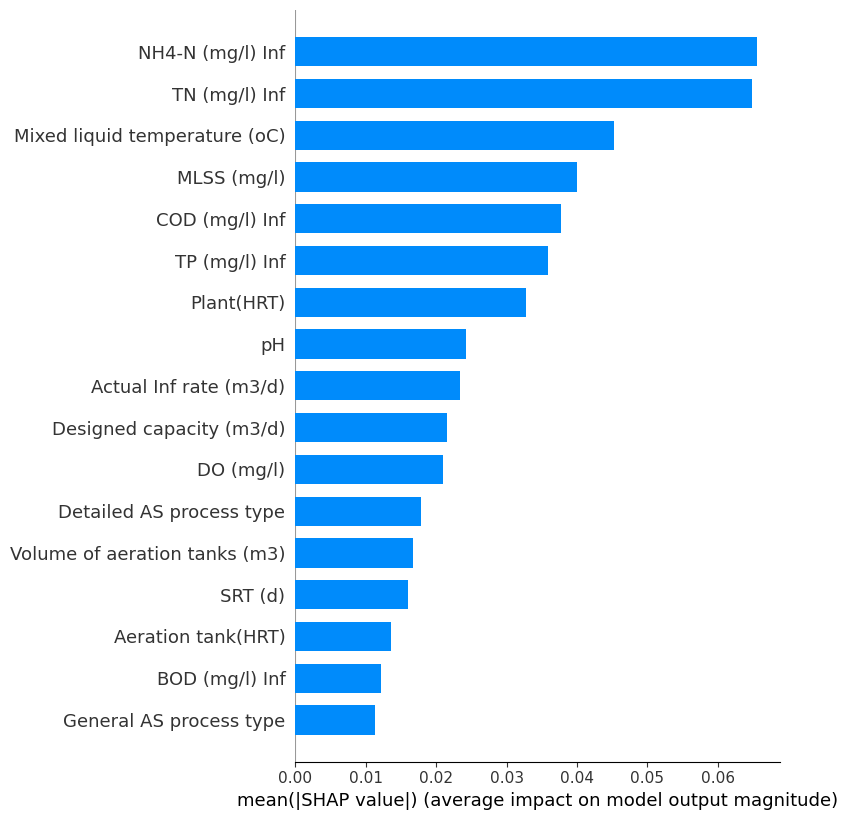

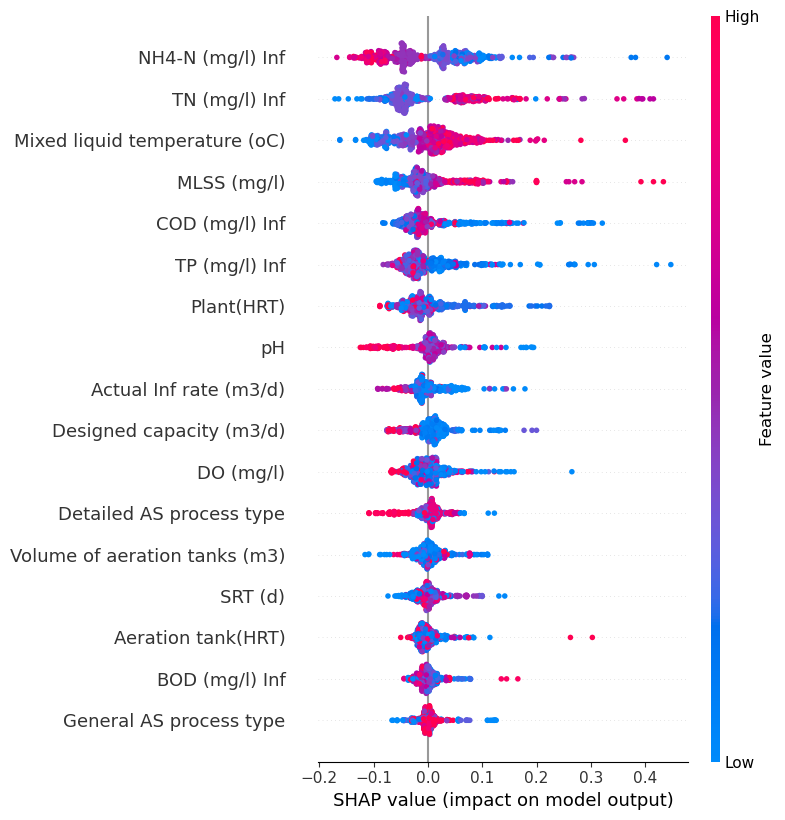

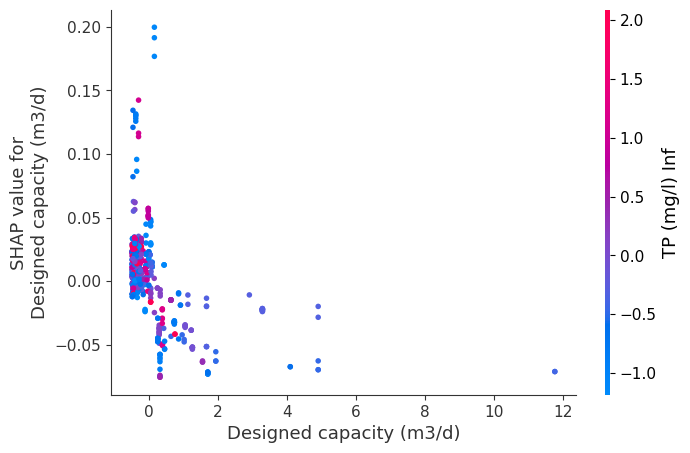

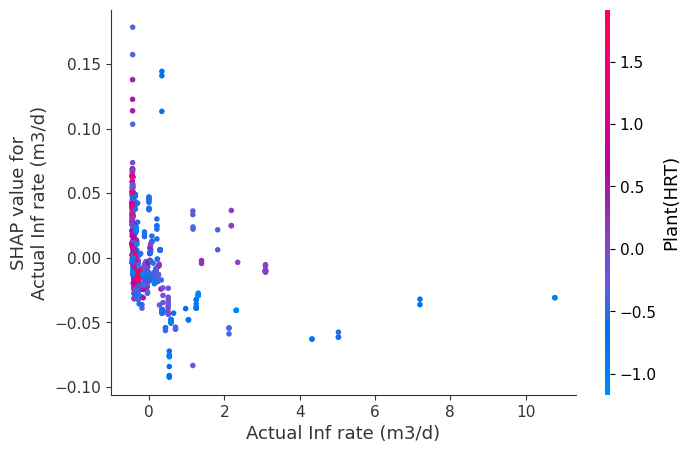

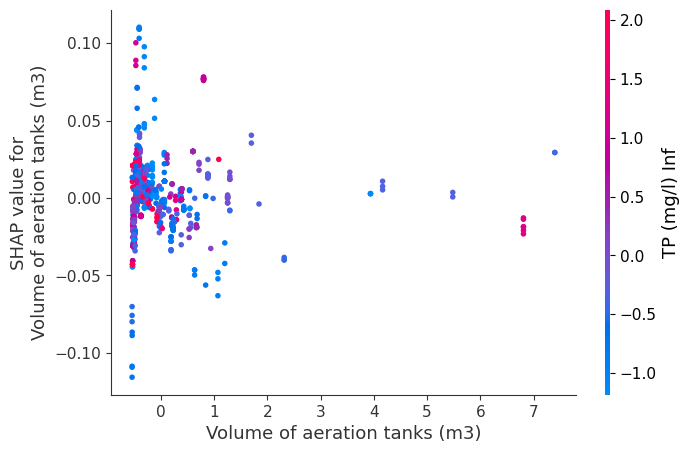

...

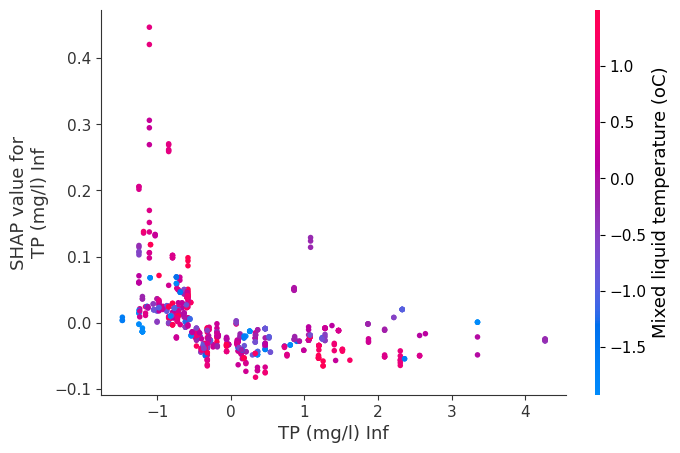

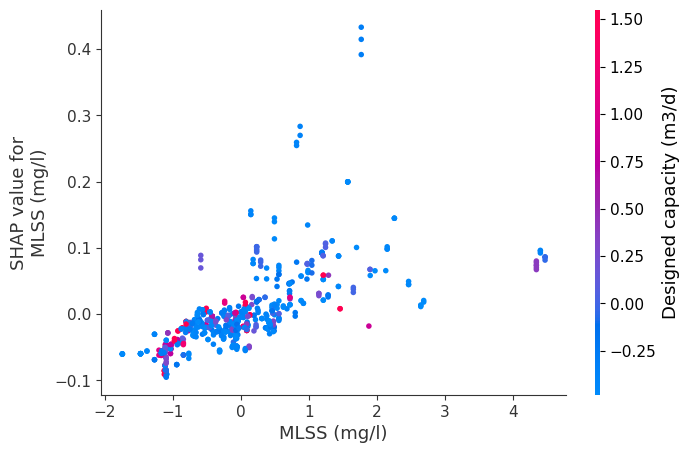

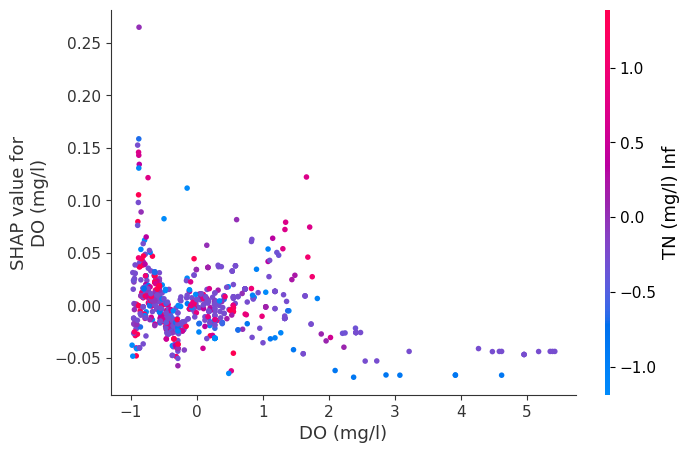

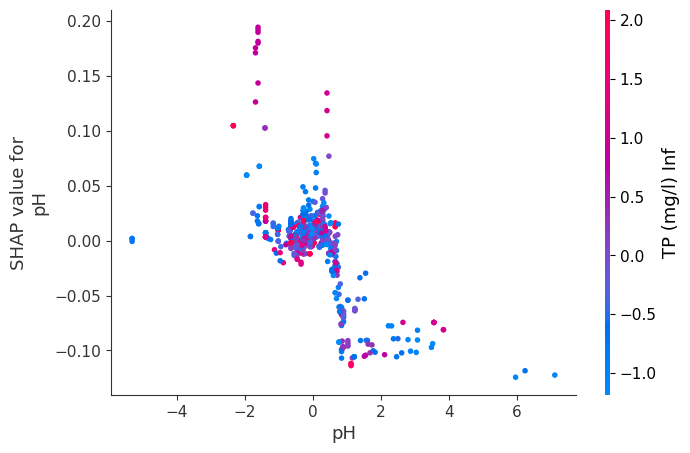

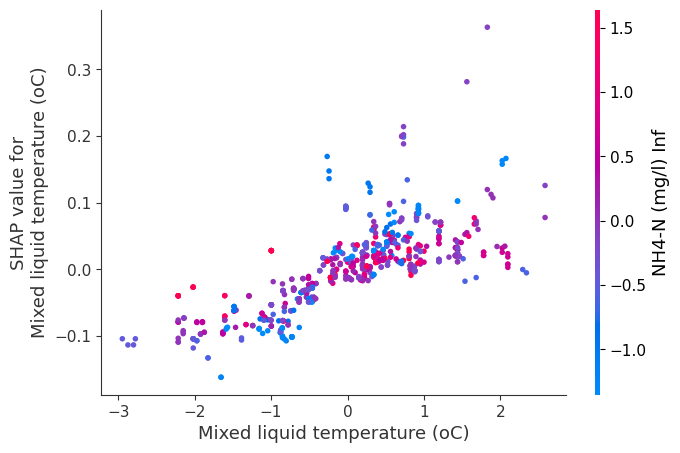


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,3.599696,0.173911,0.222547,7.137758,LinearRegression()
1,Stochastic Gradient Descent Regressor,2.925076,0.175088,0.223324,6.523783,SGDRegressor()
2,Elastic Net Regressor,-0.215151,0.167978,0.226908,-2.036235,ElasticNet()
3,Bayesian Ridge Regressor,4.855180,0.171770,0.221093,7.305830,BayesianRidge()
4,Support Vector Regressor,66.252850,0.093166,0.131674,60.568364,SVR()
5,K-Neighbors Regressor,41.259909,0.115230,0.173720,33.465596,KNeighborsRegressor()
6,Decision Trees Regressor,63.023946,0.070606,0.137830,60.824753,DecisionTreeRegressor()
7,Random Forest Regressor,68.900481,0.073986,0.126403,71.934457,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,66.134829,0.090663,0.131904,67.522192,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,-6.125281,0.168743,0.233503,15.131252,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/LightGBM_Regressor_1691715232.pkl and its scaler to lucifer_ml_info/best/regression/scalers/LightGBM_Regressor_Scaler_1691715232.pkl 

Time Elapsed :  20.66 seconds 



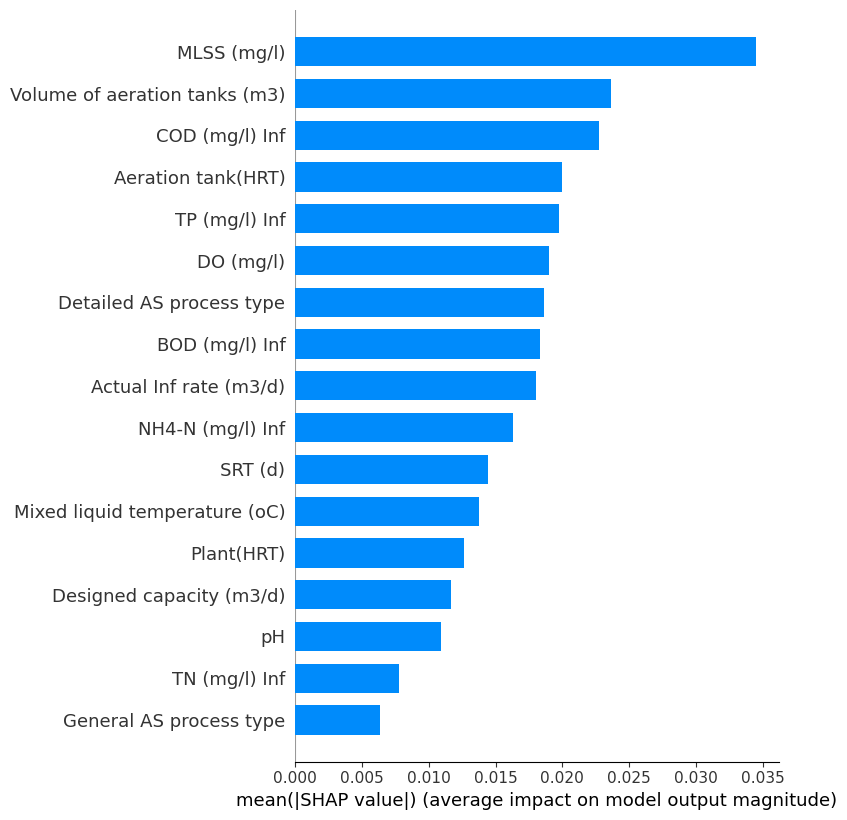

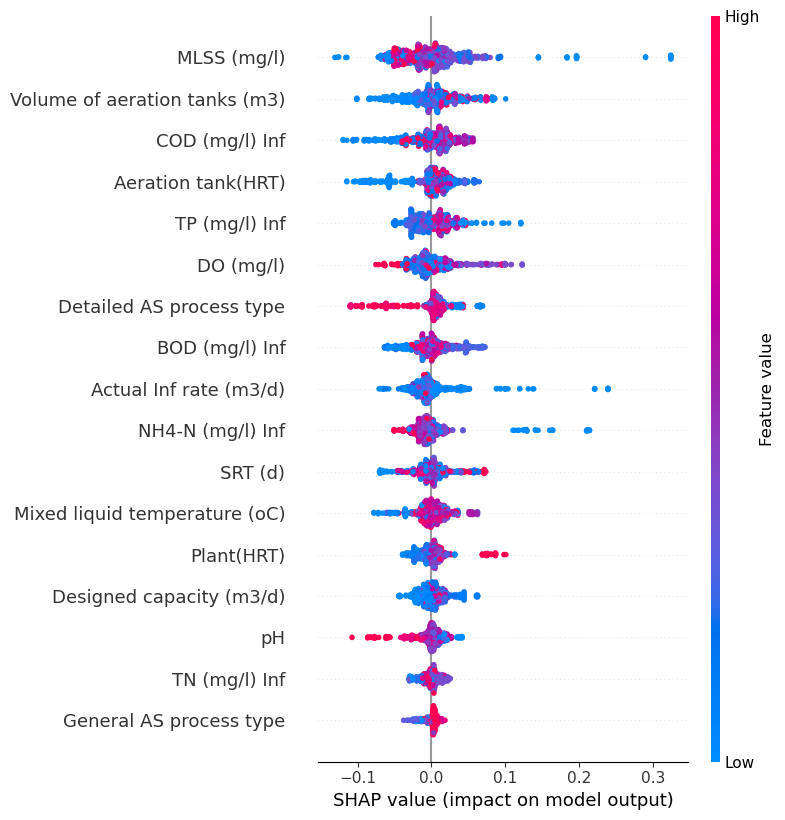

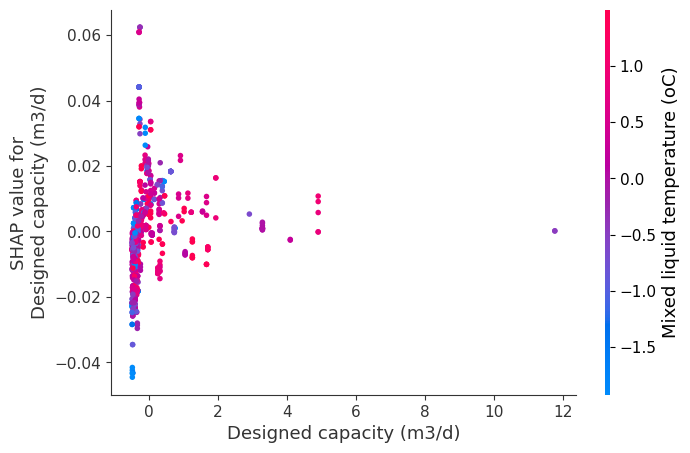

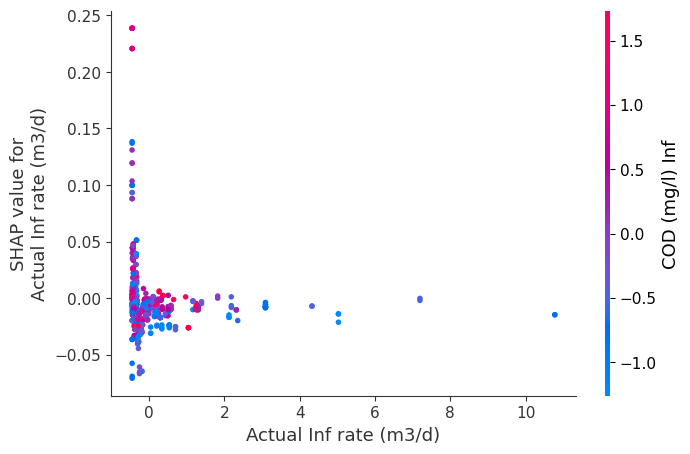

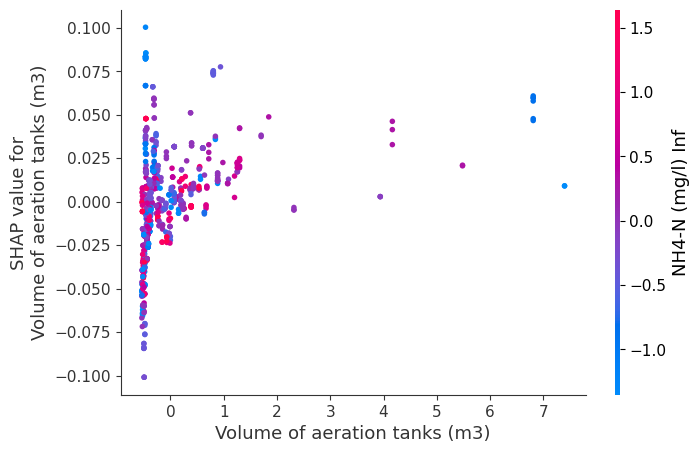

...

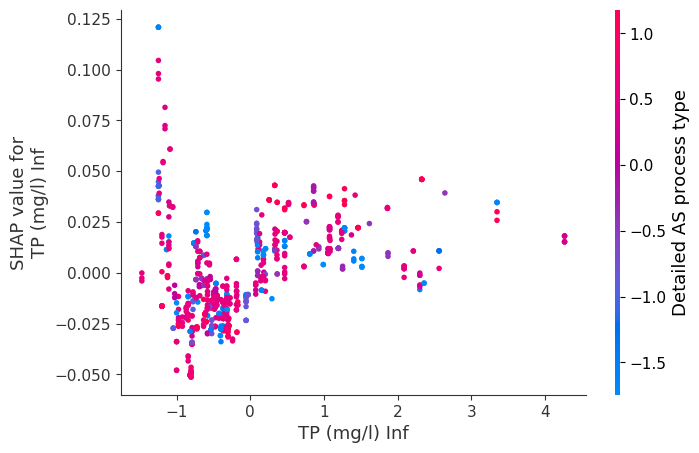

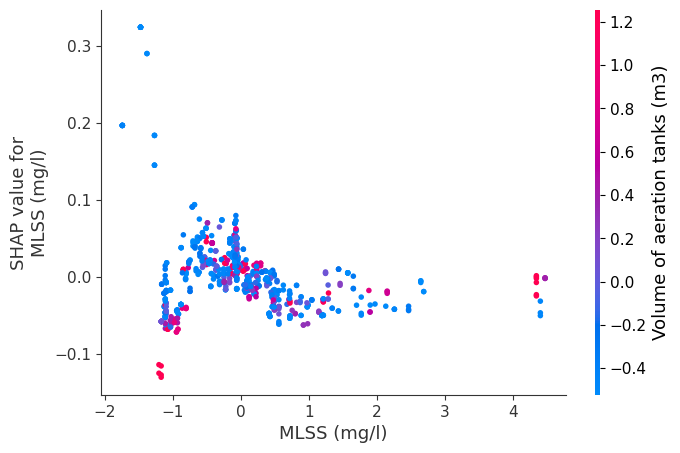

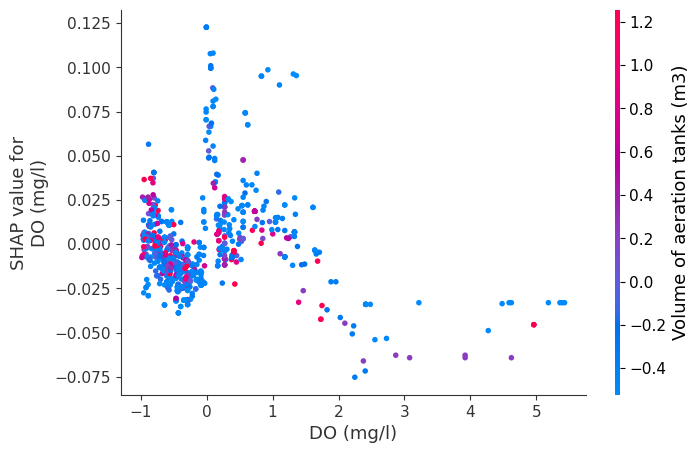

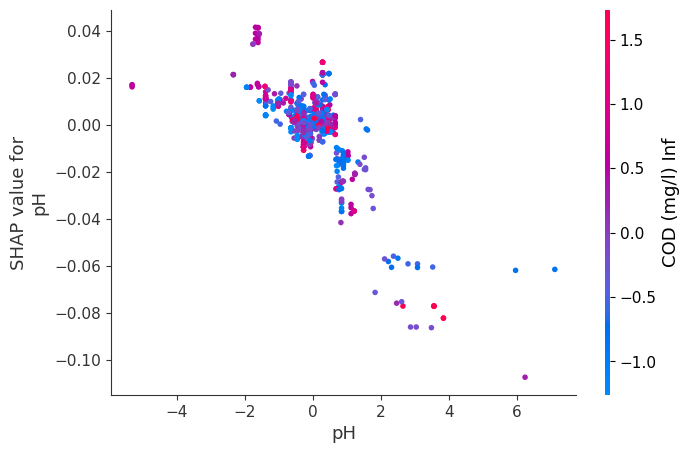

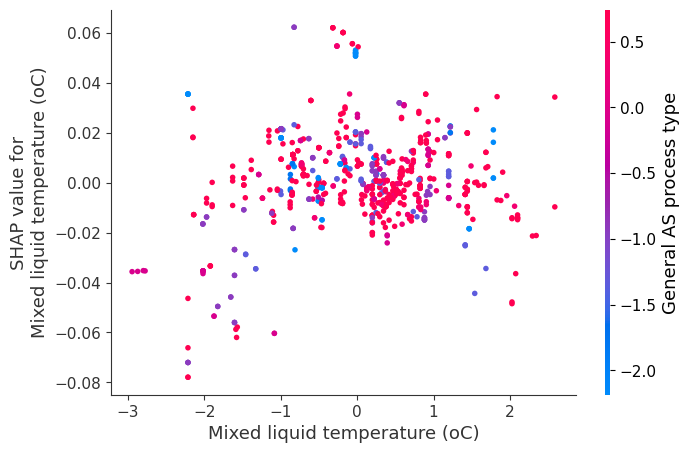


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,23.277633,0.345370,0.462598,23.051526,LinearRegression()
1,Stochastic Gradient Descent Regressor,23.517360,0.345617,0.461875,22.750508,SGDRegressor()
2,Elastic Net Regressor,-3.326649,0.401677,0.536845,-2.406645,ElasticNet()
3,Bayesian Ridge Regressor,23.660749,0.344625,0.461441,23.679682,BayesianRidge()
4,Support Vector Regressor,59.826908,0.215326,0.334742,67.795952,SVR()
5,K-Neighbors Regressor,54.626319,0.230371,0.355750,50.629567,KNeighborsRegressor()
6,Decision Trees Regressor,77.379889,0.146865,0.251183,74.938489,DecisionTreeRegressor()
7,Random Forest Regressor,80.730138,0.145704,0.231837,79.903546,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,75.916464,0.184682,0.259181,75.553325,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,47.914027,0.332661,0.381156,32.414509,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Extra_Trees_Regressor_1691715256.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Extra_Trees_Regressor_Scaler_1691715256.pkl 

Time Elapsed :  20.77 seconds 



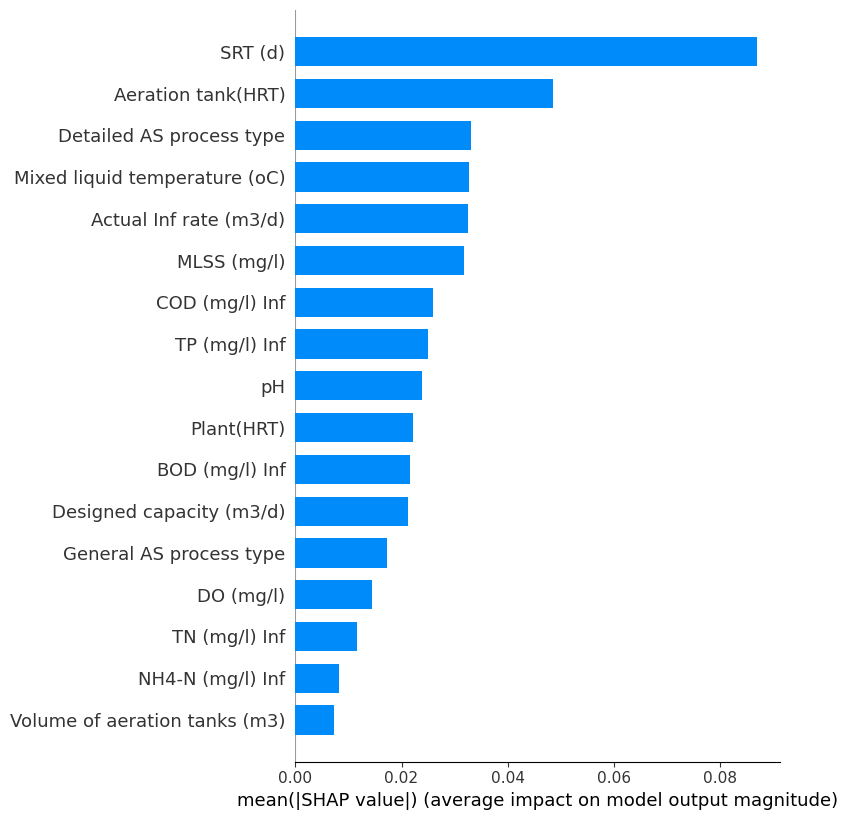

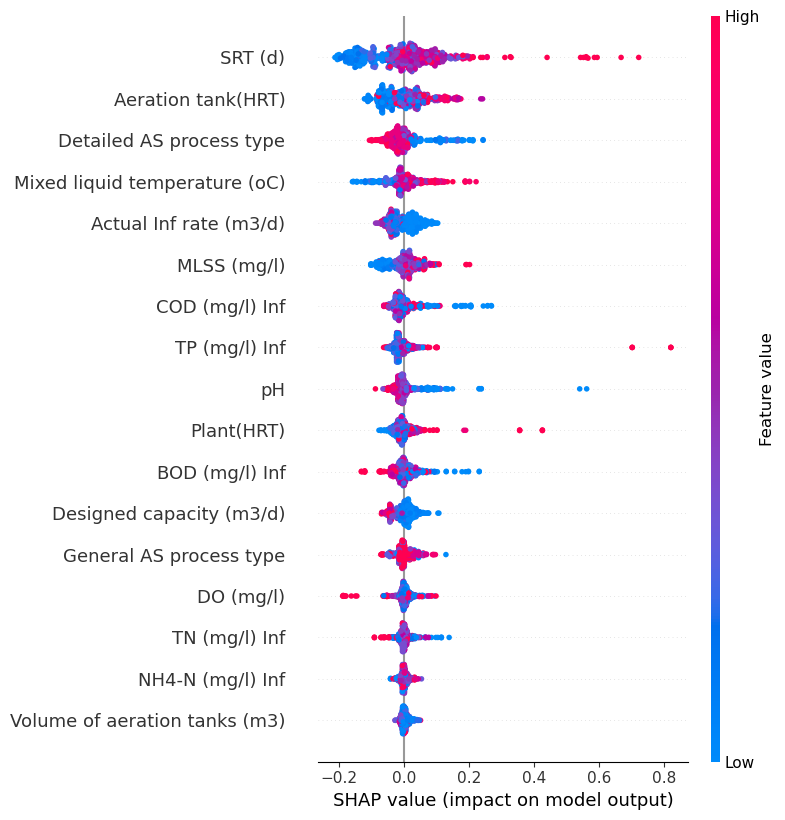

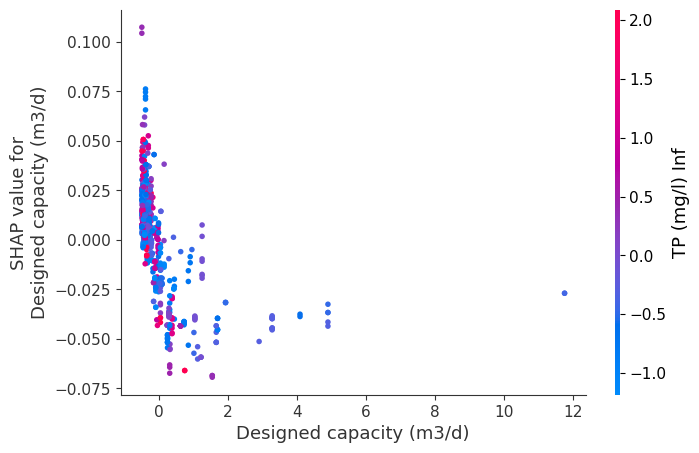

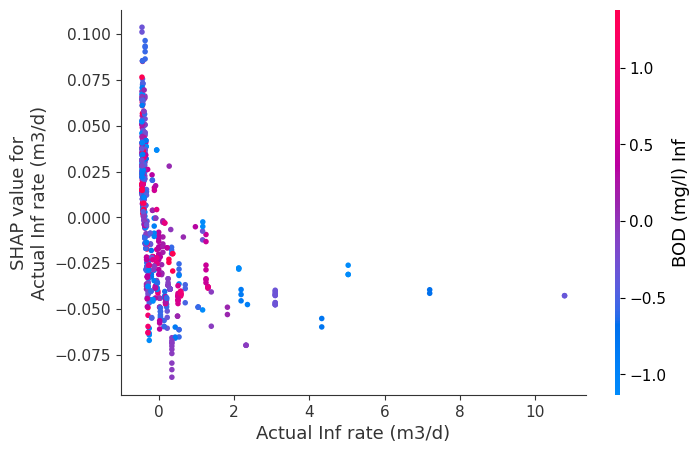

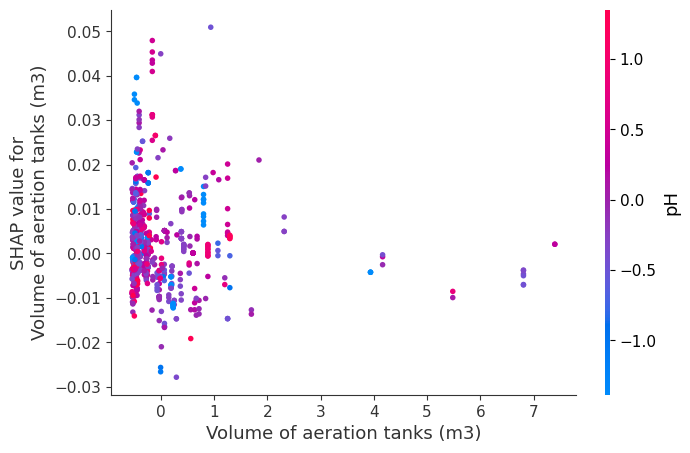

...

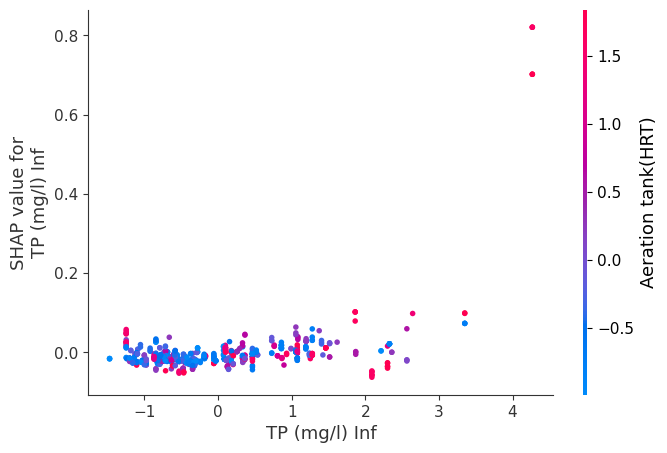

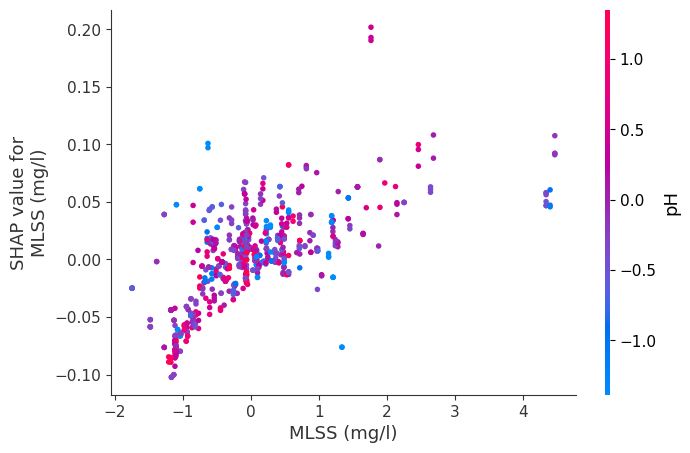

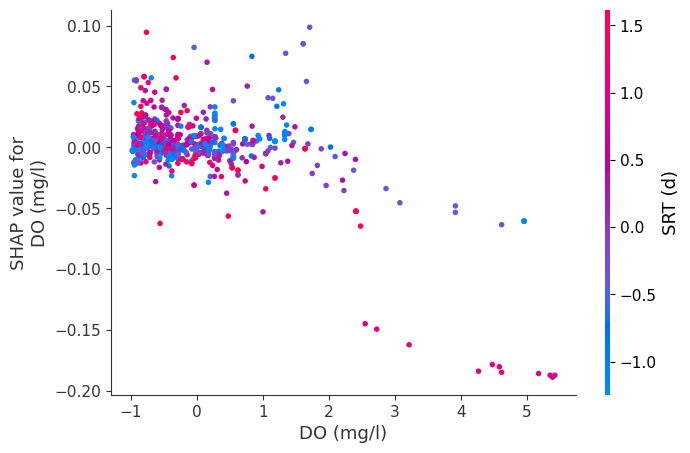

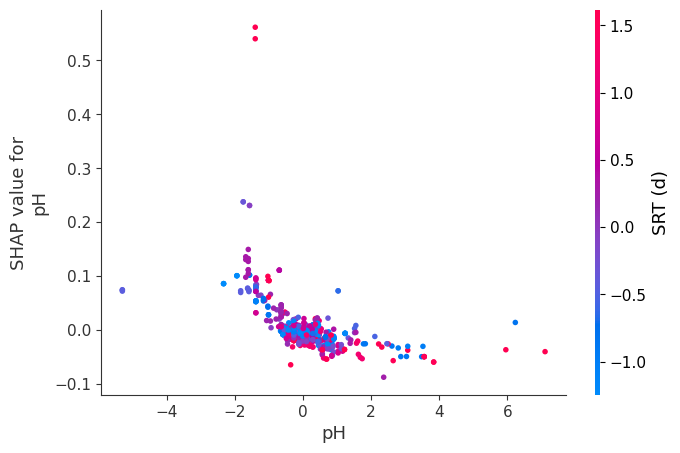

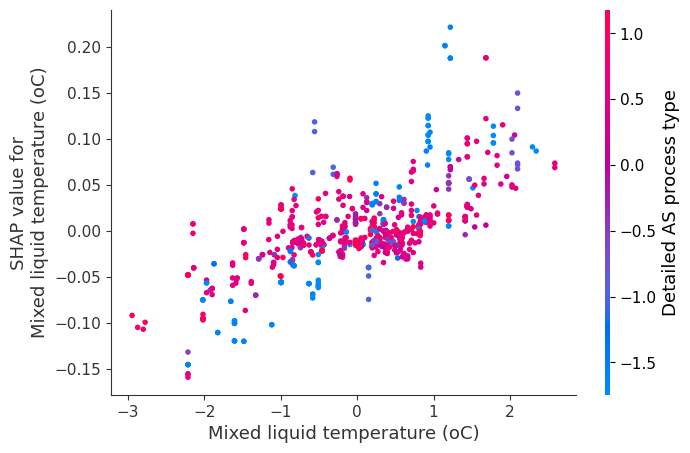


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,-16.625769,0.276151,0.333830,5.770155,LinearRegression()
1,Stochastic Gradient Descent Regressor,-17.431791,0.276679,0.334982,5.277489,SGDRegressor()
2,Elastic Net Regressor,-8.514323,0.260644,0.322012,-1.303586,ElasticNet()
3,Bayesian Ridge Regressor,-10.223676,0.269064,0.324538,7.354983,BayesianRidge()
4,Support Vector Regressor,55.433338,0.134284,0.206364,54.496984,SVR()
5,K-Neighbors Regressor,20.481623,0.167986,0.275653,39.916503,KNeighborsRegressor()
6,Decision Trees Regressor,24.724021,0.124833,0.268199,63.945076,DecisionTreeRegressor()
7,Random Forest Regressor,69.428490,0.108290,0.170918,73.923388,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,64.500898,0.136375,0.184178,69.520100,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,-12.423176,0.281014,0.327761,31.305518,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Catboost_Regressor_1691715290.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Catboost_Regressor_Scaler_1691715290.pkl 

Time Elapsed :  21.32 seconds 



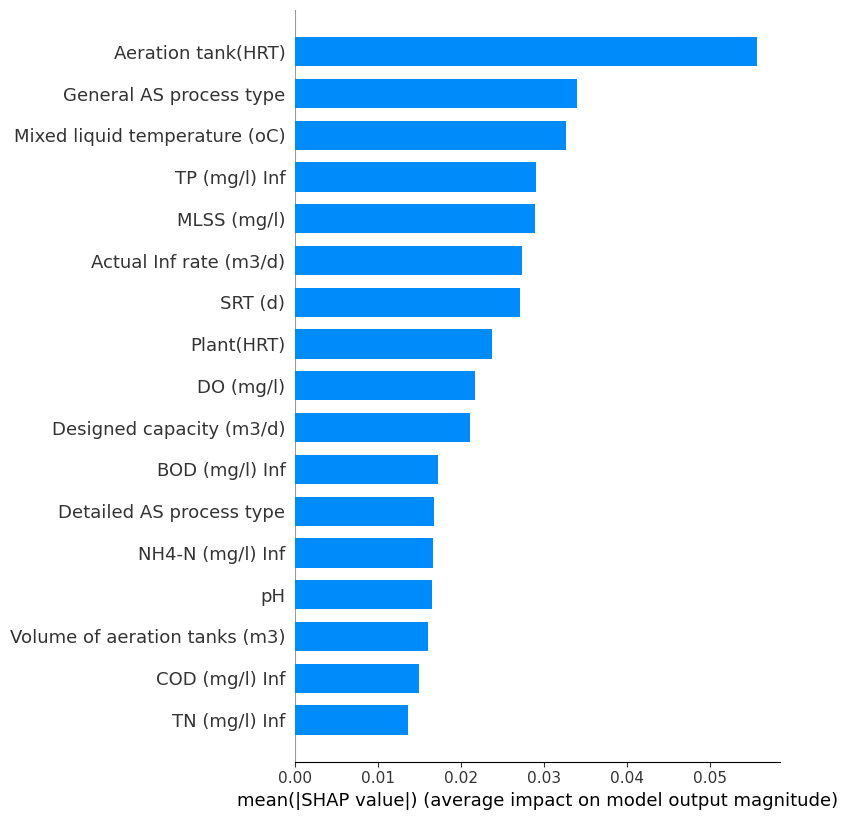

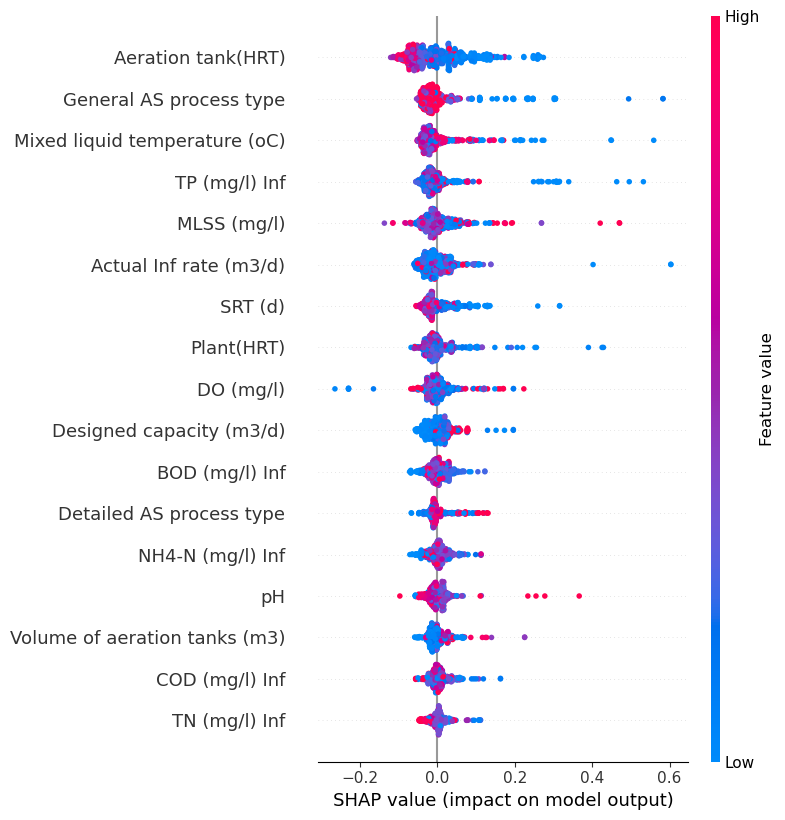

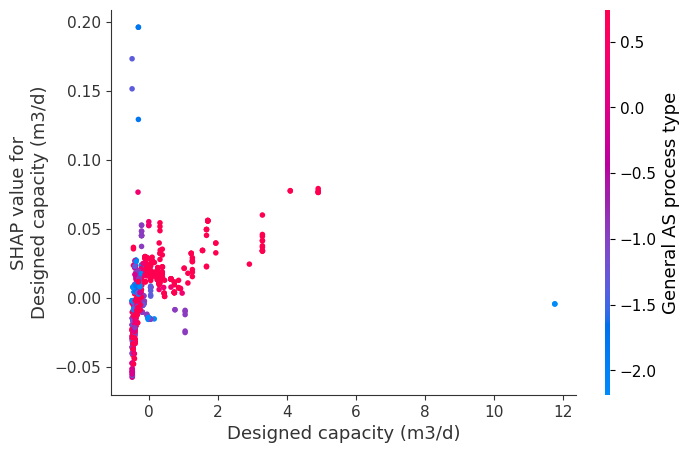

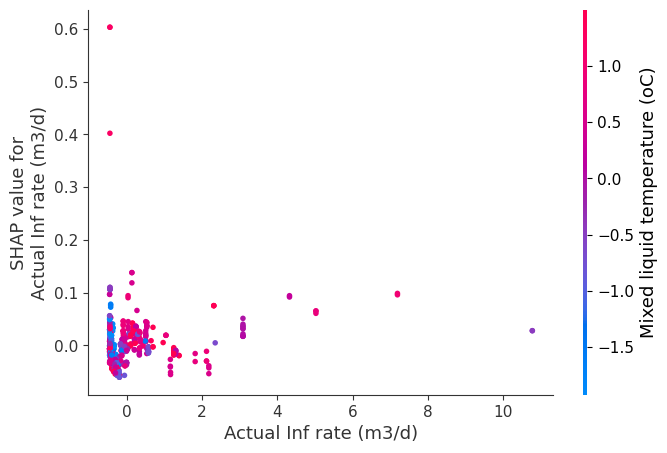

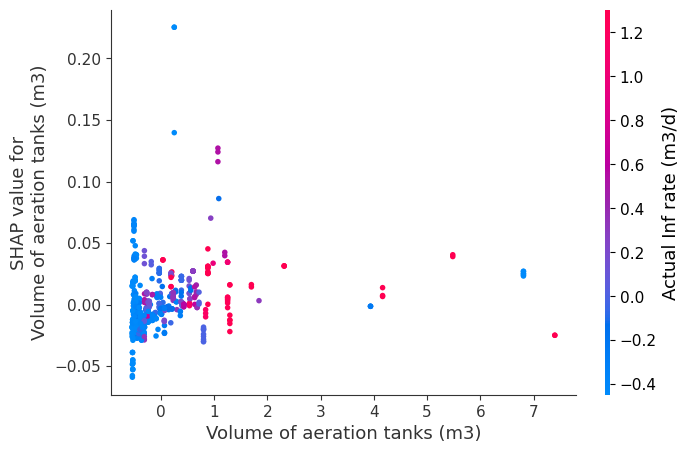

...

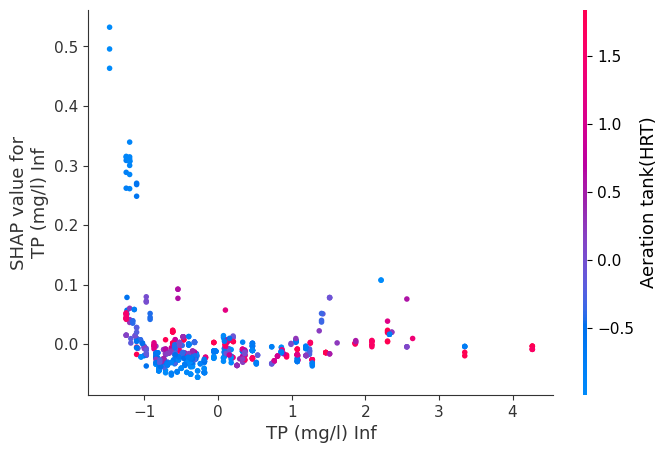

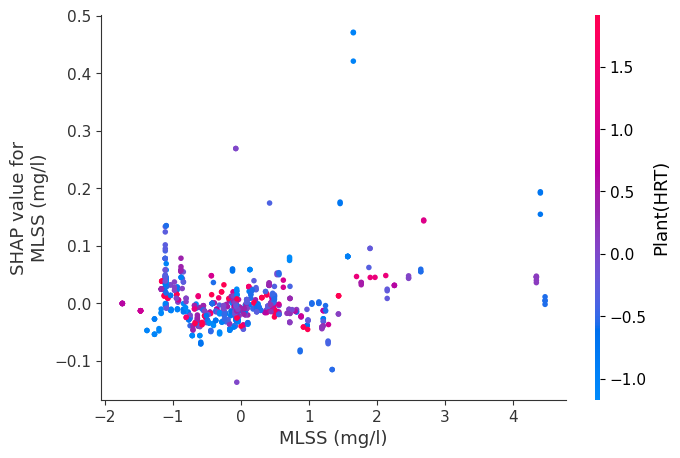

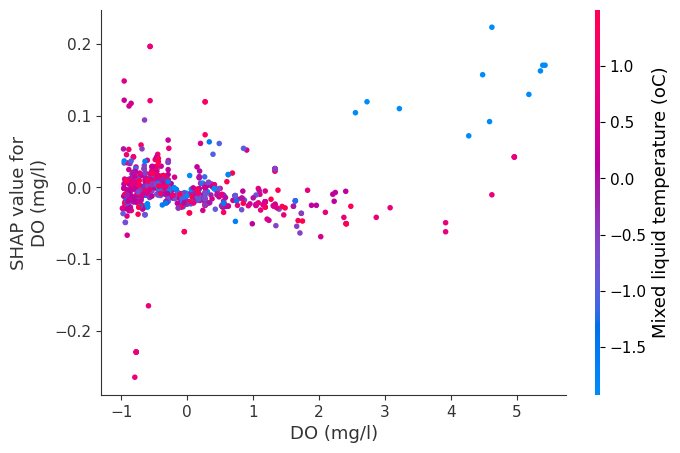

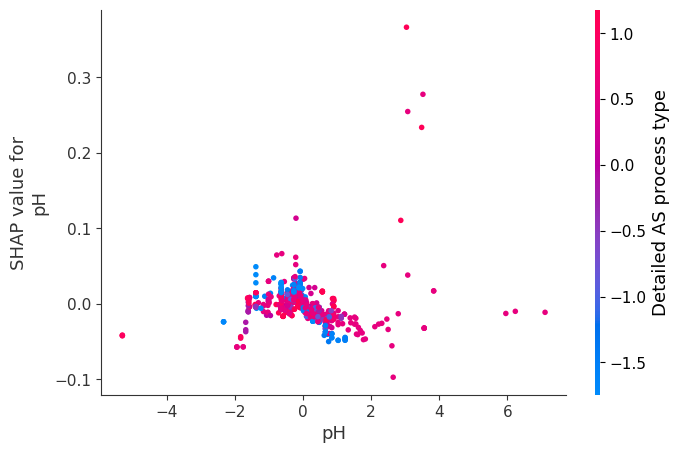

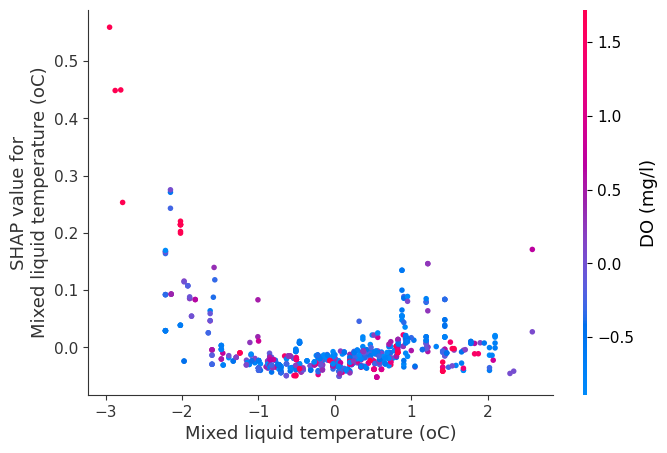


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,4.441209,0.941650,1.326085,1.436945,LinearRegression()
1,Stochastic Gradient Descent Regressor,4.290072,0.936970,1.327133,1.554356,SGDRegressor()
2,Elastic Net Regressor,-0.142868,0.961070,1.357519,-2.263580,ElasticNet()
3,Bayesian Ridge Regressor,5.204486,0.935736,1.320778,2.583899,BayesianRidge()
4,Support Vector Regressor,35.715830,0.622638,1.087647,35.347357,SVR()
5,K-Neighbors Regressor,42.769224,0.650335,1.026244,30.698776,KNeighborsRegressor()
6,Decision Trees Regressor,-53.678354,0.619828,1.681676,52.912374,DecisionTreeRegressor()
7,Random Forest Regressor,33.464665,0.546266,1.106527,66.288835,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,35.072188,0.600993,1.093078,59.443711,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,16.715749,1.073548,1.237991,8.389479,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Random_Forest_Regressor_1691715317.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Random_Forest_Regressor_Scaler_1691715317.pkl 

Time Elapsed :  23.32 seconds 



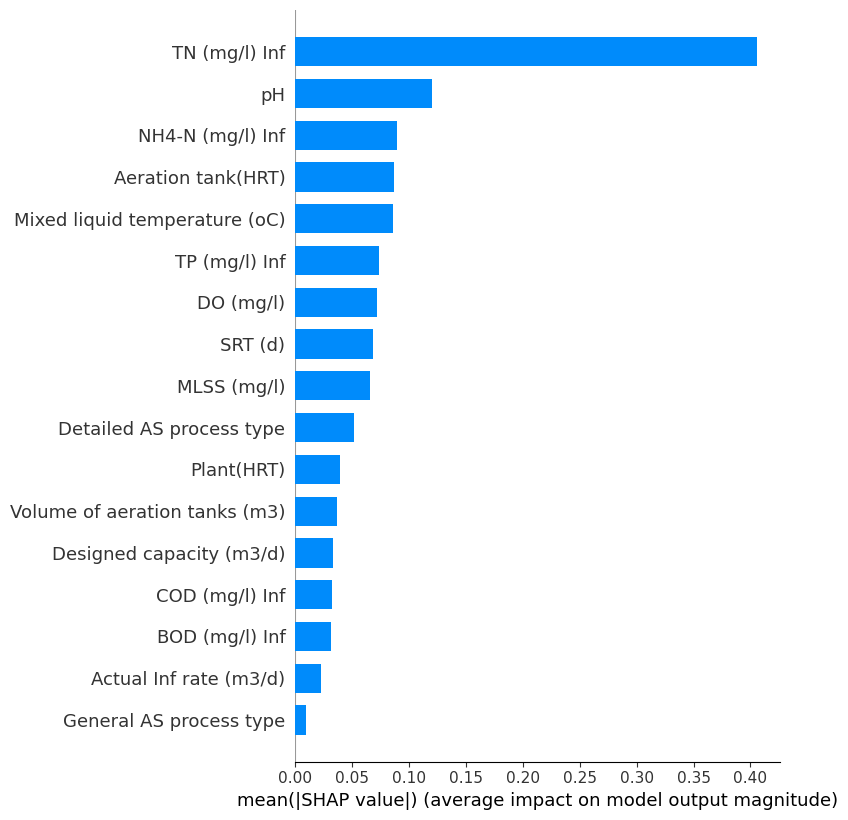

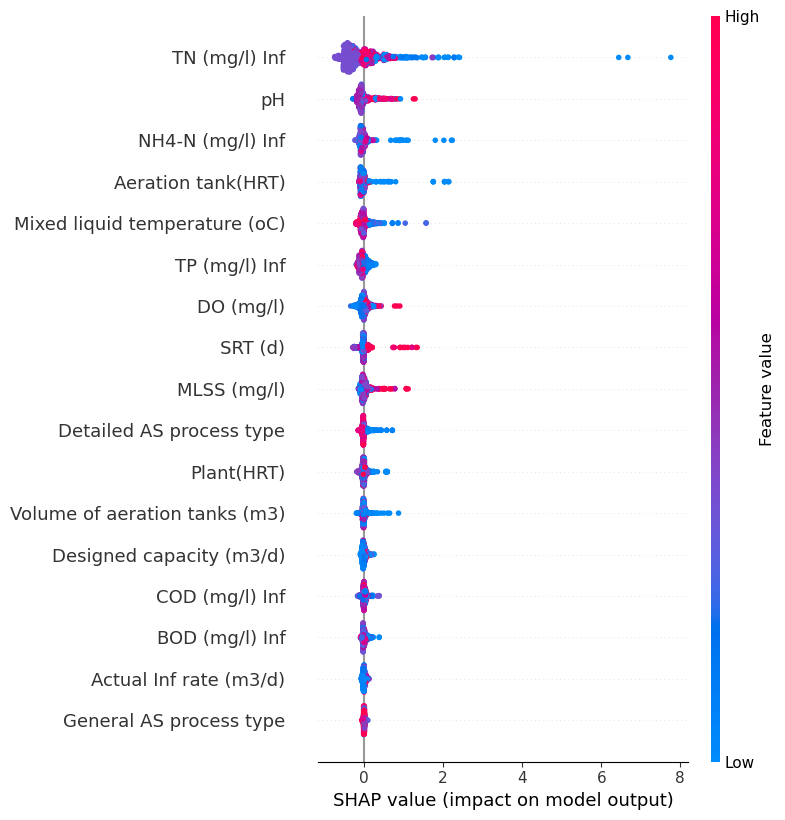

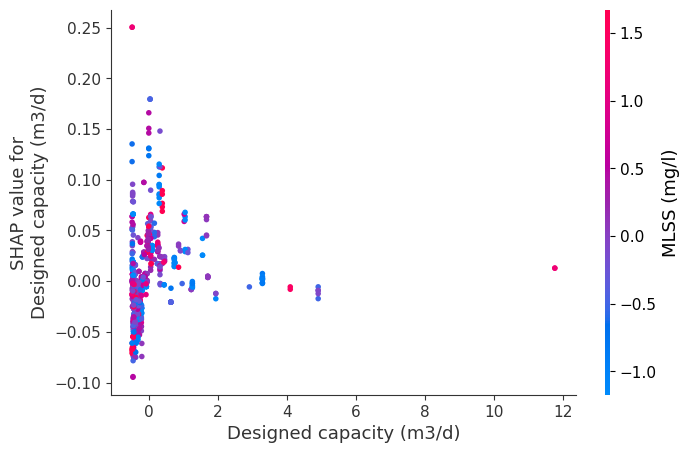

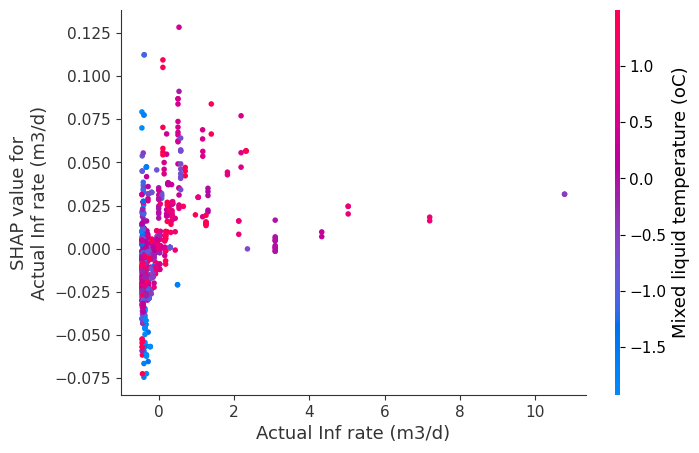

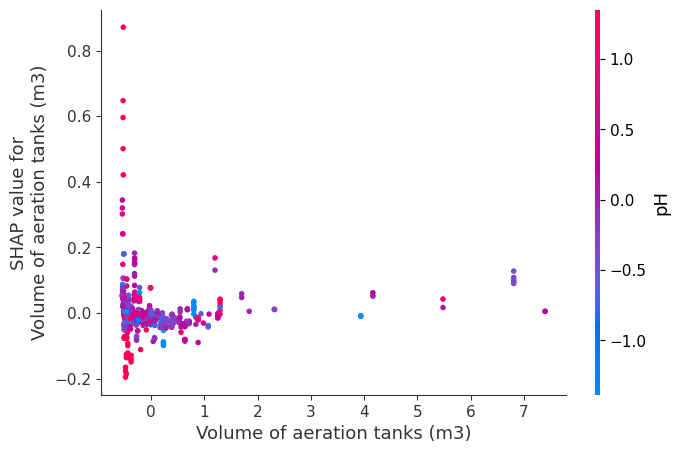

...

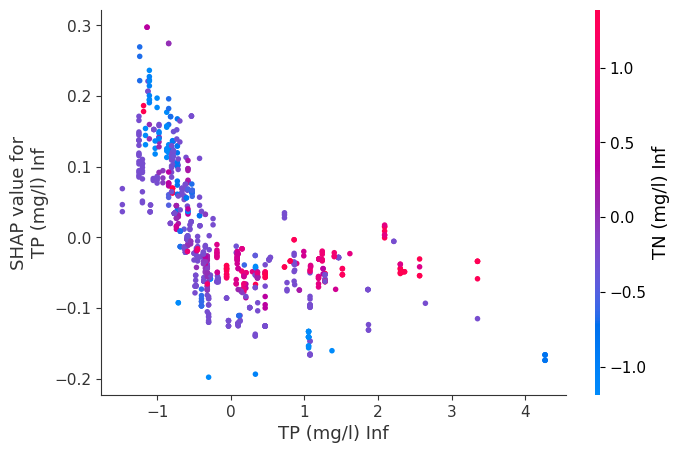

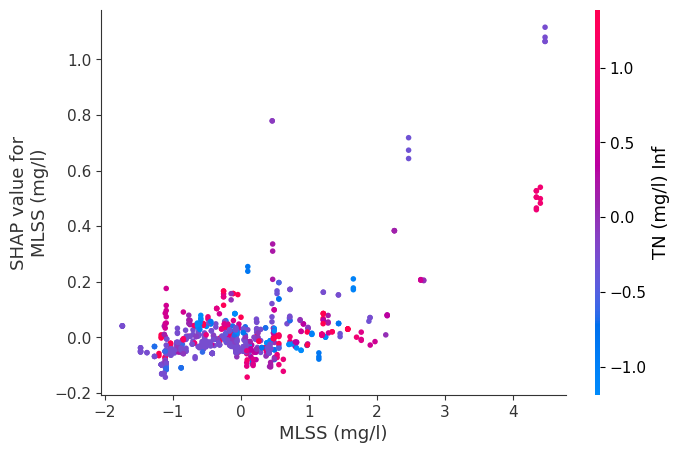

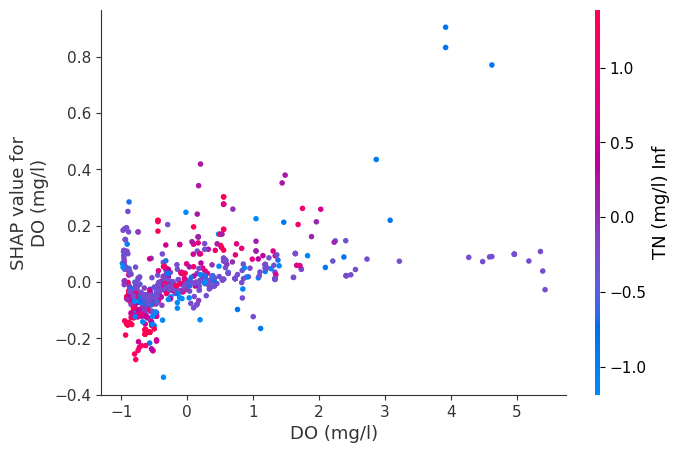

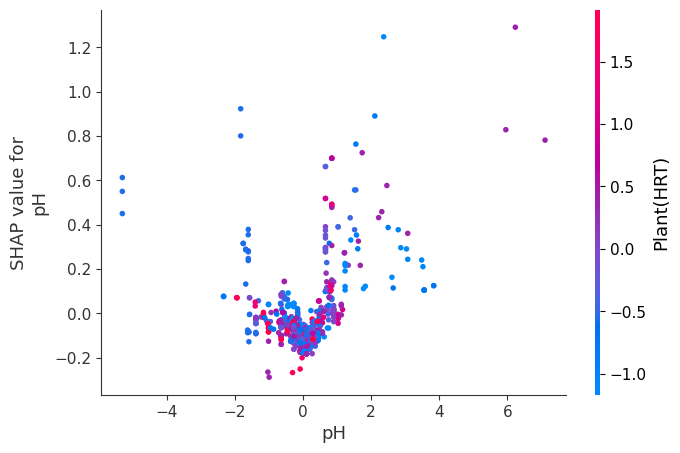

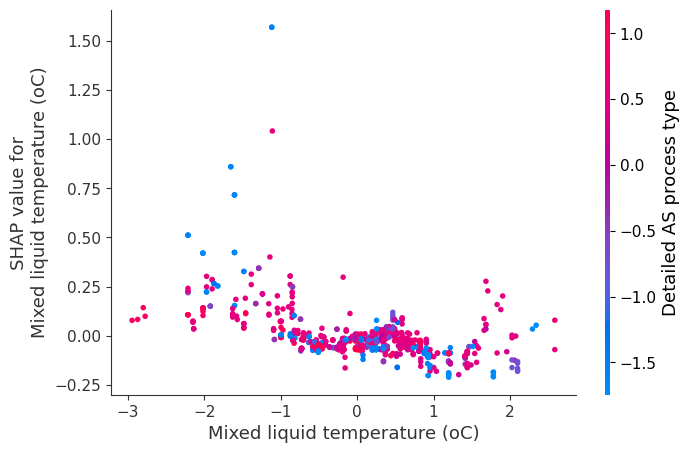


          
██████         ███     ██        ██ ████ ██████                ██████ █████   ████ ██████
██        ██ ██      ██  ██      ██    ██   ██        ██            ██         ██      █   ██   ██        
██        ██ ███████   ██    ██     ██   ██        ██  ████  ██████ █████     ██   ██        
██        ██ ██      ██    ██  ██      ██   ██        ██            ██         ██  █       ██   ██        
██████     ██      ██      ███      ████ ██████                ██████ ██    ██ ████ ██████

 

Start [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training [*]

Training Done [ ✓ ]

Results Below



,Name,R2 Score,Mean Absolute Error,Root Mean Squared Error,KFold Accuracy,Model
0,Linear Regression,13.485128,0.657998,1.300998,-214.868349,LinearRegression()
1,Stochastic Gradient Descent Regressor,10.480213,0.684817,1.323399,-211.242046,SGDRegressor()
2,Elastic Net Regressor,9.991674,0.447159,1.327005,-38.545488,ElasticNet()
3,Bayesian Ridge Regressor,15.342891,0.618630,1.286953,-173.276774,BayesianRidge()
4,Support Vector Regressor,19.883812,0.233619,1.251962,38.147927,SVR()
5,K-Neighbors Regressor,29.637441,0.295372,1.173281,25.331750,KNeighborsRegressor()
6,Decision Trees Regressor,-16.644960,0.336133,1.510651,31.626058,DecisionTreeRegressor()
7,Random Forest Regressor,17.961532,0.357390,1.266893,24.669168,"(DecisionTreeRegressor(max_features='auto', ra..."
8,Gradient Boost Regressor,7.557217,0.354342,1.344831,-50.616862,([DecisionTreeRegressor(criterion='friedman_ms...
9,AdaBoost Regressor,-19.621834,0.475693,1.529806,20.318329,"(DecisionTreeRegressor(max_depth=3, random_sta..."



Completed Run [ ✓ ]

Saved Best Model to lucifer_ml_info/best/regression/models/Support_Vector_Regressor_1691715348.pkl and its scaler to lucifer_ml_info/best/regression/scalers/Support_Vector_Regressor_Scaler_1691715348.pkl 

Time Elapsed :  20.56 seconds 



InvalidModelError: Model type not yet supported by TreeExplainer: <class 'sklearn.svm._classes.SVR'>

In [34]:
# Assuming you have a list of all the bacteria labels in a variable called 'all_bacteria_labels'
all_bacteria_labels = ['Gammaproteobacteria', 'Bacteroidia','Unclassified', 'Alphaproteobacteria', 'Others',
                       'Anaerolineae', 'Parcubacteria', 'Polyangia', 'Planctomycetes', 'Verrucomicrobiae', 'Bdellovibrionia',
                       'Chlamydiae', 'Oligoflexia', 'Phycisphaerae', 'Gracilibacteria', 'Actinobacteria', 'Bacilli',
                       'Microgenomatia', 'Babeliae', 'ABY1', 'Saccharimonadia', 'Acidimicrobiia', 'Omnitrophia', 'Cyanobacteriia',
                       'Acidobacteriae', 'Myxococcia', 'Nanoarchaeia', 'Thermoleophilia', 'Blastocatellia', 'OM190', 'Spirochaetia',
                       'Nitrospiria', 'Chloroflexia', 'Kiritimatiellae', 'Ignavibacteria', 'Desulfuromonadia', 'Campylobacteria',
                       'Gemmatimonadetes', 'Vicinamibacteria', 'Fimbriimonadia', 'Vampirivibrionia', 'Desulfovibrionia',
                       'Negativicutes', 'Holophagae', 'Leptospirae', 'metagenome', 'Kapabacteria', 'Lineage IIb', 'Desulfobacteria',
                       'Hydrogenedentia']

# Create an empty dictionary to store the fitted regressor models
fitted_regressors = {}

# Loop through all bacteria labels and fit the models
for bacteria_label in all_bacteria_labels:
    regressor = Regression(predictor=['all'], exclude_models=['ann', 'krr'])
    regressor.fit(features, df[bacteria_label])
    fitted_regressors[bacteria_label] = regressor

    # Set regressor and original_predictor attributes for each regressor
    fitted_regressors[bacteria_label].regressor = fitted_regressors[bacteria_label].best_regressor.model
    fitted_regressors[bacteria_label].original_predictor = 'rfr'

    fitted_regressors[bacteria_label].imp_features(extensive=True)


    

In [ ]:

# Create a list to store the figures
all_figures = []

# Loop through all bacteria labels and create scatter plots
for bacteria_label in all_bacteria_labels:
    regressor = fitted_regressors[bacteria_label]
    title = f'Actual vs Predicted Values for {bacteria_label} Percentage'
    fig = px.scatter(x=regressor.y_val, y=regressor.y_pred, opacity=0.65,
                     labels={'x': 'Actual', 'y': 'Predicted'},
                     marginal_x='histogram', marginal_y='histogram',
                     trendline='ols', trendline_color_override='darkblue',
                     template='plotly_dark', title=title)
    all_figures.append(fig)

# Show all the figures
for fig in all_figures:
    fig.show()

In [36]:
operational_keywords = ['Designed capacity (m3/d)',
       'Volume of aeration tanks (m3)', 'Plant(HRT)', 'Aeration tank(HRT)',
       'SRT (d)', 'General AS process type', 'Detailed AS process type', 'Contained in Inf? (Industry wastewater source)',
       'Percentage of Industry wastewater source', 'MLSS (mg/l)', 'DO (mg/l)', 'pH', 'Mixed liquid temperature (oC)']

operational_keywords = np.array(operational_keywords)

Chemical_keywords = ['BOD (mg/l) Inf', 'COD (mg/l) Inf', 'NH4-N (mg/l) Inf', 'TN (mg/l) Inf',
       'TP (mg/l) Inf']

Chemical_keywords = np.array(Chemical_keywords)


cate = [operational_keywords,Chemical_keywords]

In [37]:
factor_types = [ 'Operational',  'Chemical']
factor_keywords = [ operational_keywords, Chemical_keywords]

# Define the number of features to show for biological factors
num_features_to_show = 20

# Iterate through each factor type and plot the corresponding feature importance
for factor_type, keywords in zip(factor_types, factor_keywords):
    indices = [np.where(features.columns[sorted_idx] == col)[0][0] for col in keywords]
    indices = np.sort(indices)

    perm_sorted = perm_importance_mean[indices]
    perm_sorted = np.sort(perm_sorted)

    features_columns = features.columns[sorted_idx]

    if factor_type == 'Biological':
        plt.barh(
            features_columns[indices][-num_features_to_show:], perm_sorted[-num_features_to_show:]
        )
    else:
        plt.barh(
            features_columns[indices], perm_sorted
        )

    plt.xlabel(f"Feature Importance: {factor_type} Factors")
    plt.title(f"Top {num_features_to_show if factor_type == 'Biological' else 'All'} {factor_type} Factors")
    plt.show()

NameError: name 'sorted_idx' is not defined